# - The project :: Income-Person-Prediction-Project
*****************************************************************
<img src="images/person.jpg" />


* Table of Contetnt ::
************************************************
<ul>
<li><a href="#Intro">Introduction</a></li>
<li><a href="#Wrangling">Exploratory Data Analysis (EDA)</a></li>
<li><a href="#visualize">Data_Visualization_Process</a></li>
<li><a href="#ETl">ETl_Process</a></li>
<li><a href="#Prepration">Data_Prepration</a></li>
<li><a href="#Model">Bulid_ML_Model</a></li>
<li><a href="#Evaluation">Evaluate_Model</a></li>
<li><a href="#Save">Save_Model</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

<img src="images/project.jpg" />


* Domain-Knowledge ::
    * Income ::  It is money or the equivalent value that an individual or business receives, usually in exchange for providing a good or service or through investing capital.
    * Income-Takeaway ::
        * Income is money what an individual or business receives in exchange for providing labor, producing a good or service, or through investing capital.
        * Individuals most often earn income through wages or salary.
        * Businesses earn income from selling goods or services above their cost of production.
        * Tax authorities treat income earned through various means differently.


        
<img src="images/bahavior.jpg" />

    


# overview about How ML Solve That Problem of classifier :: 
***********************************
        
<img src="images/Process.png" />

* Importing requried liberaries and Frameworks  ::

In [1]:
# Importing Liberaries and Framworks ::
import numpy     as np      # Apply Linear_Algebra operations and deal with arrays.
import pandas    as pd      # For Loading diff formats of data and Apply Wrangling and Mainpulating on data
import seaborn   as sns     # For Visualizing data
import warnings  as w       # For Ignoring any Warning
import missingno as mno     # Presnt Precentage of Nan Values
import datasist  as ds      # For Apply EDA and Visualization Using Simple Implementation
import matplotlib.pyplot as plt # For Set Plots , Charts and Maps Labels and Title  
import pandas_profiling  as pp  # To get describtion file of data


* Set some instructions

In [2]:
# To Make Matplotlib apply on any Version
%matplotlib inline      
# To ignore any Warning notification.
w.filterwarnings("ignore") 
# To Set Figsize of Plots , Charts and Maps
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=3.5)

In [3]:
# Loading dataset ::
df = pd.read_csv("adult.csv")
df

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,160323,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,18,?,103497,Some-college,10,Never-married,?,Own-child,White,Female,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
48838,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
48839,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
48840,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


* from thae result above we can see that ::
*********************************************************
* We have 48842 record of data.
* we have 15 features related Income.
* Our-Target income that we will rename that columns into Income.

*******************************************************
# Features of Income data :
*******************************************************

* Categorical Attributes :::
************************************

* Workclass: (categorical) Private, Self-emp-not-inc, Self-emp-inc, Federal-gov, Local-gov, State-gov, Without-pay, Never-worked.
    * Individual work category
* Education: (categorical) Bachelors, Some-college, 11th, HS-grad, Prof-school, Assoc-acdm, Assoc-voc, 9th, 7th-8th, 12th, Masters, 1st-4th, 10th, Doctorate, 5th-6th, Preschool.
    * Individual's highest education degree
* Marital-status: (categorical) Married-civ-spouse, Divorced, Never-married, Separated, Widowed, Married-spouse-absent, Married-AF-spouse.
    * Individual marital status
* Occupation: (categorical) Tech-support, Craft-repair, Other-service, Sales, Exec-managerial, Prof-specialty, Handlers-cleaners, Machine-op-inspct, Adm-clerical, Farming-fishing, Transport-moving, Priv-house-serv, Protective-serv, Armed-Forces.
    * Individual's occupation
* Relationship: (categorical) Wife, Own-child, Husband, Not-in-family, Other-relative, Unmarried.
    * Individual's relation in a family
* Race: (categorical) White, Asian-Pac-Islander, Amer-Indian-Eskimo, Other, Black.
Race of Individual
* Sex: (categorical) Female, Male.
* Native-country: (categorical) United-States, Cambodia, England, Puerto-Rico, Canada, Germany, Outlying-US(Guam-USVI-etc), India, Japan, Greece, South, China, Cuba, Iran, Honduras, Philippines, Italy, Poland, Jamaica, Vietnam, Mexico, Portugal, Ireland, France, Dominican-Republic, Laos, Ecuador, Taiwan, Haiti, Columbia, Hungary, Guatemala, Nicaragua, Scotland, Thailand, Yugoslavia, El-Salvador, Trinadad&Tobago, Peru, Hong, Holand-Netherlands.
    * Individual's native country
  
*******************************
    
* Continuous Attributes ::
*************************************
   * age: continuous.
        * Age of an individual
   * Education-num: number of education year, continuous.
        * Individual's year of receiving education
   * fnlwgt: final weight, continuous.
        * The weights on the CPS files are controlled to independent estimates of the civilian noninstitutional population of the US. These are prepared monthly for us by Population Division here at the Census Bureau.
   * capital-gain: continuous.
   * capital-loss: continuous.
   * hours-per-week: continuous.
        *Individual's working hour per week

<p id="Wrangling">Exploratory data analysis</p>

* *EDA Task* ::
*******************************
 *  It one of the most important phase of data scientist life cycle which we apply some statistical oprations toidentify the Behaviour of data  to extract meaningful knowledge , insights and vesion from that data to help steckholders to make more efficient decision which improve and enhance our Buesines.

* Statistical analysis Process ::

In [4]:
df.columns

Index(['age', 'workclass', 'fnlwgt', 'education', 'educational-num',
       'marital-status', 'occupation', 'relationship', 'race', 'gender',
       'capital-gain', 'capital-loss', 'hours-per-week', 'native-country',
       'income'],
      dtype='object')

In [5]:
df.dtypes

age                 int64
workclass          object
fnlwgt              int64
education          object
educational-num     int64
marital-status     object
occupation         object
relationship       object
race               object
gender             object
capital-gain        int64
capital-loss        int64
hours-per-week      int64
native-country     object
income             object
dtype: object

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48842 entries, 0 to 48841
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   age              48842 non-null  int64 
 1   workclass        48842 non-null  object
 2   fnlwgt           48842 non-null  int64 
 3   education        48842 non-null  object
 4   educational-num  48842 non-null  int64 
 5   marital-status   48842 non-null  object
 6   occupation       48842 non-null  object
 7   relationship     48842 non-null  object
 8   race             48842 non-null  object
 9   gender           48842 non-null  object
 10  capital-gain     48842 non-null  int64 
 11  capital-loss     48842 non-null  int64 
 12  hours-per-week   48842 non-null  int64 
 13  native-country   48842 non-null  object
 14  income           48842 non-null  object
dtypes: int64(6), object(9)
memory usage: 5.6+ MB


age                0
workclass          0
fnlwgt             0
education          0
educational-num    0
marital-status     0
occupation         0
relationship       0
race               0
gender             0
capital-gain       0
capital-loss       0
hours-per-week     0
native-country     0
income             0
dtype: int64

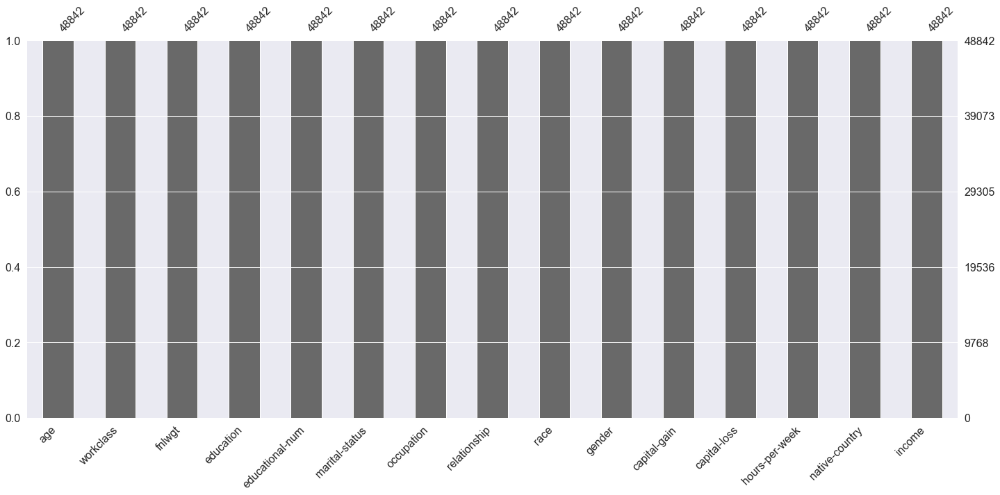

In [7]:
# Investigate Data not include null values ::
# Let's take a look at the presence of missing values, so as not to face unpleasant surprises in the future.


mno.bar(df)
df.isna().sum()

In [8]:
df.isnull().sum()

age                0
workclass          0
fnlwgt             0
education          0
educational-num    0
marital-status     0
occupation         0
relationship       0
race               0
gender             0
capital-gain       0
capital-loss       0
hours-per-week     0
native-country     0
income             0
dtype: int64

In [9]:
# identify the unique data values and its values count ::
for col in df.columns :
    print(f"The Col :: ({col})\n\nThe Col _ ({col}) _Unique_values :: {df[col].unique()}\n\n\
The Col _ ({col})_Value_counts :: \n\n{df[col].value_counts()}\n\n-----------\n-----------\n")

The Col :: (age)

The Col _ (age) _Unique_values :: [25 38 28 44 18 34 29 63 24 55 65 36 26 58 48 43 20 37 40 72 45 22 23 54
 32 46 56 17 39 52 21 42 33 30 47 41 19 69 50 31 59 49 51 27 57 61 64 79
 73 53 77 80 62 35 68 66 75 60 67 71 70 90 81 74 78 82 83 85 76 84 89 88
 87 86]

The Col _ (age)_Value_counts :: 

36    1348
35    1337
33    1335
23    1329
31    1325
      ... 
88       6
85       5
87       3
89       2
86       1
Name: age, Length: 74, dtype: int64

-----------
-----------

The Col :: (workclass)

The Col _ (workclass) _Unique_values :: ['Private' 'Local-gov' '?' 'Self-emp-not-inc' 'Federal-gov' 'State-gov'
 'Self-emp-inc' 'Without-pay' 'Never-worked']

The Col _ (workclass)_Value_counts :: 

Private             33906
Self-emp-not-inc     3862
Local-gov            3136
?                    2799
State-gov            1981
Self-emp-inc         1695
Federal-gov          1432
Without-pay            21
Never-worked           10
Name: workclass, dtype: int64

-----------
---

* From The result above we can see some observations ::
    * In *workclass* There are (?) 2799 that refer to missing data.
    * In *occupation* There are (?) 2809 that refer to missing data.
    * In *native-country* There are (?) 857 that refer to missing data.
 * Based on understanding the domain and objects of Business we can identify the other labels of Missing data.

In [10]:

# Loading dataset ::
df = pd.read_csv("adult.csv" , na_values=["?"])
df

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,160323,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,18,NaN,103497,Some-college,10,Never-married,NaN,Own-child,White,Female,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
48838,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
48839,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
48840,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


* Statistical analysis Process ::

In [11]:
df.columns

Index(['age', 'workclass', 'fnlwgt', 'education', 'educational-num',
       'marital-status', 'occupation', 'relationship', 'race', 'gender',
       'capital-gain', 'capital-loss', 'hours-per-week', 'native-country',
       'income'],
      dtype='object')

In [12]:
df.dtypes

age                 int64
workclass          object
fnlwgt              int64
education          object
educational-num     int64
marital-status     object
occupation         object
relationship       object
race               object
gender             object
capital-gain        int64
capital-loss        int64
hours-per-week      int64
native-country     object
income             object
dtype: object

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48842 entries, 0 to 48841
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   age              48842 non-null  int64 
 1   workclass        46043 non-null  object
 2   fnlwgt           48842 non-null  int64 
 3   education        48842 non-null  object
 4   educational-num  48842 non-null  int64 
 5   marital-status   48842 non-null  object
 6   occupation       46033 non-null  object
 7   relationship     48842 non-null  object
 8   race             48842 non-null  object
 9   gender           48842 non-null  object
 10  capital-gain     48842 non-null  int64 
 11  capital-loss     48842 non-null  int64 
 12  hours-per-week   48842 non-null  int64 
 13  native-country   47985 non-null  object
 14  income           48842 non-null  object
dtypes: int64(6), object(9)
memory usage: 5.6+ MB


age                   0
workclass          2799
fnlwgt                0
education             0
educational-num       0
marital-status        0
occupation         2809
relationship          0
race                  0
gender                0
capital-gain          0
capital-loss          0
hours-per-week        0
native-country      857
income                0
dtype: int64

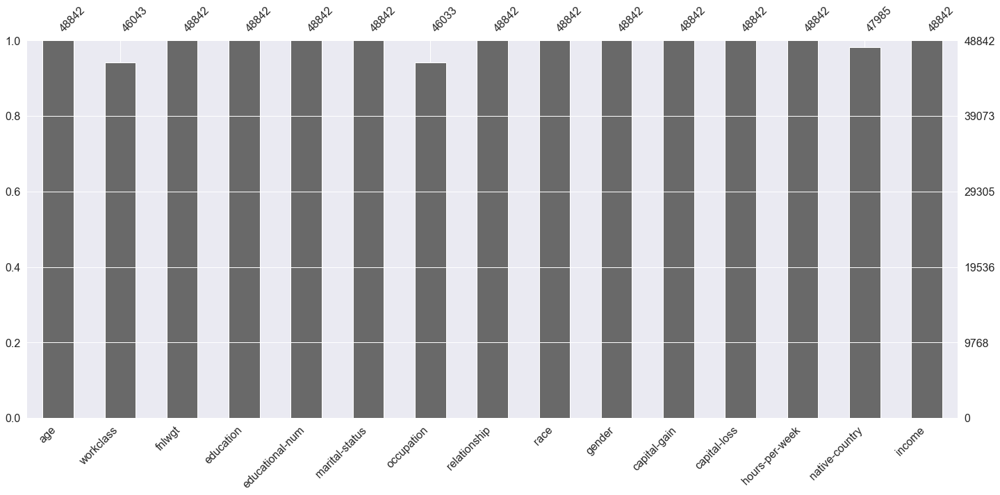

In [14]:
# Investigate Data not include null values ::
# Let's take a look at the presence of missing values, so as not to face unpleasant surprises in the future.


mno.bar(df)
df.isna().sum()

In [15]:
df.isnull().sum()

age                   0
workclass          2799
fnlwgt                0
education             0
educational-num       0
marital-status        0
occupation         2809
relationship          0
race                  0
gender                0
capital-gain          0
capital-loss          0
hours-per-week        0
native-country      857
income                0
dtype: int64

In [16]:
# identify the unique data values and its values count ::
for col in df.columns :
    print(f"The Col :: ({col})\n\nThe Col _ ({col}) _Unique_values :: {df[col].unique()}\n\n\
The Col _ ({col})_Value_counts :: \n\n{df[col].value_counts()}\n\n-----------\n-----------\n")

The Col :: (age)

The Col _ (age) _Unique_values :: [25 38 28 44 18 34 29 63 24 55 65 36 26 58 48 43 20 37 40 72 45 22 23 54
 32 46 56 17 39 52 21 42 33 30 47 41 19 69 50 31 59 49 51 27 57 61 64 79
 73 53 77 80 62 35 68 66 75 60 67 71 70 90 81 74 78 82 83 85 76 84 89 88
 87 86]

The Col _ (age)_Value_counts :: 

36    1348
35    1337
33    1335
23    1329
31    1325
      ... 
88       6
85       5
87       3
89       2
86       1
Name: age, Length: 74, dtype: int64

-----------
-----------

The Col :: (workclass)

The Col _ (workclass) _Unique_values :: ['Private' 'Local-gov' nan 'Self-emp-not-inc' 'Federal-gov' 'State-gov'
 'Self-emp-inc' 'Without-pay' 'Never-worked']

The Col _ (workclass)_Value_counts :: 

Private             33906
Self-emp-not-inc     3862
Local-gov            3136
State-gov            1981
Self-emp-inc         1695
Federal-gov          1432
Without-pay            21
Never-worked           10
Name: workclass, dtype: int64

-----------
-----------

The Col :: (fnlw

In [17]:
# Present the Statistical Analysis describtion of Numerical_data ::
df.describe(include=["number"])

,age,fnlwgt,educational-num,capital-gain,capital-loss,hours-per-week
count,48842.000000,4.884200e+04,48842.000000,48842.000000,48842.000000,48842.000000
mean,38.643585,1.896641e+05,10.078089,1079.067626,87.502314,40.422382
std,13.710510,1.056040e+05,2.570973,7452.019058,403.004552,12.391444
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.175505e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.781445e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.376420e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.490400e+06,16.000000,99999.000000,4356.000000,99.000000


In [18]:
# present the Statistical Analysis description of Categorical_data ::
df.describe(include="object")

,workclass,education,marital-status,occupation,relationship,race,gender,native-country,income
count,46043,48842,48842,46033,48842,48842,48842,47985,48842
unique,8,16,7,14,6,5,2,41,2
top,Private,HS-grad,Married-civ-spouse,Prof-specialty,Husband,White,Male,United-States,<=50K
freq,33906,15784,22379,6172,19716,41762,32650,43832,37155


In [19]:
# Present nuniques :: To identifing the duplicaties data
df.nunique()

age                   74
workclass              8
fnlwgt             28523
education             16
educational-num       16
marital-status         7
occupation            14
relationship           6
race                   5
gender                 2
capital-gain         123
capital-loss          99
hours-per-week        96
native-country        41
income                 2
dtype: int64

In [20]:
# check data include duplicates record or not
df.duplicated().sum()

52

In [21]:
# Droping All repeat or Redendant data.
df.drop_duplicates(inplace=True)

In [22]:
# check data include duplicates record or not
df.duplicated().sum()

0

In [23]:
# Checking dtypes of dataset.
df.dtypes

age                 int64
workclass          object
fnlwgt              int64
education          object
educational-num     int64
marital-status     object
occupation         object
relationship       object
race               object
gender             object
capital-gain        int64
capital-loss        int64
hours-per-week      int64
native-country     object
income             object
dtype: object

* Wrangling and Mainplluting data.

In [24]:
# Get The Record Of the Clients who max age ::
df[df["age"] == df["age"].max()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
899,90,Private,149069,Assoc-acdm,12,Married-civ-spouse,Sales,Husband,White,Male,0,1825,50,United-States,>50K
3496,90,Self-emp-not-inc,83601,Prof-school,15,Widowed,Prof-specialty,Not-in-family,White,Male,1086,0,60,United-States,<=50K
6976,90,Private,250832,HS-grad,9,Married-civ-spouse,Transport-moving,Husband,White,Male,2414,0,40,United-States,<=50K
7414,90,Private,227796,Assoc-acdm,12,Never-married,Exec-managerial,Not-in-family,White,Male,6097,0,45,United-States,>50K
7419,90,Self-emp-not-inc,122348,Prof-school,15,Married-civ-spouse,Prof-specialty,Husband,White,Male,20051,0,45,United-States,>50K
8427,90,Federal-gov,311184,Masters,14,Divorced,Prof-specialty,Not-in-family,White,Male,0,0,99,United-States,<=50K
8982,90,Private,225063,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,Asian-Pac-Islander,Male,0,0,40,South,<=50K
10735,90,Local-gov,188242,HS-grad,9,Never-married,Craft-repair,Own-child,White,Male,11678,0,40,United-States,>50K
11871,90,NaN,50746,10th,6,Divorced,NaN,Not-in-family,White,Female,0,0,7,United-States,<=50K
12446,90,Private,347074,Some-college,10,Never-married,Adm-clerical,Own-child,White,Female,0,1944,12,United-States,<=50K


In [25]:
# Get The Record of the Min age ::
df[df["age"] == df["age"].min()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
38,17,Private,269430,10th,6,Never-married,Machine-op-inspct,Not-in-family,White,Male,0,0,40,United-States,<=50K
75,17,NaN,165361,10th,6,Never-married,NaN,Own-child,White,Male,0,0,40,United-States,<=50K
402,17,Private,40299,11th,7,Never-married,Sales,Own-child,White,Female,0,0,25,United-States,<=50K
675,17,Private,190941,10th,6,Never-married,Sales,Own-child,White,Female,0,0,20,United-States,<=50K
765,17,NaN,143331,11th,7,Never-married,NaN,Own-child,White,Male,0,0,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48053,17,NaN,256173,10th,6,Never-married,NaN,Own-child,White,Female,0,0,15,United-States,<=50K
48145,17,Private,214787,12th,8,Never-married,Adm-clerical,Own-child,White,Female,0,0,25,United-States,<=50K
48240,17,Private,24090,HS-grad,9,Never-married,Exec-managerial,Own-child,White,Female,0,0,35,United-States,<=50K
48563,17,Private,311907,11th,7,Never-married,Other-service,Own-child,White,Male,0,0,25,United-States,<=50K


In [26]:
# Get The Record Of the Clients who max educational-num ::
df[df["educational-num"] == df["educational-num"].max()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
19,40,Private,85019,Doctorate,16,Married-civ-spouse,Prof-specialty,Husband,Asian-Pac-Islander,Male,0,0,45,NaN,>50K
126,48,Federal-gov,42972,Doctorate,16,Married-civ-spouse,Prof-specialty,Wife,White,Female,0,0,40,United-States,>50K
133,42,Self-emp-inc,100793,Doctorate,16,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,41,United-States,>50K
166,58,Self-emp-not-inc,159021,Doctorate,16,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,16,United-States,>50K
329,64,Self-emp-not-inc,71807,Doctorate,16,Married-civ-spouse,Prof-specialty,Husband,White,Male,15024,0,50,NaN,>50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48710,51,Local-gov,203334,Doctorate,16,Divorced,Exec-managerial,Not-in-family,White,Female,0,0,45,United-States,>50K
48750,58,Self-emp-inc,181974,Doctorate,16,Never-married,Prof-specialty,Not-in-family,White,Female,0,0,99,NaN,<=50K
48751,50,Private,485710,Doctorate,16,Divorced,Prof-specialty,Not-in-family,White,Female,0,0,50,United-States,<=50K
48813,34,Private,204461,Doctorate,16,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,60,United-States,>50K


In [27]:
# Get The Record of the Min educational-num ::
df[df["educational-num"] == df["educational-num"].min()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
779,64,Private,86837,Preschool,1,Married-civ-spouse,Handlers-cleaners,Husband,Asian-Pac-Islander,Male,0,0,40,Philippines,<=50K
818,21,Private,243368,Preschool,1,Never-married,Farming-fishing,Not-in-family,White,Male,0,0,25,Mexico,<=50K
1029,57,NaN,274680,Preschool,1,Separated,NaN,Not-in-family,White,Male,0,0,40,United-States,<=50K
1059,31,Private,25610,Preschool,1,Never-married,Handlers-cleaners,Not-in-family,Amer-Indian-Eskimo,Male,0,0,25,United-States,<=50K
1489,19,Private,277695,Preschool,1,Never-married,Farming-fishing,Not-in-family,White,Male,0,0,36,Mexico,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48079,31,State-gov,77634,Preschool,1,Never-married,Other-service,Not-in-family,White,Male,0,0,24,United-States,<=50K
48316,40,Private,566537,Preschool,1,Married-civ-spouse,Other-service,Husband,White,Male,0,1672,40,Mexico,<=50K
48505,40,Private,70645,Preschool,1,Never-married,Other-service,Not-in-family,White,Female,0,0,20,United-States,<=50K
48640,46,Private,139514,Preschool,1,Married-civ-spouse,Machine-op-inspct,Other-relative,Black,Male,0,0,75,Dominican-Republic,<=50K


In [28]:
# Get The Record Of the Clients who max capital-gain ::
df[df["capital-gain"] == df["capital-gain"].max()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
83,44,Self-emp-inc,223881,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,99999,0,50,NaN,>50K
346,39,Private,198654,HS-grad,9,Divorced,Exec-managerial,Unmarried,Black,Female,99999,0,40,United-States,>50K
357,50,Self-emp-not-inc,165001,Prof-school,15,Married-civ-spouse,Prof-specialty,Husband,White,Male,99999,0,80,United-States,>50K
418,54,Self-emp-inc,159219,Prof-school,15,Married-civ-spouse,Prof-specialty,Husband,White,Male,99999,0,40,United-States,>50K
692,41,Private,191547,Masters,14,Married-civ-spouse,Exec-managerial,Husband,White,Male,99999,0,55,United-States,>50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48109,47,Private,155664,Masters,14,Married-civ-spouse,Exec-managerial,Husband,White,Male,99999,0,55,United-States,>50K
48253,43,Self-emp-inc,62026,Prof-school,15,Married-civ-spouse,Exec-managerial,Husband,White,Male,99999,0,40,United-States,>50K
48371,66,Private,115498,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,99999,0,55,NaN,>50K
48519,47,Private,294913,Prof-school,15,Married-civ-spouse,Exec-managerial,Husband,White,Male,99999,0,40,United-States,>50K


In [29]:
# Get The Record of the Min capital-gain ::
df[df["capital-gain"] == df["capital-gain"].min()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
4,18,NaN,103497,Some-college,10,Never-married,NaN,Own-child,White,Female,0,0,30,United-States,<=50K
5,34,Private,198693,10th,6,Never-married,Other-service,Not-in-family,White,Male,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48836,22,Private,310152,Some-college,10,Never-married,Protective-serv,Not-in-family,White,Male,0,0,40,United-States,<=50K
48837,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
48838,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
48839,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K


In [30]:
# Get The Record Of the Clients who max capital-loss ::
df[df["capital-loss"] == df["capital-loss"].max()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
25244,90,NaN,77053,HS-grad,9,Widowed,NaN,Not-in-family,White,Female,0,4356,40,United-States,<=50K
31037,82,Private,132870,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
47062,66,NaN,186061,Some-college,10,Widowed,NaN,Unmarried,Black,Female,0,4356,40,United-States,<=50K


In [31]:
# Get The Record of the Min capital-loss ::
df[df["capital-loss"] == df["capital-loss"].min()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,160323,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,18,NaN,103497,Some-college,10,Never-married,NaN,Own-child,White,Female,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
48838,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
48839,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
48840,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


In [32]:
# Get The Record Of the Clients who max hours-per-week ::
df[df["hours-per-week"] == df["hours-per-week"].max()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
384,29,Private,211208,11th,7,Married-civ-spouse,Transport-moving,Husband,White,Male,0,0,99,United-States,>50K
901,37,Private,112158,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,7688,0,99,United-States,>50K
1121,31,Local-gov,378426,Prof-school,15,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,99,Columbia,<=50K
1156,48,NaN,117054,5th-6th,3,Divorced,NaN,Not-in-family,White,Male,0,0,99,United-States,<=50K
1649,52,Private,254680,HS-grad,9,Married-civ-spouse,Transport-moving,Husband,Black,Male,0,0,99,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47273,40,Self-emp-inc,104235,Masters,14,Never-married,Other-service,Own-child,White,Male,0,0,99,United-States,<=50K
47962,43,Private,266324,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,1902,99,United-States,>50K
47980,43,Self-emp-not-inc,163108,Some-college,10,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,99,United-States,<=50K
48750,58,Self-emp-inc,181974,Doctorate,16,Never-married,Prof-specialty,Not-in-family,White,Female,0,0,99,NaN,<=50K


In [33]:
# Get The Record of the Min hours-per-week ::
df[df["hours-per-week"] == df["hours-per-week"].min()]

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
870,73,Self-emp-not-inc,252431,Some-college,10,Married-civ-spouse,Prof-specialty,Wife,White,Female,0,0,1,United-States,<=50K
2655,54,NaN,186565,Masters,14,Divorced,NaN,Not-in-family,White,Male,0,0,1,United-States,<=50K
7078,22,Private,173004,HS-grad,9,Never-married,Machine-op-inspct,Other-relative,Black,Male,0,0,1,United-States,<=50K
9076,39,Private,465334,11th,7,Divorced,Farming-fishing,Unmarried,White,Male,0,0,1,United-States,<=50K
10447,29,Private,165737,Bachelors,13,Never-married,Prof-specialty,Not-in-family,Asian-Pac-Islander,Male,0,0,1,Japan,<=50K
11166,62,Private,312818,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,1902,1,United-States,>50K
11802,32,NaN,78374,Bachelors,13,Never-married,NaN,Not-in-family,Asian-Pac-Islander,Female,0,0,1,United-States,<=50K
16470,58,State-gov,109567,Doctorate,16,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,1,United-States,>50K
17317,66,Self-emp-inc,150726,9th,5,Married-civ-spouse,Exec-managerial,Husband,White,Male,1409,0,1,NaN,<=50K
17543,69,NaN,195779,Assoc-voc,11,Widowed,NaN,Not-in-family,White,Female,0,0,1,United-States,<=50K


In [34]:
# grouped data ased on workclass feature and get col describtion ::
df.groupby("workclass").describe().transpose()

workclass                Federal-gov     Local-gov   Never-worked  \
age             count    1432.000000  3.136000e+03      10.000000   
                mean       42.577514  4.167602e+01      19.900000   
                std        11.437656  1.245812e+01       3.984693   
                min        17.000000  1.700000e+01      17.000000   
                25%        34.000000  3.200000e+01      18.000000   
                50%        43.000000  4.100000e+01      18.000000   
                75%        51.000000  5.000000e+01      20.000000   
                max        90.000000  9.000000e+01      30.000000   
fnlwgt          count    1432.000000  3.136000e+03      10.000000   
                mean   183590.028631  1.901611e+05  215033.300000   
                std    119581.230679  9.987946e+04   96692.828204   
                min     19522.000000  1.487800e+04  131593.000000   
                25%     95774.500000  1.216940e+05  158575.250000   
                50%    172020.500000  1.820220e+05  182604.000000   
                75%    242404.500000  2.403945e+05  229543.750000   
                max    930948.000000  1.125613e+06  462294.000000   
educational-num count    1432.000000  3.136000e+03      10.000000   
                mean       10.937151  1.103221e+01       7.500000   
                std         2.155121  2.528167e+00       1.957890   
                min         2.000000  1.000000e+00       4.000000   
                25%         9.000000  9.000000e+00       6.250000   
                50%        10.000000  1.000000e+01       7.000000   
                75%        13.000000  1.300000e+01       9.000000   
                max        16.000000  1.600000e+01      10.000000   
capital-gain    count    1432.000000  3.136000e+03      10.000000   
                mean      923.287709  7.982286e+02       0.000000   
                std      4604.613777  5.172958e+03       0.000000   
                min         0.000000  0.000000e+00       0.000000   
                25%         0.000000  0.000000e+00       0.000000   
                50%         0.000000  0.000000e+00       0.000000   
                75%         0.000000  0.000000e+00       0.000000   
                max     99999.000000  9.999900e+04       0.000000   
capital-loss    count    1432.000000  3.136000e+03      10.000000   
                mean      108.884078  1.021240e+02       0.000000   
                std       443.466272  4.261317e+02       0.000000   
                min         0.000000  0.000000e+00       0.000000   
                25%         0.000000  0.000000e+00       0.000000   
                50%         0.000000  0.000000e+00       0.000000   
                75%         0.000000  0.000000e+00       0.000000   
                max      3683.000000  2.467000e+03       0.000000   
hours-per-week  count    1432.000000  3.136000e+03      10.000000   
                mean       41.513268  4.084726e+01      28.900000   
                std         8.927996  1.082551e+01      13.076272   
                min         4.000000  2.000000e+00       4.000000   
                25%        40.000000  4.000000e+01      22.500000   
                50%        40.000000  4.000000e+01      35.000000   
                75%        40.000000  4.400000e+01      38.750000   
                max        99.000000  9.900000e+01      40.000000   

workclass                   Private  Self-emp-inc  Self-emp-not-inc  \
age             count  3.386000e+04  1.694000e+03       3861.000000   
                mean   3.691184e+01  4.581582e+01         45.331520   
                std    1.290534e+01  1.264314e+01         13.508735   
                min    1.700000e+01  1.700000e+01         17.000000   
                25%    2.700000e+01  3.700000e+01         35.000000   
                50%    3.500000e+01  4.500000e+01         44.000000   
                75%    4.600000e+01  5.400000e+01         55.000000   
                max    9.000000e+01  8.500000e+01 

In [35]:
# grouped data ased on education feature and get col describtion ::
df.groupby("education").describe().transpose()

education                      10th          11th           12th  \
age             count  1.389000e+03  1.812000e+03     655.000000   
                mean   3.790281e+01  3.214183e+01      32.280916   
                std    1.690523e+01  1.524583e+01      14.692064   
                min    1.700000e+01  1.700000e+01      17.000000   
                25%    2.200000e+01  1.800000e+01      19.000000   
                50%    3.500000e+01  2.800000e+01      29.000000   
                75%    5.200000e+01  4.200000e+01      42.000000   
                max    9.000000e+01  9.000000e+01      81.000000   
fnlwgt          count  1.389000e+03  1.812000e+03     655.000000   
                mean   1.965326e+05  1.951023e+05  197330.580153   
                std    1.117815e+05  1.089246e+05  118689.023106   
                min    2.169800e+04  1.975200e+04   21175.000000   
                25%    1.261420e+05  1.206750e+05  113671.500000   
                50%    1.786780e+05  1.838695e+05  181284.000000   
                75%    2.451960e+05  2.441300e+05  252462.500000   
                max    1.210504e+06  1.047822e+06  917220.000000   
educational-num count  1.389000e+03  1.812000e+03     655.000000   
                mean   6.000000e+00  7.000000e+00       8.000000   
                std    0.000000e+00  0.000000e+00       0.000000   
                min    6.000000e+00  7.000000e+00       8.000000   
                25%    6.000000e+00  7.000000e+00       8.000000   
                50%    6.000000e+00  7.000000e+00       8.000000   
                75%    6.000000e+00  7.000000e+00       8.000000   
                max    6.000000e+00  7.000000e+00       8.000000   
capital-gain    count  1.389000e+03  1.812000e+03     655.000000   
                mean   3.230497e+02  2.037395e+02     209.216794   
                std    4.106378e+03  1.191286e+03    1385.923460   
                min    0.000000e+00  0.000000e+00       0.000000   
                25%    0.000000e+00  0.000000e+00       0.000000   
                50%    0.000000e+00  0.000000e+00       0.000000   
                75%    0.000000e+00  0.000000e+00       0.000000   
                max    9.999900e+04  1.502400e+04   18481.000000   
capital-loss    count  1.389000e+03  1.812000e+03     655.000000   
                mean   5.494312e+01  5.207781e+01      28.940458   
                std    3.264488e+02  3.087464e+02     222.959551   
                min    0.000000e+00  0.000000e+00       0.000000   
                25%    0.000000e+00  0.000000e+00       0.000000   
                50%    0.000000e+00  0.000000e+00       0.000000   
                75%    0.000000e+00  0.000000e+00       0.000000   
                max    3.770000e+03  2.824000e+03    2258.000000   
hours-per-week  count  1.389000e+03  1.812000e+03     655.000000   
                mean   3.698632e+01  3.395254e+01      35.436641   
                std    1.391801e+01  1.399680e+01      12.586042   
                min    1.000000e+00  1.000000e+00       4.000000   
                25%    3.000000e+01  2.000000e+01      27.500000   
                50%    4.000000e+01  4.000000e+01      40.000000   
                75%    4.000000e+01  4.000000e+01      40.000000   
                max    9.900000e+01  9.900000e+01      99.000000   

education                    1st-4th        5th-6th        7th-8th  \
age             count     245.000000     507.000000     954.000000   
                mean       46.816327      43.674556      49.526205   
                std        15.107095      15.501071      16.298560   
                min        19.000000      17.000000      17.000000   
                25%        35.000000      30.000000      36.000000   
                50%        46.000000      43.000000      51.000000   
                75%        58.000000      55.000000      62.000000   
                max        90.000000      84.000000      90.000000   
fnlwgt          count     245.000000 

In [36]:
# grouped data ased on marital-status feature and get col describtion ::
df.groupby("marital-status").describe().transpose()

marital-status             Divorced  Married-AF-spouse  Married-civ-spouse  \
age             count  6.630000e+03          37.000000        2.236600e+04   
                mean   4.316199e+01          31.945946        4.335451e+01   
                std    1.055464e+01          10.697731        1.207762e+01   
                min    1.800000e+01          19.000000        1.700000e+01   
                25%    3.500000e+01          26.000000        3.400000e+01   
                50%    4.200000e+01          30.000000        4.200000e+01   
                75%    5.000000e+01          34.000000        5.100000e+01   
                max    9.000000e+01          75.000000        9.000000e+01   
fnlwgt          count  6.630000e+03          37.000000        2.236600e+04   
                mean   1.847286e+05      184132.675676        1.868209e+05   
                std    1.045983e+05      135225.955123        1.037444e+05   
                min    1.376900e+04       19678.000000        1.349200e+04   
                25%    1.137328e+05       95423.000000        1.157750e+05   
                50%    1.749665e+05      162954.000000        1.759250e+05   
                75%    2.323010e+05      228306.000000        2.336352e+05   
                max    1.484705e+06      544091.000000        1.490400e+06   
educational-num count  6.630000e+03          37.000000        2.236600e+04   
                mean   1.005294e+01          10.432432        1.030359e+01   
                std    2.290832e+00           2.034979        2.724299e+00   
                min    1.000000e+00           6.000000        1.000000e+00   
                25%    9.000000e+00           9.000000        9.000000e+00   
                50%    1.000000e+01          10.000000        1.000000e+01   
                75%    1.100000e+01          12.000000        1.300000e+01   
                max    1.600000e+01          16.000000        1.600000e+01   
capital-gain    count  6.630000e+03          37.000000        2.236600e+04   
                mean   7.940347e+02        2971.621622        1.740712e+03   
                std    6.062501e+03       16442.973353        9.667521e+03   
                min    0.000000e+00           0.000000        0.000000e+00   
                25%    0.000000e+00           0.000000        0.000000e+00   
                50%    0.000000e+00           0.000000        0.000000e+00   
                75%    0.000000e+00           0.000000        0.000000e+00   
                max    9.999900e+04       99999.000000        9.999900e+04   
capital-loss    count  6.630000e+03          37.000000        2.236600e+04   
                mean   6.768492e+01          84.756757        1.206896e+02   
                std    3.576308e+02         359.985679        4.687036e+02   
                min    0.000000e+00           0.000000        0.000000e+00   
                25%    0.000000e+00           0.000000        0.000000e+00   
                50%    0.000000e+00           0.000000        0.000000e+00   
                75%    0.000000e+00           0.000000        0.000000e+00   
                max    3.900000e+03        1651.000000        2.603000e+03   
hours-per-week  count  6.630000e+03          37.000000        2.236600e+04   
                mean   4.111599e+01          39.810811        4.330833e+01   
                std    1.078469e+01          17.074734        1.203943e+01   
                min    1.000000e+00           3.000000        1.000000e+00   
                25%    4.000000e+01          35.000000        4.000000e+01   
                50%    4.000000e+01          40.000000        4.000000e+01   
                75%    4.500000e+01          42.000000        5.000000e+01   
                max    9.900000e+01          90.000000        9.900000e+01   

marital-status         Married-spouse-absent  Never-married     Separated  \
age             count           6.270000e+02   1.608200e+04  1.530000e+03   
                mean   

In [37]:
# grouped data ased on occupation feature and get col describtion ::
df.groupby("occupation").describe().transpose()

occupation             Adm-clerical   Armed-Forces  Craft-repair  \
age             count  5.606000e+03      15.000000  6.102000e+03   
                mean   3.720193e+01      31.466667  3.901393e+01   
                std    1.350976e+01       9.508392  1.157395e+01   
                min    1.700000e+01      23.000000  1.700000e+01   
                25%    2.600000e+01      24.000000  3.000000e+01   
                50%    3.500000e+01      29.000000  3.800000e+01   
                75%    4.600000e+01      36.500000  4.700000e+01   
                max    9.000000e+01      52.000000  9.000000e+01   
fnlwgt          count  5.606000e+03      15.000000  6.102000e+03   
                mean   1.918966e+05  216972.600000  1.922901e+05   
                std    1.043271e+05   69058.104838  1.067315e+05   
                min    1.930200e+04   76313.000000  1.930200e+04   
                25%    1.215328e+05  173283.500000  1.187825e+05   
                50%    1.795740e+05  191073.000000  1.802155e+05   
                75%    2.377305e+05  265610.500000  2.408040e+05   
                max    1.210504e+06  344415.000000  1.455435e+06   
educational-num count  5.606000e+03      15.000000  6.102000e+03   
                mean   1.010685e+01      10.666667  9.103245e+00   
                std    1.727616e+00       2.225395  2.026660e+00   
                min    1.000000e+00       8.000000  1.000000e+00   
                25%    9.000000e+00       9.000000  9.000000e+00   
                50%    1.000000e+01      10.000000  9.000000e+00   
                75%    1.100000e+01      12.000000  1.000000e+01   
                max    1.600000e+01      15.000000  1.600000e+01   
capital-gain    count  5.606000e+03      15.000000  6.102000e+03   
                mean   4.774624e+02     486.533333  7.201303e+02   
                std    4.115610e+03    1884.335497  5.459532e+03   
                min    0.000000e+00       0.000000  0.000000e+00   
                25%    0.000000e+00       0.000000  0.000000e+00   
                50%    0.000000e+00       0.000000  0.000000e+00   
                75%    0.000000e+00       0.000000  0.000000e+00   
                max    9.999900e+04    7298.000000  9.999900e+04   
capital-loss    count  5.606000e+03      15.000000  6.102000e+03   
                mean   6.355672e+01     125.800000  8.025156e+01   
                std    3.452044e+02     487.221305  3.797337e+02   
                min    0.000000e+00       0.000000  0.000000e+00   
                25%    0.000000e+00       0.000000  0.000000e+00   
                50%    0.000000e+00       0.000000  0.000000e+00   
                75%    0.000000e+00       0.000000  0.000000e+00   
                max    3.770000e+03    1887.000000  3.004000e+03   
hours-per-week  count  5.606000e+03      15.000000  6.102000e+03   
                mean   3.771138e+01      41.600000  4.227253e+01   
                std    9.724309e+00      11.063453  9.127983e+00   
                min    1.000000e+00       8.000000  1.000000e+00   
                25%    3.725000e+01      40.000000  4.000000e+01   
                50%    4.000000e+01      40.000000  4.000000e+01   
                75%    4.000000e+01      48.000000  4.500000e+01   
                max    9.900000e+01      60.000000  9.900000e+01   

occupation             Exec-managerial  Farming-fishing  Handlers-cleaners  \
age             count     6.082000e+03      1485.000000        2071.000000   
                mean      4.220289e+01        41.353535          32.659102   
                std       1.203206e+01        15.461094          12.666921   
                min       1.700000e+01        17.000000          17.000000   
                25%       3.300000e+01        29.000000          23.000000   
                50%       4.100000e+01        39.000000          29.000000   
                75%       5.000000e+01        52.000000          40.000000   
                max       9.000000e+01     

In [38]:
# grouped data ased on relationship feature and get col describtion ::
df.groupby("relationship").describe().transpose()

relationship                Husband  Not-in-family  Other-relative  \
age             count  1.970300e+04   1.255700e+04     1506.000000   
                mean   4.390732e+01   3.844374e+01       33.420983   
                std    1.204902e+01   1.398144e+01       14.171355   
                min    1.700000e+01   1.700000e+01       17.000000   
                25%    3.500000e+01   2.700000e+01       22.000000   
                50%    4.300000e+01   3.500000e+01       28.000000   
                75%    5.200000e+01   4.700000e+01       42.000000   
                max    9.000000e+01   9.000000e+01       90.000000   
fnlwgt          count  1.970300e+04   1.255700e+04     1506.000000   
                mean   1.872280e+05   1.903120e+05   203524.602258   
                std    1.038068e+05   1.076255e+05   106957.840546   
                min    1.349200e+04   1.228500e+04    20057.000000   
                25%    1.159630e+05   1.168120e+05   129428.250000   
                50%    1.761850e+05   1.800190e+05   190462.000000   
                75%    2.349195e+05   2.417650e+05   255830.500000   
                max    1.490400e+06   1.455435e+06   874728.000000   
educational-num count  1.970300e+04   1.255700e+04     1506.000000   
                mean   1.030549e+01   1.032954e+01        8.849270   
                std    2.742921e+00   2.559181e+00        2.608290   
                min    1.000000e+00   1.000000e+00        1.000000   
                25%    9.000000e+00   9.000000e+00        9.000000   
                50%    1.000000e+01   1.000000e+01        9.000000   
                75%    1.300000e+01   1.300000e+01       10.000000   
                max    1.600000e+01   1.600000e+01       16.000000   
capital-gain    count  1.970300e+04   1.255700e+04     1506.000000   
                mean   1.775671e+03   7.855865e+02      234.989376   
                std    9.845848e+03   5.974879e+03     2058.400336   
                min    0.000000e+00   0.000000e+00        0.000000   
                25%    0.000000e+00   0.000000e+00        0.000000   
                50%    0.000000e+00   0.000000e+00        0.000000   
                75%    0.000000e+00   0.000000e+00        0.000000   
                max    9.999900e+04   9.999900e+04    41310.000000   
capital-loss    count  1.970300e+04   1.255700e+04     1506.000000   
                mean   1.222813e+02   7.699992e+01       49.920983   
                std    4.717002e+02   3.809588e+02      313.038280   
                min    0.000000e+00   0.000000e+00        0.000000   
                25%    0.000000e+00   0.000000e+00        0.000000   
                50%    0.000000e+00   0.000000e+00        0.000000   
                75%    0.000000e+00   0.000000e+00        0.000000   
                max    2.603000e+03   4.356000e+03     3683.000000   
hours-per-week  count  1.970300e+04   1.255700e+04     1506.000000   
                mean   4.416820e+01   4.053166e+01       37.128154   
                std    1.178742e+01   1.173246e+01       11.180140   
                min    1.000000e+00   1.000000e+00        1.000000   
                25%    4.000000e+01   4.000000e+01       35.000000   
                50%    4.000000e+01   4.000000e+01       40.000000   
                75%    5.000000e+01   4.500000e+01       40.000000   
                max    9.900000e+01   9.900000e+01       99.000000   

relationship              Own-child     Unmarried          Wife  
age             count  7.569000e+03  5.124000e+03  2.331000e+03  
                mean   2.480077e+01  4.031109e+01  4.007851e+01  
                std    8.117331e+00  1.168420e+01  1.128185e+01  
                min    1.700000e+01  1.700000e+01  1.800000e+01  
                25%    1.900000e+01  3.200000e+01  3.100000e+01  
                50%    2.200000e+01  3.900000e+01  3.900000e+01  
                75%    2.700000e+01  4.800000e+01  4.700000e+01  
                max    9.000000e+01  9.00

In [39]:
# grouped data ased on race feature and get col describtion ::
df.groupby("race").describe().transpose()

race                   Amer-Indian-Eskimo  Asian-Pac-Islander         Black  \
age             count          470.000000         1517.000000  4.683000e+03   
                mean            36.693617           37.833883  3.792014e+01   
                std             12.155871           12.787850  1.288748e+01   
                min             17.000000           17.000000  1.700000e+01   
                25%             28.000000           28.000000  2.800000e+01   
                50%             35.000000           36.000000  3.600000e+01   
                75%             44.000000           45.000000  4.600000e+01   
                max             82.000000           90.000000  9.000000e+01   
fnlwgt          count          470.000000         1517.000000  4.683000e+03   
                mean        120110.985106       159815.185893  2.305213e+05   
                std          94655.908850        86987.186583  1.254605e+05   
                min          12285.000000        14878.000000  1.975200e+04   
                25%          33516.250000        91251.000000  1.494550e+05   
                50%         101579.000000       139850.000000  2.083210e+05   
                75%         175489.000000       196025.000000  2.830920e+05   
                max         814850.000000       547108.000000  1.268339e+06   
educational-num count          470.000000         1517.000000  4.683000e+03   
                mean             9.387234           11.000659  9.491138e+00   
                std              2.231545            2.810530  2.330654e+00   
                min              1.000000            1.000000  1.000000e+00   
                25%              9.000000            9.000000  9.000000e+00   
                50%              9.000000           10.000000  9.000000e+00   
                75%             10.000000           13.000000  1.000000e+01   
                max             16.000000           16.000000  1.600000e+01   
capital-gain    count          470.000000         1517.000000  4.683000e+03   
                mean           538.976596         1539.293342  5.884435e+02   
                std           2680.106448        10175.397701  5.001991e+03   
                min              0.000000            0.000000  0.000000e+00   
                25%              0.000000            0.000000  0.000000e+00   
                50%              0.000000            0.000000  0.000000e+00   
                75%              0.000000            0.000000  0.000000e+00   
                max          27828.000000        99999.000000  9.999900e+04   
capital-loss    count          470.000000         1517.000000  4.683000e+03   
                mean            37.800000           95.683586  6.160175e+01   
                std            258.745156          420.791640  3.369242e+02   
                min              0.000000            0.000000  0.000000e+00   
                25%              0.000000            0.000000  0.000000e+00   
                50%              0.000000            0.000000  0.000000e+00   
                75%              0.000000            0.000000  0.000000e+00   
                max           2163.000000         2457.000000  4.356000e+03   
hours-per-week  count          470.000000         1517.000000  4.683000e+03   
                mean            40.272340           39.887937  3.859940e+01   
                std             11.975022           12.489018  1.034704e+01   
                min              3.000000            1.000000  1.000000e+00   
                25%             40.000000           40.000000  3.800000e+01   
                50%             40.000000           40.000000  4.000000e+01   
                75%             40.000000           40.000000  4.000000e+01   
                max             96.000000           99.000000  9.900000e+01   

race                           Other         White  
age             count     406.000000  4.171400e+04  
                mean  

In [40]:
# grouped data ased on gender feature and get col describtion ::
df.groupby("gender").describe().transpose()

gender                       Female          Male
age             count  1.617600e+04  3.261400e+04
                mean   3.693905e+01  3.950279e+01
                std    1.413751e+01  1.340986e+01
                min    1.700000e+01  1.700000e+01
                25%    2.500000e+01  2.900000e+01
                50%    3.500000e+01  3.800000e+01
                75%    4.600000e+01  4.800000e+01
                max    9.000000e+01  9.000000e+01
fnlwgt          count  1.617600e+04  3.261400e+04
                mean   1.854880e+05  1.917427e+05
                std    1.032248e+05  1.067248e+05
                min    1.228500e+04  1.349200e+04
                25%    1.165540e+05  1.179630e+05
                50%    1.755550e+05  1.801380e+05
                75%    2.285385e+05  2.417225e+05
                max    1.484705e+06  1.490400e+06
educational-num count  1.617600e+04  3.261400e+04
                mean   1.004463e+01  1.009576e+01
                std    2.378390e+00  2.659858e+00
                min    1.000000e+00  1.000000e+00
                25%    9.000000e+00  9.000000e+00
                50%    1.000000e+01  1.000000e+01
                75%    1.200000e+01  1.300000e+01
                max    1.600000e+01  1.600000e+01
capital-gain    count  1.617600e+04  3.261400e+04
                mean   5.813007e+02  1.327672e+03
                std    5.096716e+03  8.372284e+03
                min    0.000000e+00  0.000000e+00
                25%    0.000000e+00  0.000000e+00
                50%    0.000000e+00  0.000000e+00
                75%    0.000000e+00  0.000000e+00
                max    9.999900e+04  9.999900e+04
capital-loss    count  1.617600e+04  3.261400e+04
                mean   6.153629e+01  1.005205e+02
                std    3.402747e+02  4.304479e+02
                min    0.000000e+00  0.000000e+00
                25%    0.000000e+00  0.000000e+00
                50%    0.000000e+00  0.000000e+00
                75%    0.000000e+00  0.000000e+00
                max    4.356000e+03  3.770000e+03
hours-per-week  count  1.617600e+04  3.261400e+04
                mean   3.640455e+01  4.242040e+01
                std    1.194781e+01  1.212256e+01
                min    1.000000e+00  1.000000e+00
                25%    3.000000e+01  4.000000e+01
                50%    4.000000e+01  4.000000e+01
                75%    4.000000e+01  4.800000e+01
                max    9.900000e+01  9.900000e+01

In [41]:
# grouped data ased on native-country feature and get col describtion ::
df.groupby("native-country").describe().transpose()

native-country              Cambodia         Canada          China  \
age             count      28.000000     182.000000     122.000000   
                mean       36.892857      44.049451      41.852459   
                std        10.840047      15.419826      12.109468   
                min        18.000000      17.000000      21.000000   
                25%        28.000000      32.000000      33.000000   
                50%        35.500000      43.000000      40.000000   
                75%        42.000000      54.000000      49.750000   
                max        65.000000      80.000000      76.000000   
fnlwgt          count      28.000000     182.000000     122.000000   
                mean   200296.142857  181262.406593  172780.385246   
                std     95241.429386   99166.436830   89988.731240   
                min     63685.000000   22966.000000   25806.000000   
                25%    115137.750000  101326.250000  100388.750000   
                50%    200128.500000  180666.500000  157523.000000   
                75%    292472.000000  219661.750000  243190.000000   
                max    355856.000000  509350.000000  399246.000000   
educational-num count      28.000000     182.000000     122.000000   
                mean        9.392857      10.692308      11.262295   
                std         2.922952       2.753972       3.667601   
                min         1.000000       3.000000       1.000000   
                25%         9.000000       9.000000       9.000000   
                50%        10.000000      10.000000      13.000000   
                75%        10.250000      13.000000      14.000000   
                max        13.000000      16.000000      16.000000   
capital-gain    count      28.000000     182.000000     122.000000   
                mean      697.464286    1233.505495    1407.737705   
                std      2669.912087    7844.464338    9502.301444   
                min         0.000000       0.000000       0.000000   
                25%         0.000000       0.000000       0.000000   
                50%         0.000000       0.000000       0.000000   
                75%         0.000000       0.000000       0.000000   
                max     13550.000000   99999.000000   99999.000000   
capital-loss    count      28.000000     182.000000     122.000000   
                mean      194.821429     131.159341     170.655738   
                std       575.150805     499.825286     549.162484   
                min         0.000000       0.000000       0.000000   
                25%         0.000000       0.000000       0.000000   
                50%         0.000000       0.000000       0.000000   
                75%         0.000000       0.000000       0.000000   
                max      1977.000000    2467.000000    2415.000000   
hours-per-week  count      28.000000     182.000000     122.000000   
                mean       42.035714      40.406593      38.262295   
                std         6.839331      13.753134      11.344204   
                min        40.000000       5.000000       1.000000   
                25%        40.000000      36.000000      36.250000   
                50%        40.000000      40.000000      40.000000   
                75%        40.000000      49.500000      40.000000   
                max        75.000000      72.000000      60.000000   

native-country             Columbia           Cuba  Dominican-Republic  \
age             count  8.500000e+01     138.000000          103.000000   
                mean   3.945882e+01      46.355072           37.970874   
                std    1.295556e+01      14.008236           12.169921   
                min    1.700000e+01      18.000000           18.000000   
                25%    2.900000e+01      37.000000           27.000000   
                50%    3.700000e+01      46.500000           39.000000   
                75%    4.900000e+01      56.750000 

In [42]:
# grouped data ased on income feature and get col describtion ::
df.groupby("income").describe().transpose()

income                        <=50K          >50K
age             count  3.710900e+04  1.168100e+04
                mean   3.688275e+01  4.427600e+01
                std    1.410255e+01  1.056143e+01
                min    1.700000e+01  1.900000e+01
                25%    2.500000e+01  3.600000e+01
                50%    3.400000e+01  4.300000e+01
                75%    4.600000e+01  5.100000e+01
                max    9.000000e+01  9.000000e+01
fnlwgt          count  3.710900e+04  1.168100e+04
                mean   1.900428e+05  1.884814e+05
                std    1.065897e+05  1.024619e+05
                min    1.228500e+04  1.376900e+04
                25%    1.172100e+05  1.189440e+05
                50%    1.788110e+05  1.767290e+05
                75%    2.389170e+05  2.335110e+05
                max    1.490400e+06  1.226583e+06
educational-num count  3.710900e+04  1.168100e+04
                mean   9.598938e+00  1.160329e+01
                std    2.436252e+00  2.382830e+00
                min    1.000000e+00  1.000000e+00
                25%    9.000000e+00  1.000000e+01
                50%    9.000000e+00  1.200000e+01
                75%    1.000000e+01  1.300000e+01
                max    1.600000e+01  1.600000e+01
capital-gain    count  3.710900e+04  1.168100e+04
                mean   1.471925e+02  4.044316e+03
                std    9.373198e+02  1.476028e+04
                min    0.000000e+00  0.000000e+00
                25%    0.000000e+00  0.000000e+00
                50%    0.000000e+00  0.000000e+00
                75%    0.000000e+00  0.000000e+00
                max    4.131000e+04  9.999900e+04
capital-loss    count  3.710900e+04  1.168100e+04
                mean   5.421906e+01  1.936284e+02
                std    3.135083e+02  5.933477e+02
                min    0.000000e+00  0.000000e+00
                25%    0.000000e+00  0.000000e+00
                50%    0.000000e+00  0.000000e+00
                75%    0.000000e+00  0.000000e+00
                max    4.356000e+03  3.683000e+03
hours-per-week  count  3.710900e+04  1.168100e+04
                mean   3.884298e+01  4.545458e+01
                std    1.235808e+01  1.109354e+01
                min    1.000000e+00  1.000000e+00
                25%    3.500000e+01  4.000000e+01
                50%    4.000000e+01  4.000000e+01
                75%    4.000000e+01  5.000000e+01
                max    9.900000e+01  9.900000e+01

In [43]:
df.head(2)

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K


In [44]:
Pivot_T1 = pd.pivot_table(df , index = "age" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
age,,
17,21.139731,NaN
18,25.764228,NaN
19,30.542226,40.000000
20,32.443243,35.000000
21,34.186924,44.833333
...,...,...
86,40.000000,NaN
87,7.000000,NaN
88,35.000000,40.000000


In [45]:
Pivot_T1 = pd.pivot_table(df , index = "workclass" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
workclass,,
Federal-gov,40.208955,43.538324
Local-gov,39.457220,44.159655
Never-worked,28.900000,NaN
Private,38.851392,45.392765
Self-emp-inc,46.548942,50.240938
Self-emp-not-inc,43.375359,47.035283
State-gov,37.288766,44.024528
Without-pay,32.263158,50.000000


In [46]:
Pivot_T1 = pd.pivot_table(df , index = "education" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
education,,
10th,36.407834,45.643678
11th,33.338372,45.434783
12th,34.616145,45.812500
1st-4th,38.337553,51.000000
5th-6th,38.558333,44.925926
7th-8th,38.336323,48.580645
9th,37.952448,45.463415
Assoc-acdm,39.563973,44.392252
Assoc-voc,40.728218,44.402299


In [47]:
Pivot_T1 = pd.pivot_table(df , index = "marital-status" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
marital-status,,
Divorced,40.431280,47.196721
Married-AF-spouse,37.043478,44.357143
Married-civ-spouse,41.735389,45.261175
Married-spouse-absent,38.822496,47.965517
Never-married,36.429214,46.654843
Separated,39.235500,45.919192
Widowed,32.543885,43.148438


In [48]:
Pivot_T1 = pd.pivot_table(df , index = "occupation" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
occupation,,
Adm-clerical,37.215792,40.833333
Armed-Forces,40.600000,43.600000
Craft-repair,41.612076,44.528220
Exec-managerial,42.773300,47.390571
Farming-fishing,45.917683,53.919075
Handlers-cleaners,37.537506,43.021739
Machine-op-inspct,40.424036,43.296496
Other-service,34.419088,42.495098
Priv-house-serv,33.004219,30.000000


In [49]:
Pivot_T1 = pd.pivot_table(df , index = "relationship" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
relationship,,
Husband,42.522323,46.190724
Not-in-family,39.795497,47.039969
Other-relative,36.955296,41.961538
Own-child,32.997318,43.531532
Unmarried,38.746417,45.809061
Wife,35.686591,37.911253


In [50]:
Pivot_T1 = pd.pivot_table(df , index = "race" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
race,,
Amer-Indian-Eskimo,39.816867,43.709091
Asian-Pac-Islander,38.013538,44.965770
Black,37.826330,44.222615
Other,38.488764,44.280000
White,38.998104,45.553816


In [51]:
Pivot_T1 = pd.pivot_table(df , index = "gender" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
gender,,
Female,35.879711,40.678915
Male,40.723505,46.306901


In [52]:
Pivot_T1 = pd.pivot_table(df , index = "native-country" , columns = "income" , values = "hours-per-week")
Pivot_T1

income,<=50K,>50K
native-country,,
Cambodia,41.157895,43.888889
Canada,37.378151,46.126984
China,36.686047,42.027778
Columbia,39.123457,56.250000
Cuba,39.201923,42.852941
Dominican-Republic,41.561224,42.800000
Ecuador,37.948718,47.833333
El-Salvador,35.819444,43.454545
England,39.375000,46.297872


In [53]:
Con_Matrix = df.corr()
Con_Matrix

,age,fnlwgt,educational-num,capital-gain,capital-loss,hours-per-week
age,1.000000,-0.076451,0.030635,0.077185,0.056838,0.071223
fnlwgt,-0.076451,1.000000,-0.038727,-0.003715,-0.004378,-0.013521
educational-num,0.030635,-0.038727,1.000000,0.125219,0.080986,0.143915
capital-gain,0.077185,-0.003715,0.125219,1.000000,-0.031475,0.082152
capital-loss,0.056838,-0.004378,0.080986,-0.031475,1.000000,0.054431
hours-per-week,0.071223,-0.013521,0.143915,0.082152,0.054431,1.000000


<p id="visualize"> Visualization-Process</p>

* Apply Data-Visualization Process ::
*******************************************
* visualization data one of the most important process on data scientist life cycle which we use some viualize element such (charts , plots ,maps) to identify the pattern , Trends and outliers on data.

Text(0.5, 1.0, 'Confusion_Matrix of data')

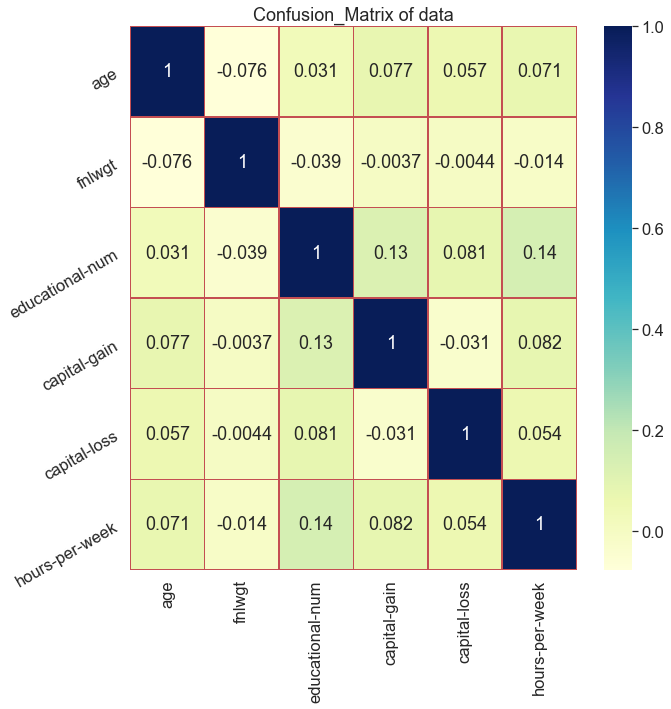

In [54]:
# Visualize The Feathure Correlations ::
sns.set( rc = {"figure.figsize" : [10 , 10]} , font_scale=1.5)
sns.heatmap(Con_Matrix , annot=True , cmap="YlGnBu" , linecolor="r" , linewidths=0.5)
plt.xticks(rotation = 90)
plt.yticks(rotation = 30)
plt.title("Confusion_Matrix of data")
# RdGy_r, RdPu, RdPu_r, RdYlBu, RdYlBu_r, RdYlGn, RdYlGn_r, Reds, Reds_r

In [55]:
df.head(2)

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K


In [56]:
# To Present species of workclass ::
workclasss = df["workclass"].value_counts()
workclasss

Private             33860
Self-emp-not-inc     3861
Local-gov            3136
State-gov            1981
Self-emp-inc         1694
Federal-gov          1432
Without-pay            21
Never-worked           10
Name: workclass, dtype: int64

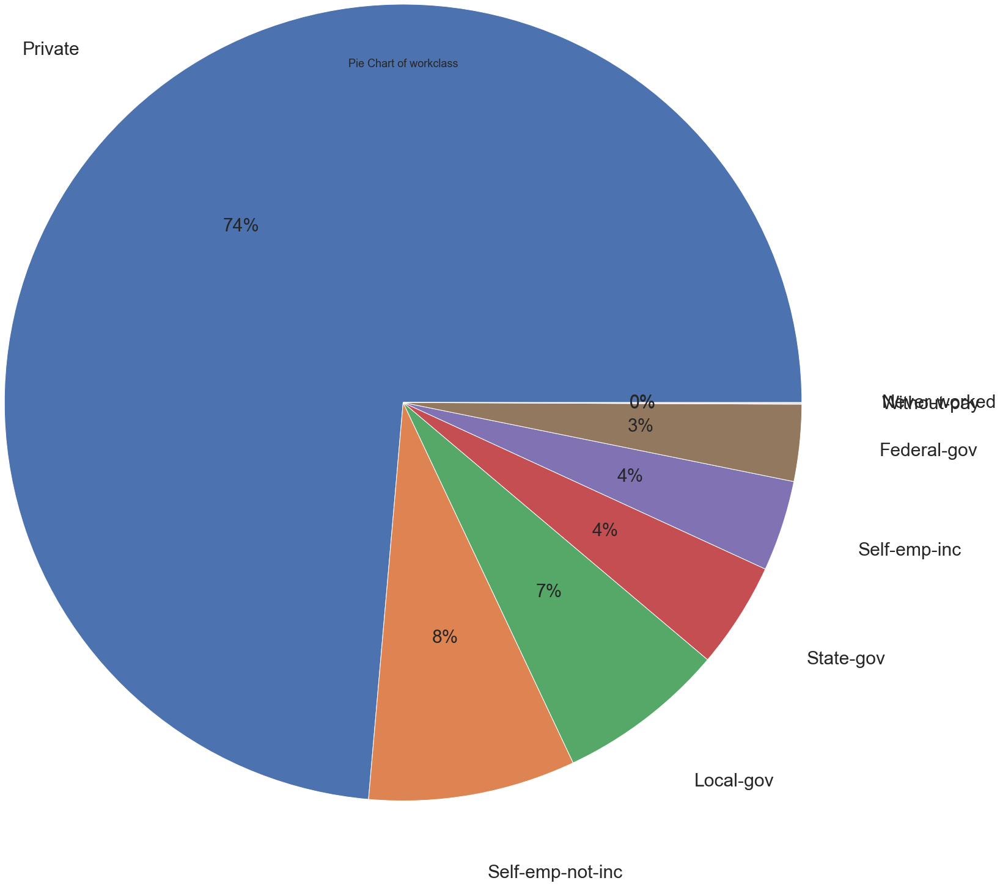

In [57]:
# Visualize Comparing workclass ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
workclasss.plot.pie(autopct = "%1.0f%%" , radius = 1.5 , labeldistance = 1.2 , fontsize = 30)
plt.title("Pie Chart of workclass")
plt.show()

In [58]:
# To Present species of education ::
educations = df["education"].value_counts()
educations

HS-grad         15770
Some-college    10863
Bachelors        8013
Masters          2656
Assoc-voc        2060
11th             1812
Assoc-acdm       1601
10th             1389
7th-8th           954
Prof-school       834
9th               756
12th              655
Doctorate         594
5th-6th           507
1st-4th           245
Preschool          81
Name: education, dtype: int64

Text(0.5, 1.0, 'Pie Chart of education')

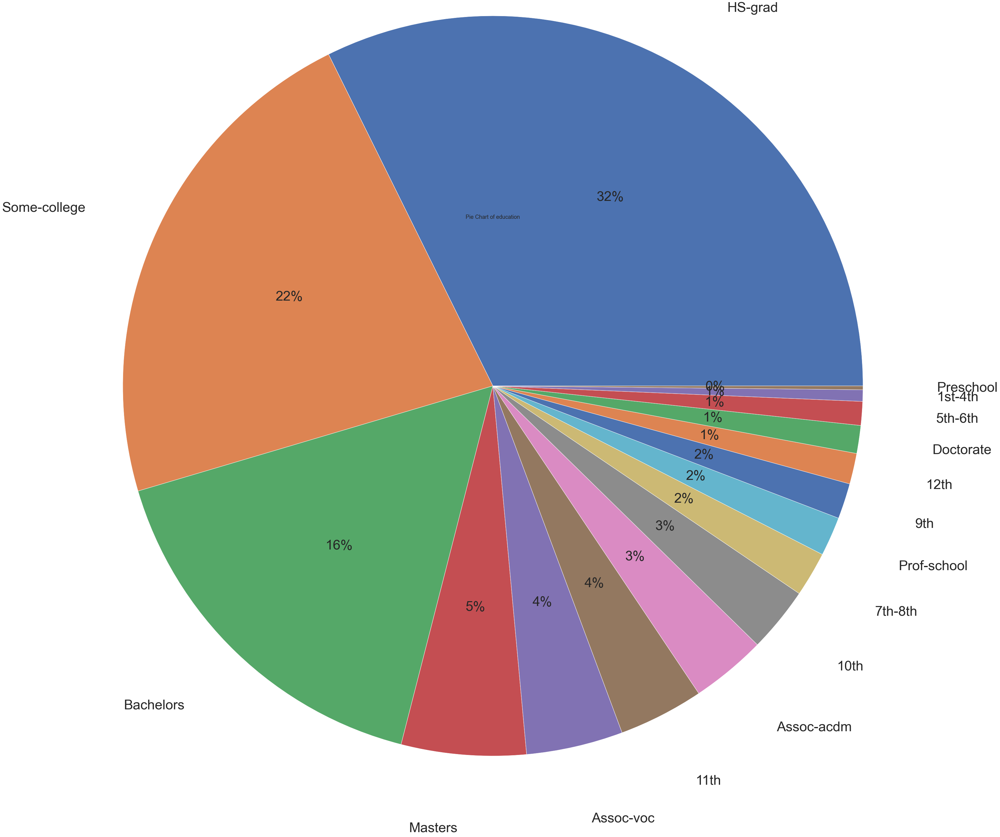

In [59]:
educations.plot.pie(autopct = "%1.0f%%" , radius = 2.8 , labeldistance = 1.2 , fontsize = 45)
plt.title("Pie Chart of education")

In [60]:
# To Present species of marital-status ::
marital_statuss = df["marital-status"].value_counts()
marital_statuss

Married-civ-spouse       22366
Never-married            16082
Divorced                  6630
Separated                 1530
Widowed                   1518
Married-spouse-absent      627
Married-AF-spouse           37
Name: marital-status, dtype: int64

Text(0.5, 1.0, 'Pie Chart of marital-status')

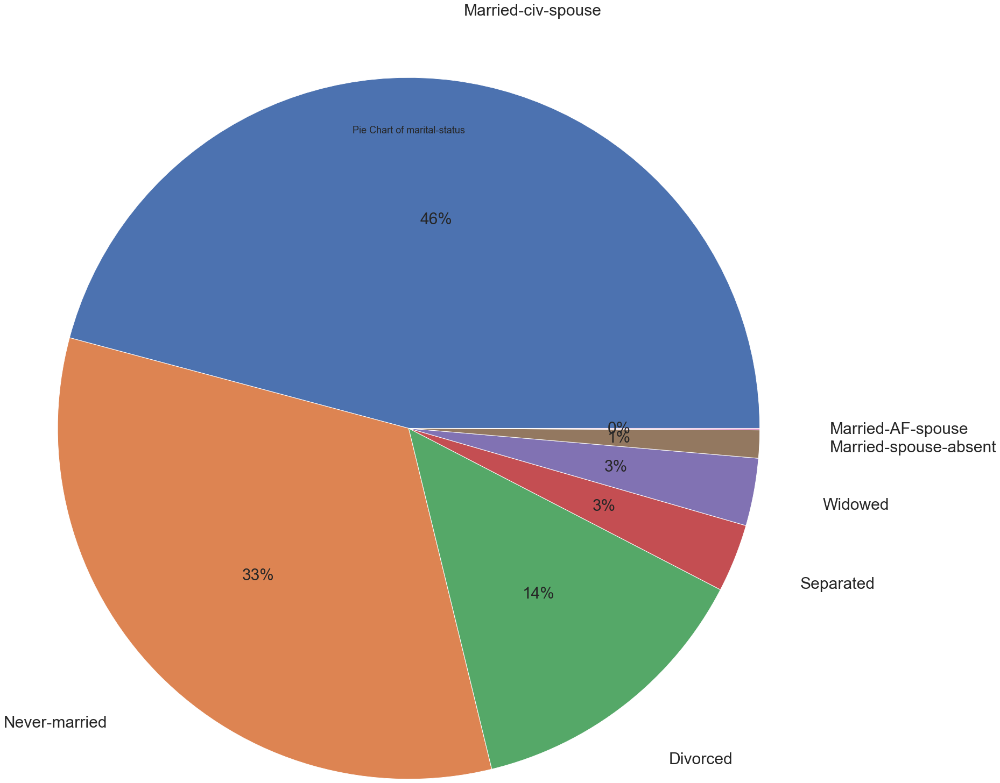

In [61]:
marital_statuss.plot.pie(autopct = "%1.0f%%" , radius = 1.5 , labeldistance = 1.2 , fontsize = 30)
plt.title("Pie Chart of marital-status")

In [62]:
# To Present species of occupation ::
occupations = df["occupation"].value_counts()
occupations

Prof-specialty       6165
Craft-repair         6102
Exec-managerial      6082
Adm-clerical         5606
Sales                5501
Other-service        4919
Machine-op-inspct    3017
Transport-moving     2355
Handlers-cleaners    2071
Farming-fishing      1485
Tech-support         1445
Protective-serv       982
Priv-house-serv       240
Armed-Forces           15
Name: occupation, dtype: int64

Text(0.5, 1.0, 'Pie Chart of occupation')

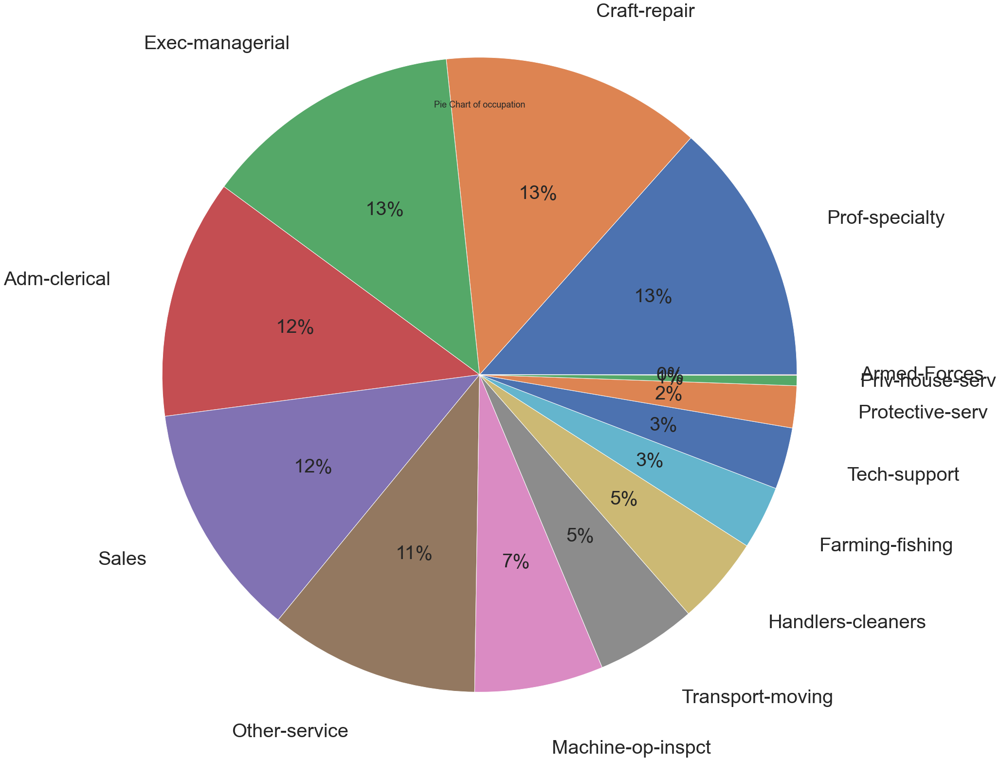

In [63]:
occupations.plot.pie(autopct = "%1.0f%%" , radius = 1.5 , labeldistance = 1.2 , fontsize = 40)
plt.title("Pie Chart of occupation")

In [64]:
# To Present species of relationship ::
relationships = df["relationship"].value_counts()
relationships

Husband           19703
Not-in-family     12557
Own-child          7569
Unmarried          5124
Wife               2331
Other-relative     1506
Name: relationship, dtype: int64

Text(0.5, 1.0, 'Pie Chart of relationship')

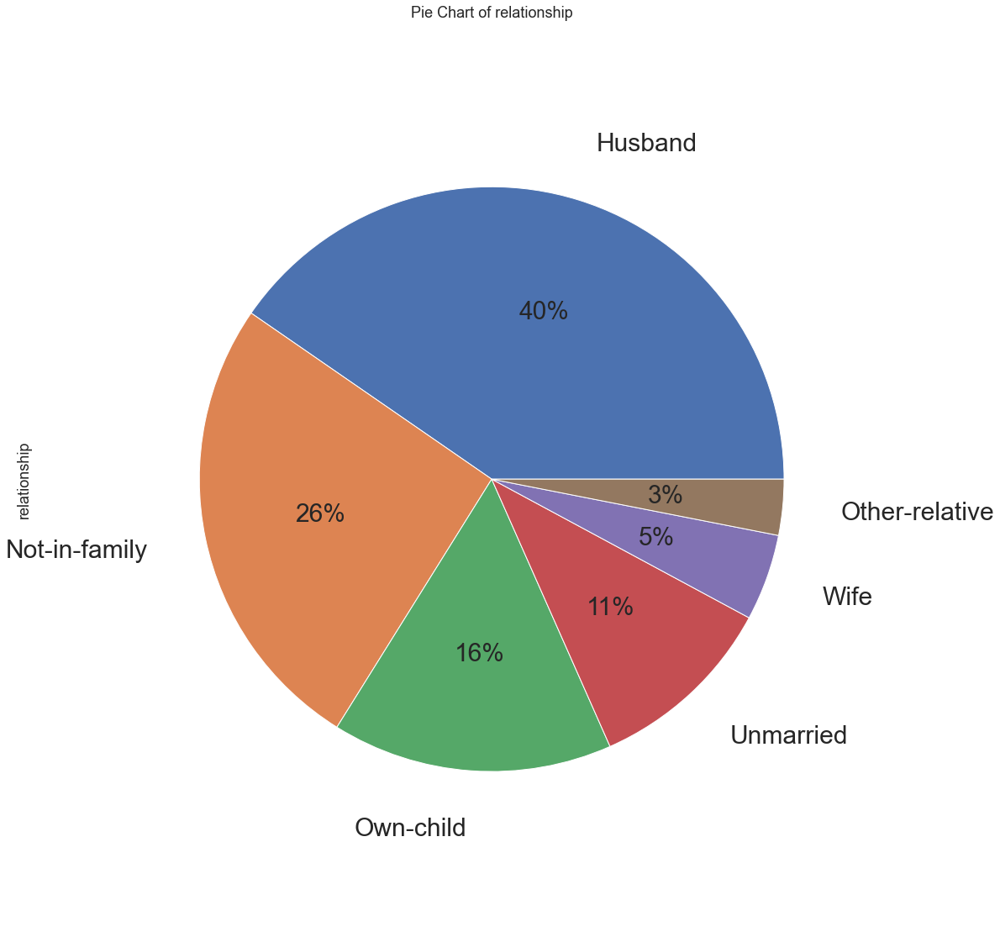

In [65]:
relationships.plot.pie(autopct = "%1.0f%%" , radius = 0.8 , labeldistance = 1.2 , fontsize = 30)
plt.title("Pie Chart of relationship")

In [66]:
# To Present species of race ::
races = df["race"].value_counts()
races

White                 41714
Black                  4683
Asian-Pac-Islander     1517
Amer-Indian-Eskimo      470
Other                   406
Name: race, dtype: int64

Text(0.5, 1.0, 'Pie Chart of race')

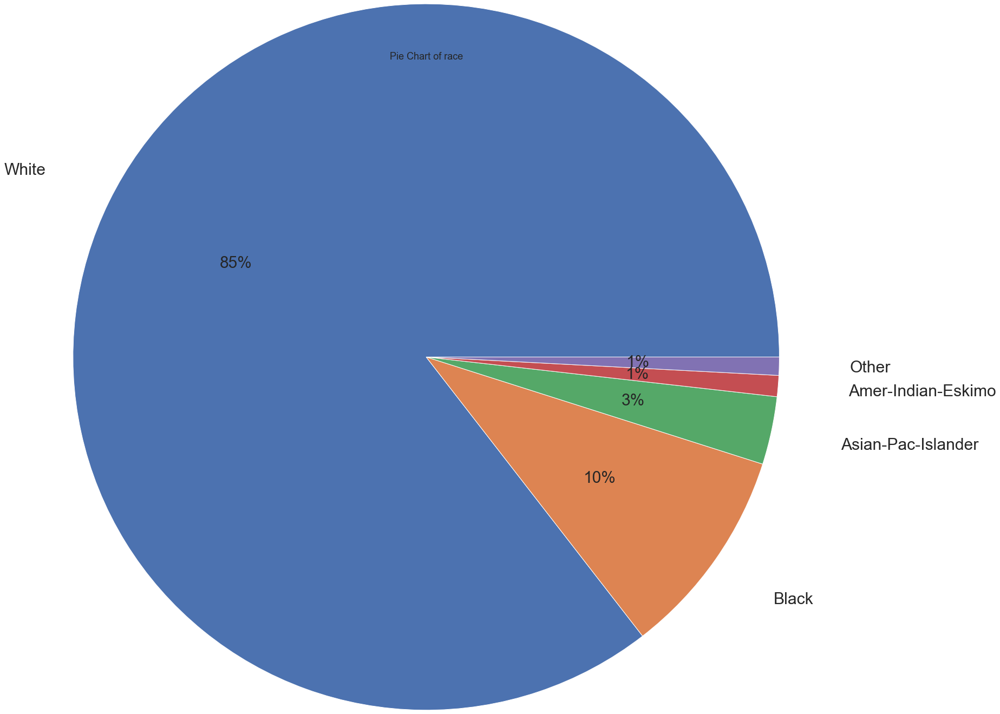

In [67]:
races.plot.pie(autopct = "%1.0f%%" , radius = 1.5 , labeldistance = 1.2 , fontsize = 30)
plt.title("Pie Chart of race")

In [68]:
# To Present species of gender ::
genders = df["gender"].value_counts()
genders

Male      32614
Female    16176
Name: gender, dtype: int64

Text(0.5, 1.0, 'Pie Chart of gender')

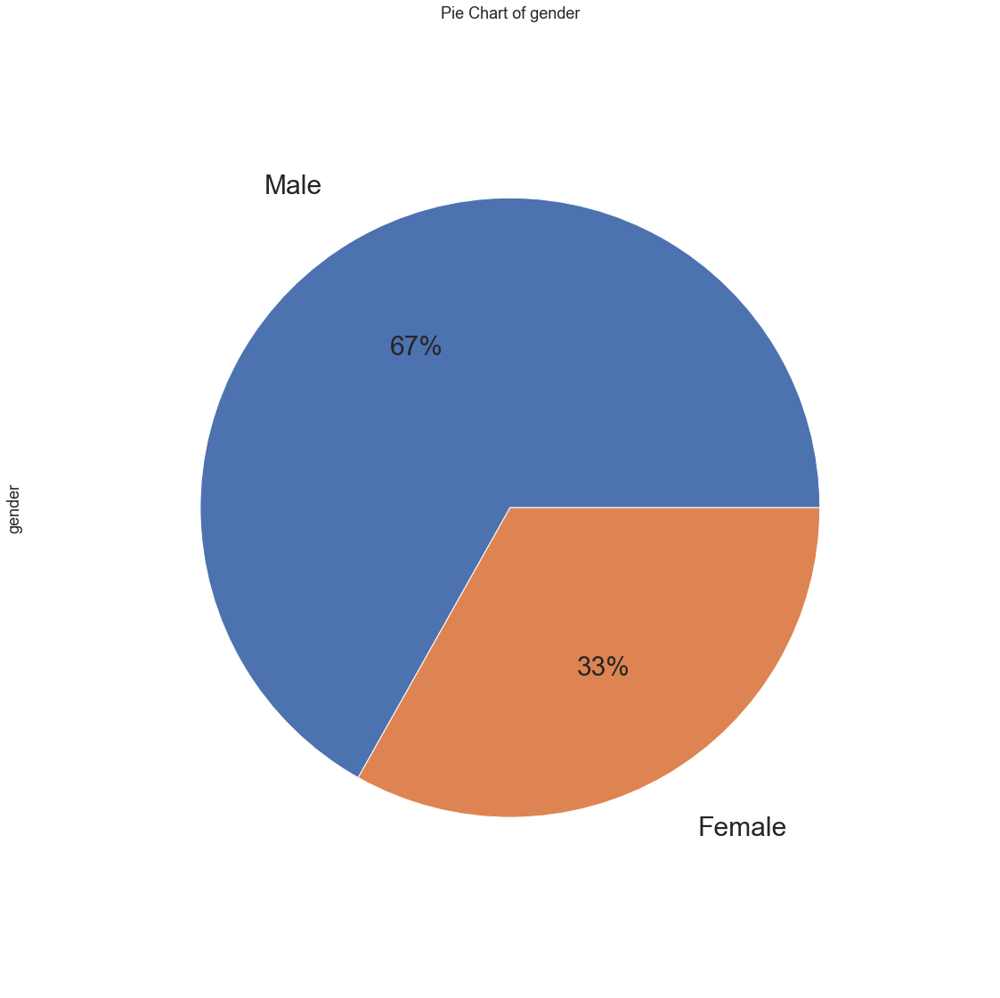

In [69]:
genders.plot.pie(autopct = "%1.0f%%" , radius = 0.8 , labeldistance = 1.2 , fontsize = 30)
plt.title("Pie Chart of gender")

In [70]:
# To Present species of native-country ::
native_countrys = df["native-country"].value_counts()
native_countrys

United-States                 43792
Mexico                          943
Philippines                     294
Germany                         206
Puerto-Rico                     184
Canada                          182
El-Salvador                     155
India                           151
Cuba                            138
England                         127
China                           122
South                           115
Jamaica                         106
Italy                           105
Dominican-Republic              103
Japan                            92
Poland                           87
Vietnam                          86
Guatemala                        86
Columbia                         85
Haiti                            75
Portugal                         67
Taiwan                           65
Iran                             59
Nicaragua                        49
Greece                           49
Peru                             46
Ecuador                     

In [71]:
# To Present species of income ::
incomes = df["income"].value_counts()
incomes

<=50K    37109
>50K     11681
Name: income, dtype: int64

Text(0.5, 1.0, 'Pie Chart of income')

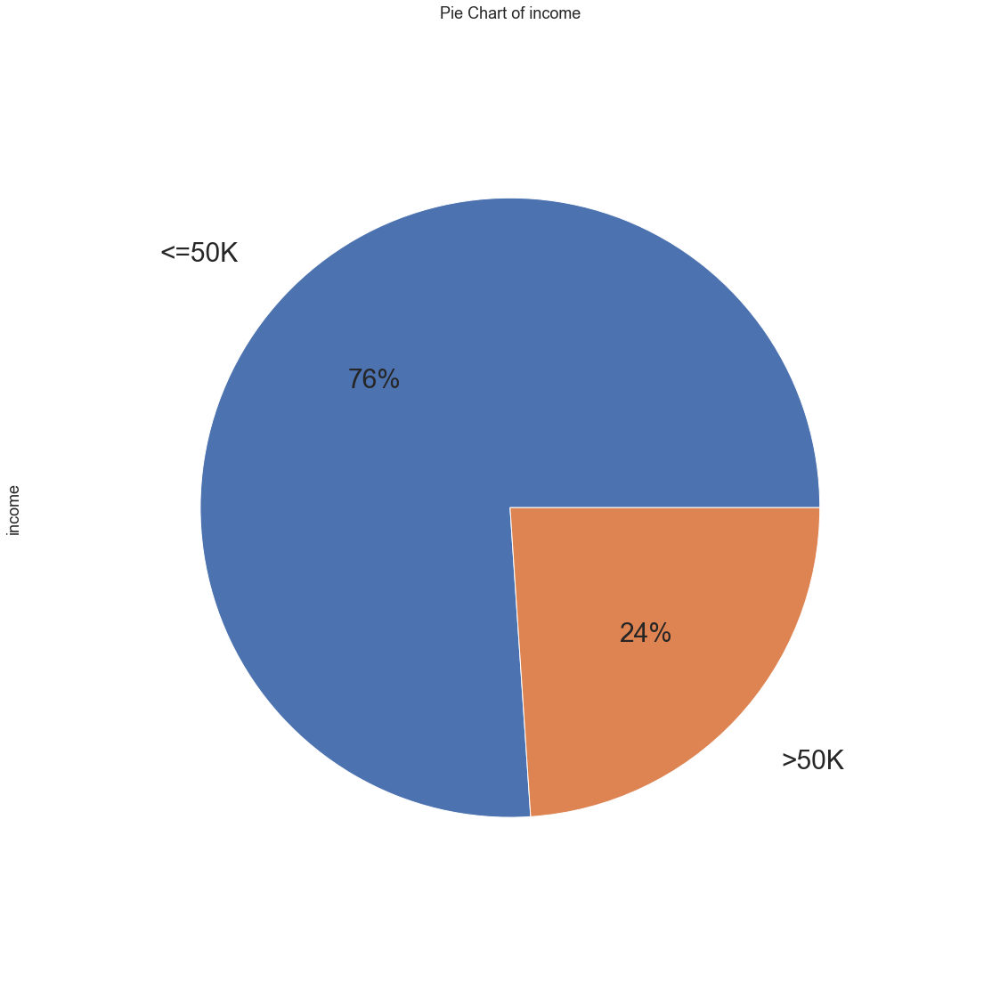

In [72]:
incomes.plot.pie(autopct = "%1.0f%%" , radius = 0.8 , labeldistance = 1.2 , fontsize = 30)
plt.title("Pie Chart of income")

In [73]:
df.head(2)

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K


Text(0.5, 1.0, 'Distribution Plot of age')

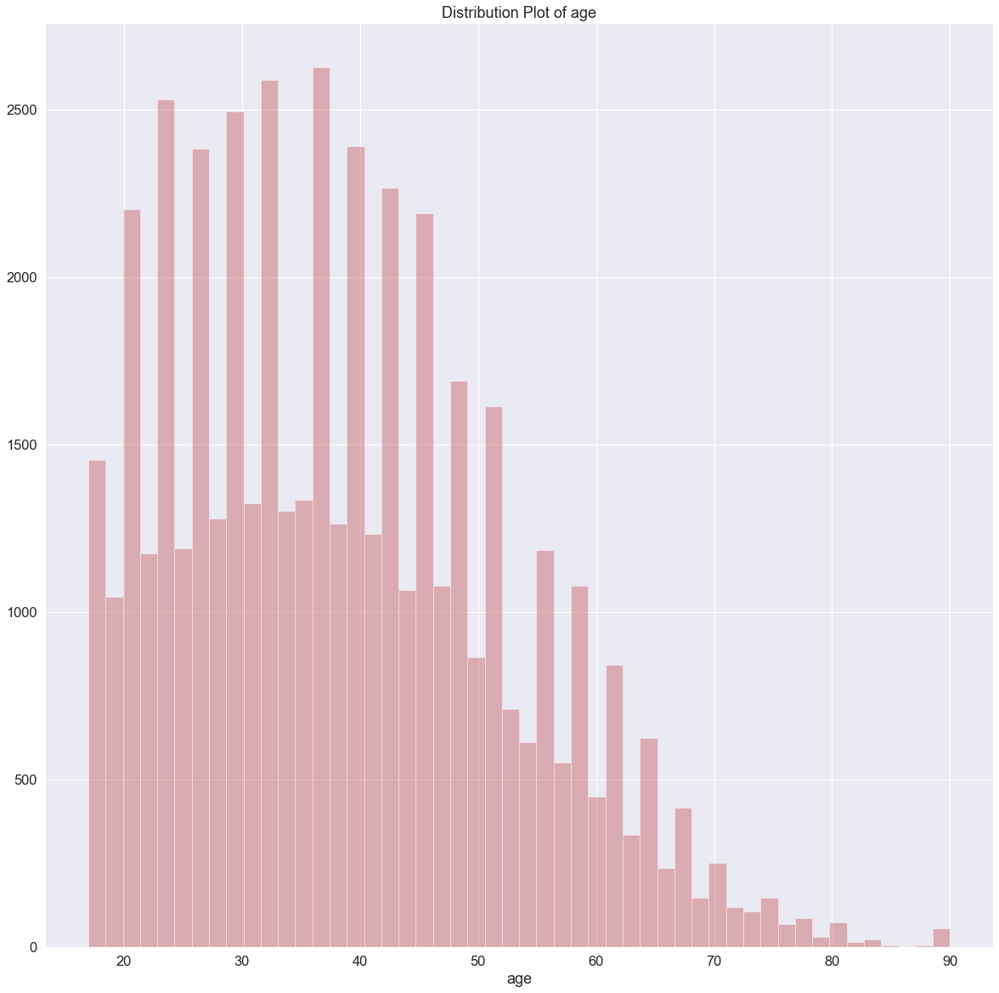

In [74]:
sns.distplot(df["age"] , kde=False , color="r")
plt.title("Distribution Plot of age")

Text(0.5, 1.0, 'Kde Plot of age')

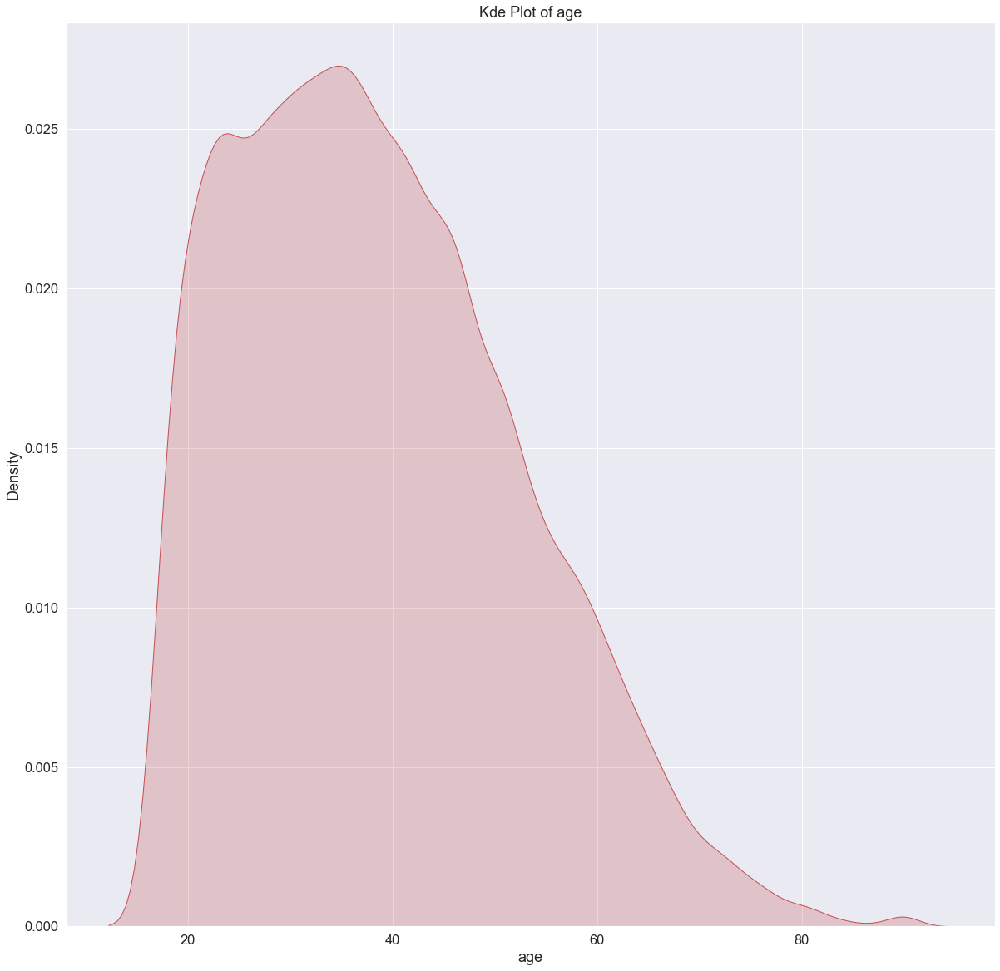

In [75]:
sns.kdeplot(df["age"] , shade=True , color="r")
plt.title("Kde Plot of age")

Text(0.5, 1.0, 'Distribution Plot of educational-num')

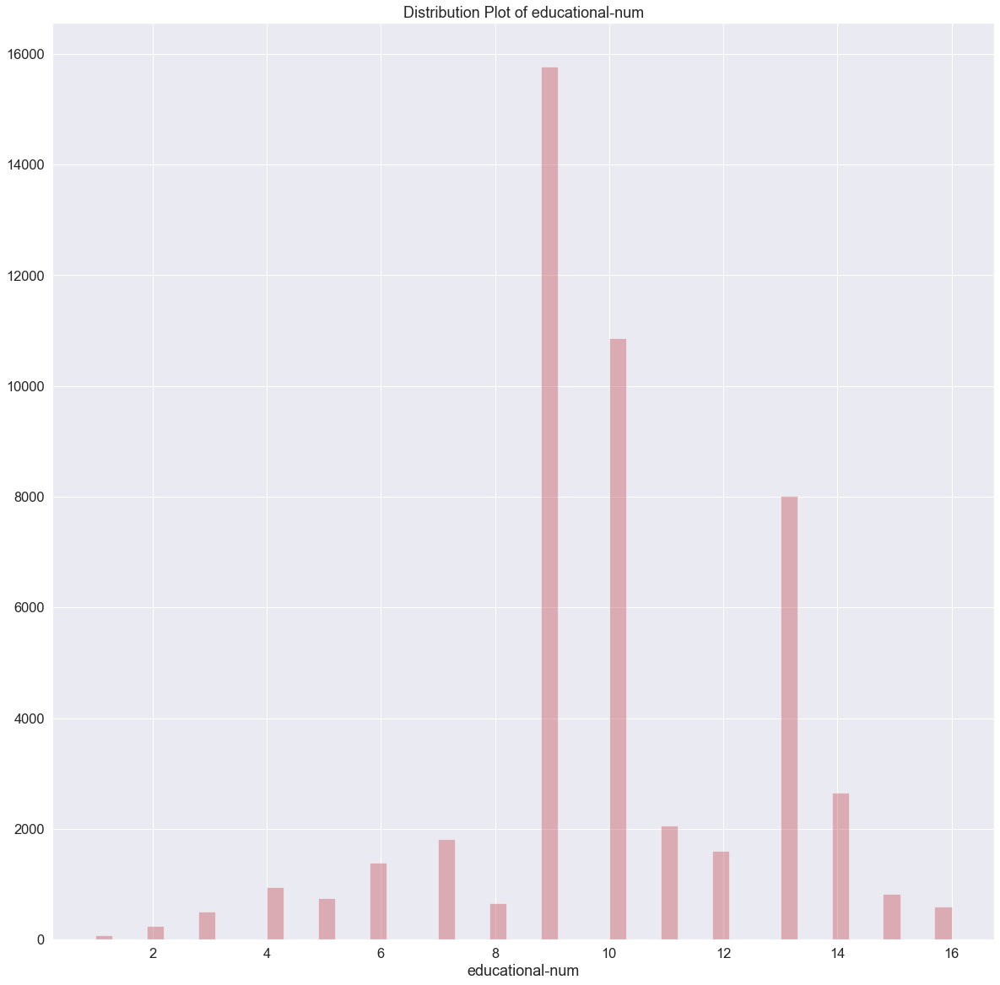

In [76]:
sns.distplot(df["educational-num"] , kde=False , color="r")
plt.title("Distribution Plot of educational-num")

Text(0.5, 1.0, 'Kde Plot of educational-num')

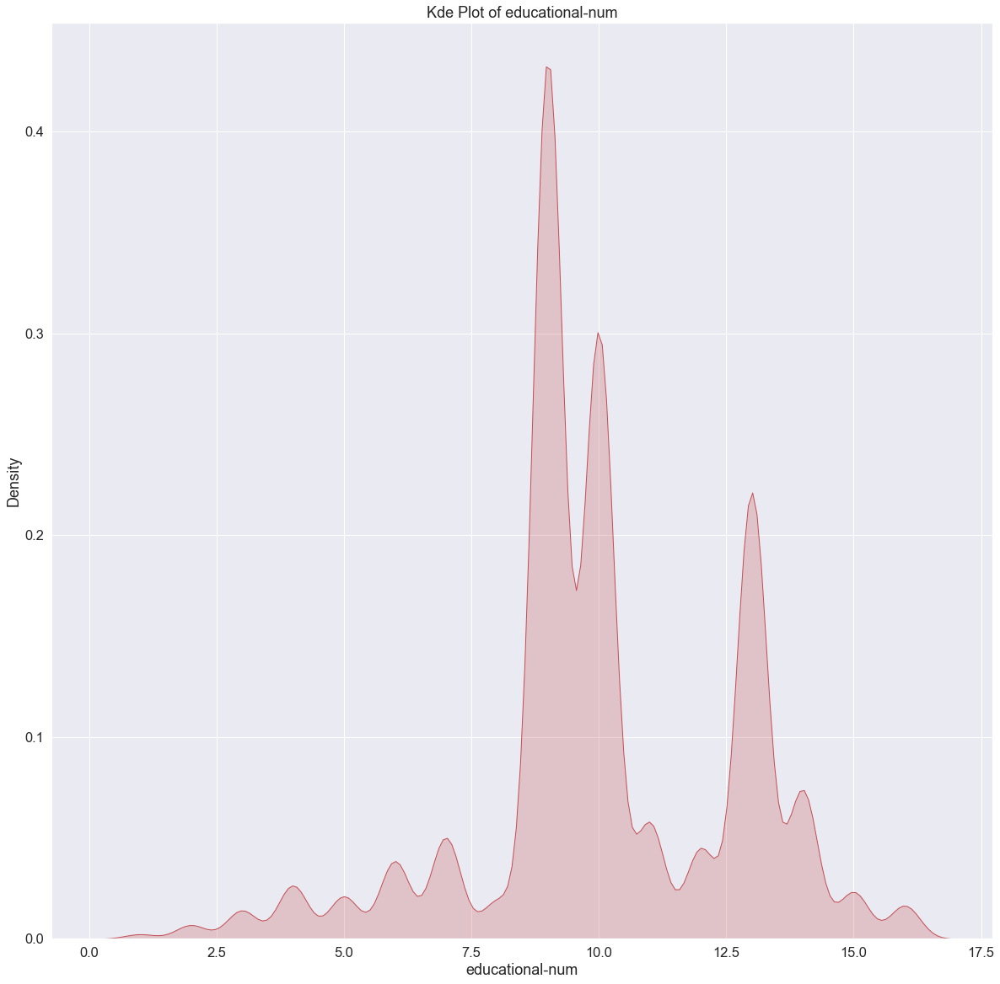

In [77]:
sns.kdeplot(df["educational-num"] , shade=True , color="r")
plt.title("Kde Plot of educational-num")

Text(0.5, 1.0, 'Distribution Plot of hours-per-week')

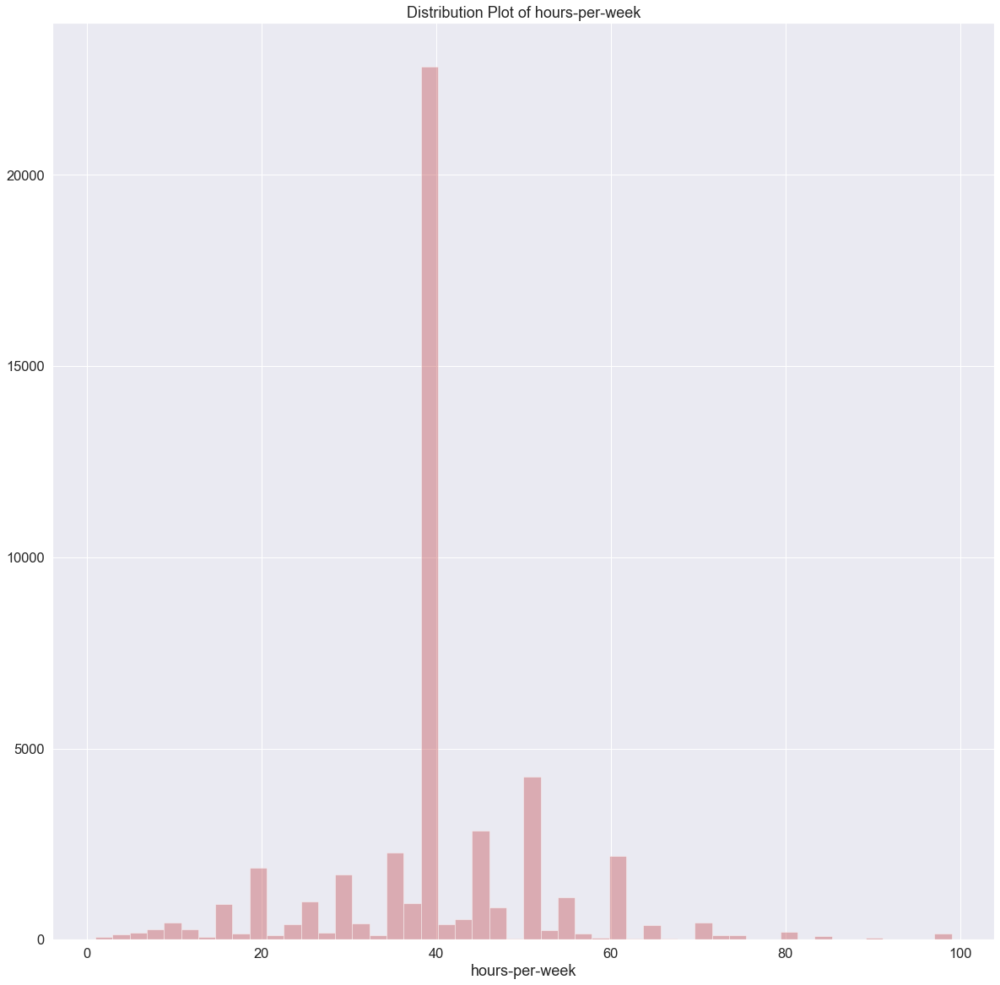

In [78]:
sns.distplot(df["hours-per-week"] , kde=False , color="r")
plt.title("Distribution Plot of hours-per-week")

Text(0.5, 1.0, 'Kde Plot of hours-per-week')

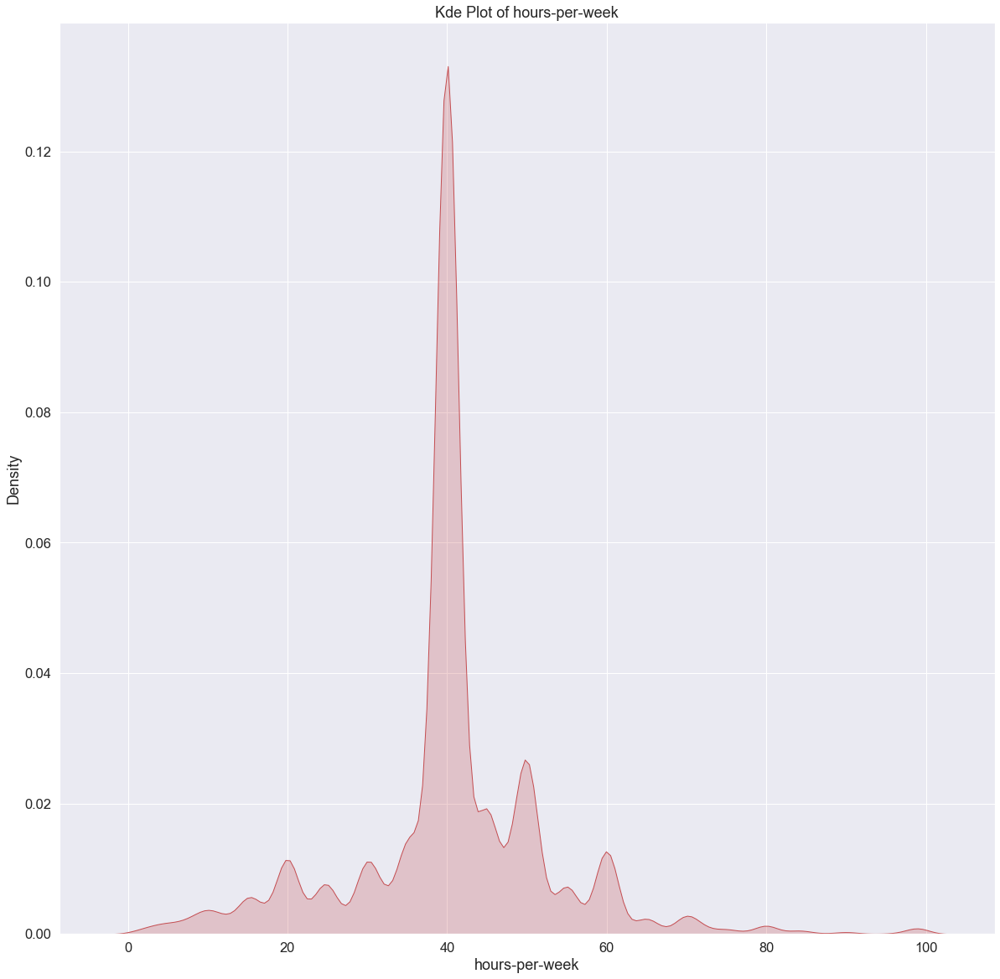

In [79]:
sns.kdeplot(df["hours-per-week"] , shade=True , color="r")
plt.title("Kde Plot of hours-per-week")

Text(0.5, 1.0, 'Distribution Plot of capital-gain')

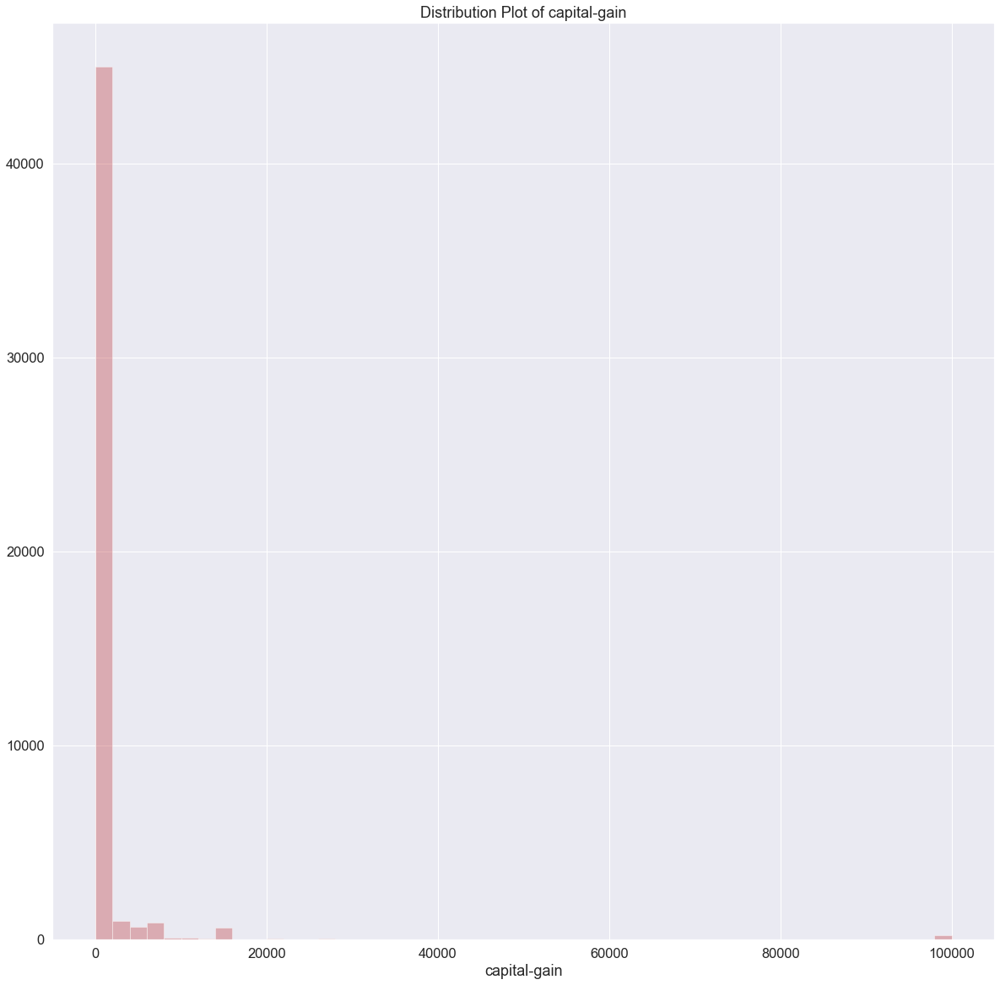

In [80]:
sns.distplot(df["capital-gain"] , kde=False , color="r")
plt.title("Distribution Plot of capital-gain")

Text(0.5, 1.0, 'Kde Plot of capital-gain')

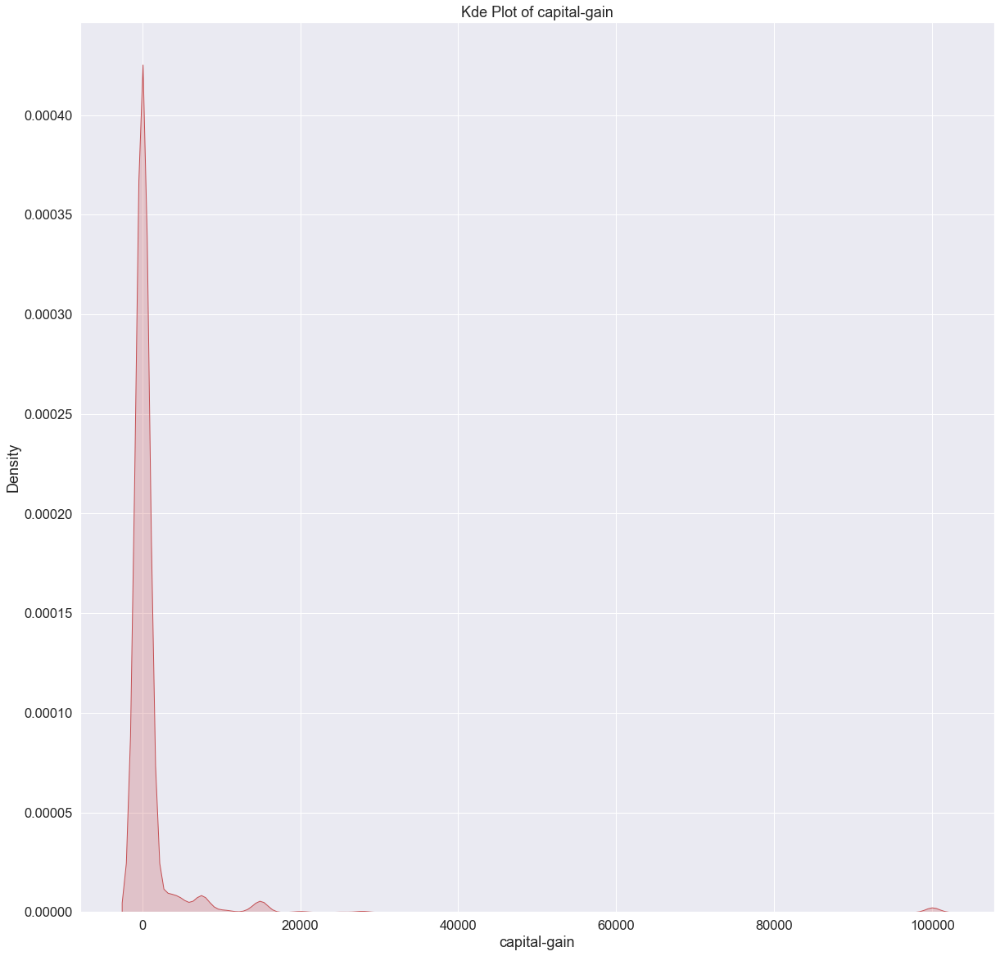

In [81]:
sns.kdeplot(df["capital-gain"] , shade=True , color="r")
plt.title("Kde Plot of capital-gain")

Text(0.5, 1.0, 'Distribution Plot of capital-loss')

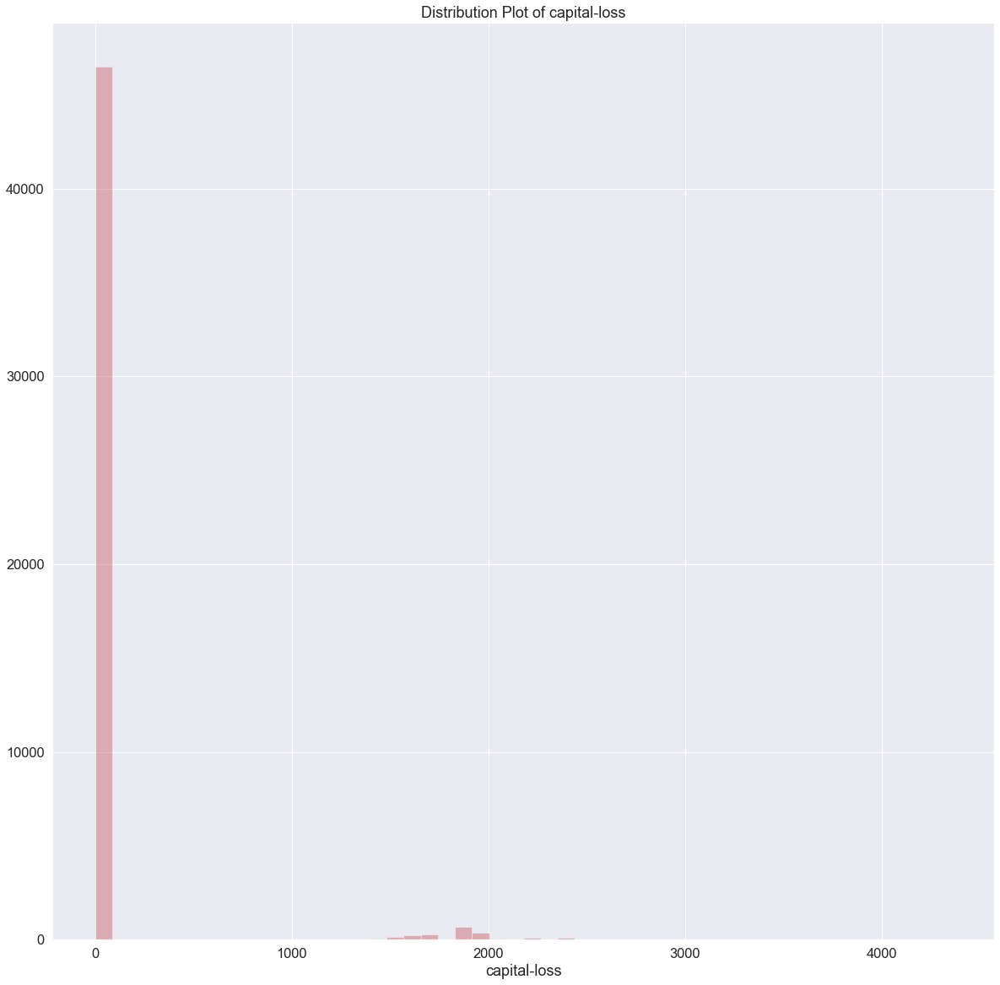

In [82]:
sns.distplot(df["capital-loss"] , kde=False , color="r")
plt.title("Distribution Plot of capital-loss")

Text(0.5, 1.0, 'Kde Plot of capital-loss')

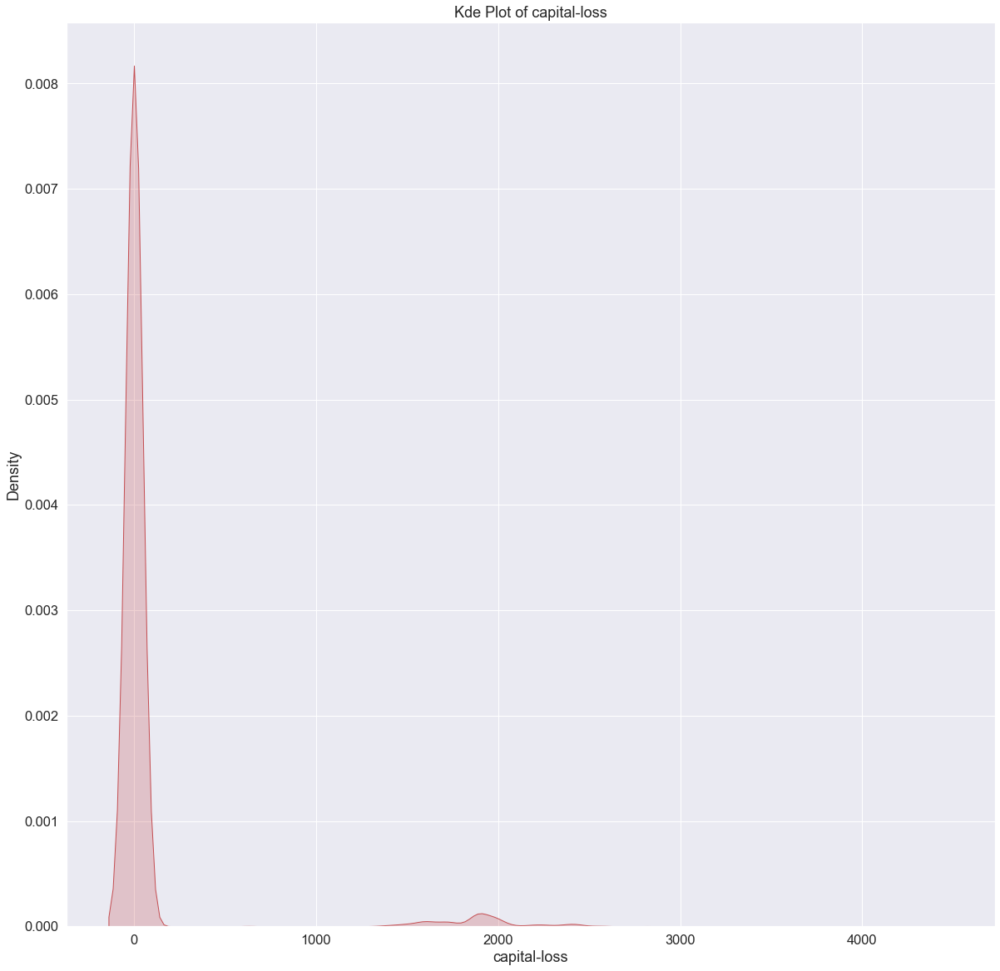

In [83]:
sns.kdeplot(df["capital-loss"] , shade=True , color="r")
plt.title("Kde Plot of capital-loss")

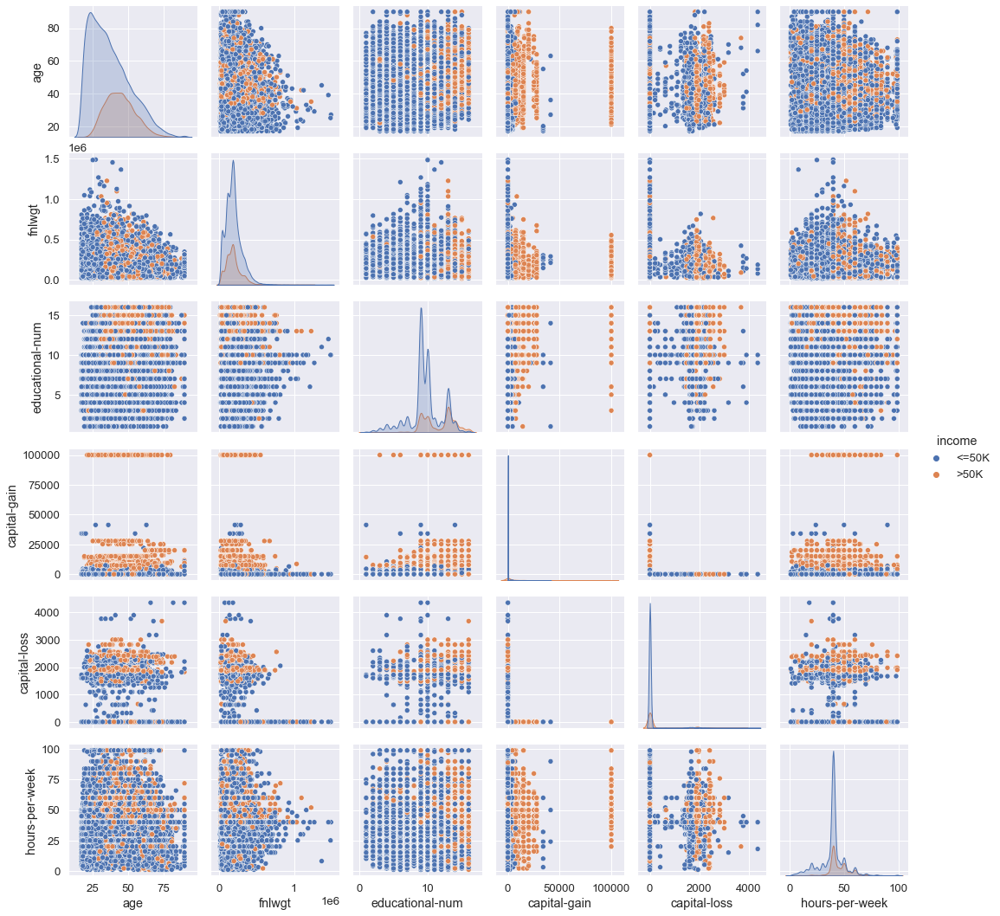

In [84]:
sns.set( rc = {"figure.figsize" : [30 , 30]} , font_scale=1.2)
sns.pairplot(df , hue = "income")

In [85]:
df.head(2)

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K


Text(0.5, 1.0, 'Swarm Plot of age and hours-per-week Based on income ')

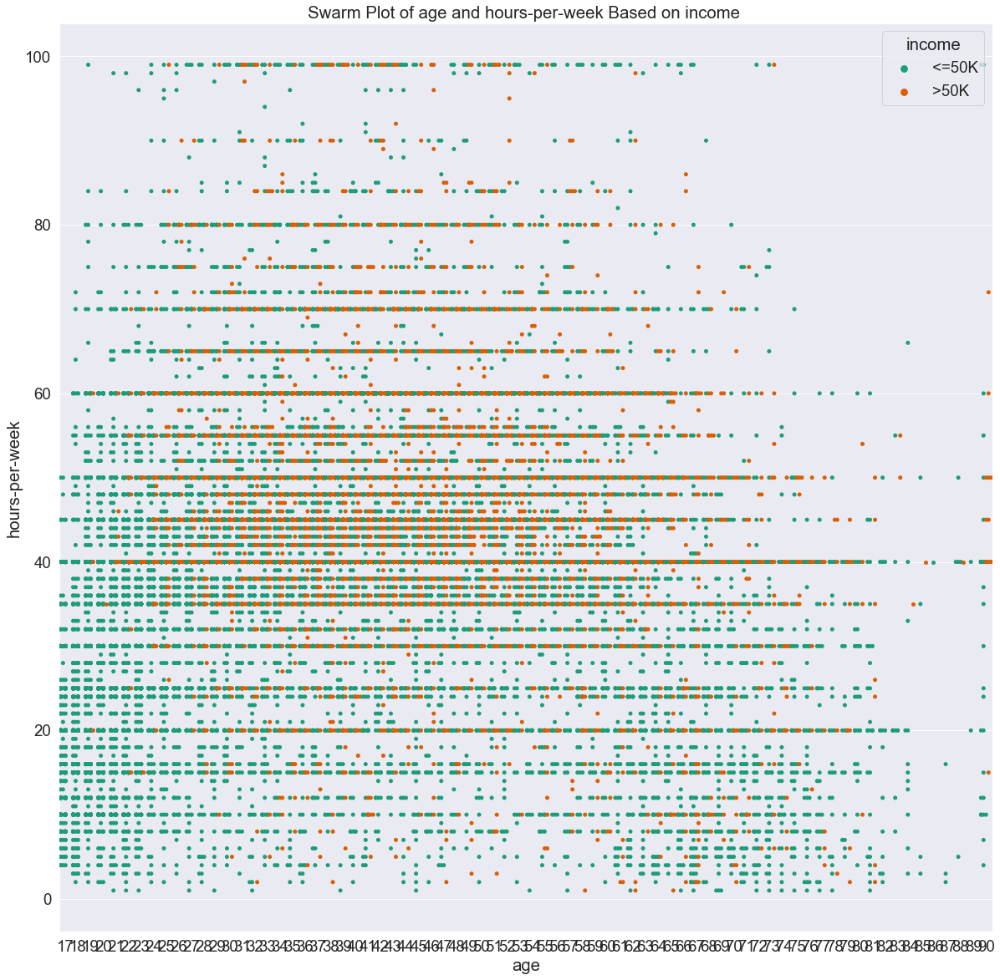

In [86]:
sns.set( rc = {"figure.figsize" : [20 , 20]} , font_scale=1.7)
sns.swarmplot( x = "age" , y = "hours-per-week" , data = df ,hue = "income" ,  palette="Dark2" , dodge=True)
plt.title("Swarm Plot of age and hours-per-week Based on income ")

KeyboardInterrupt: 

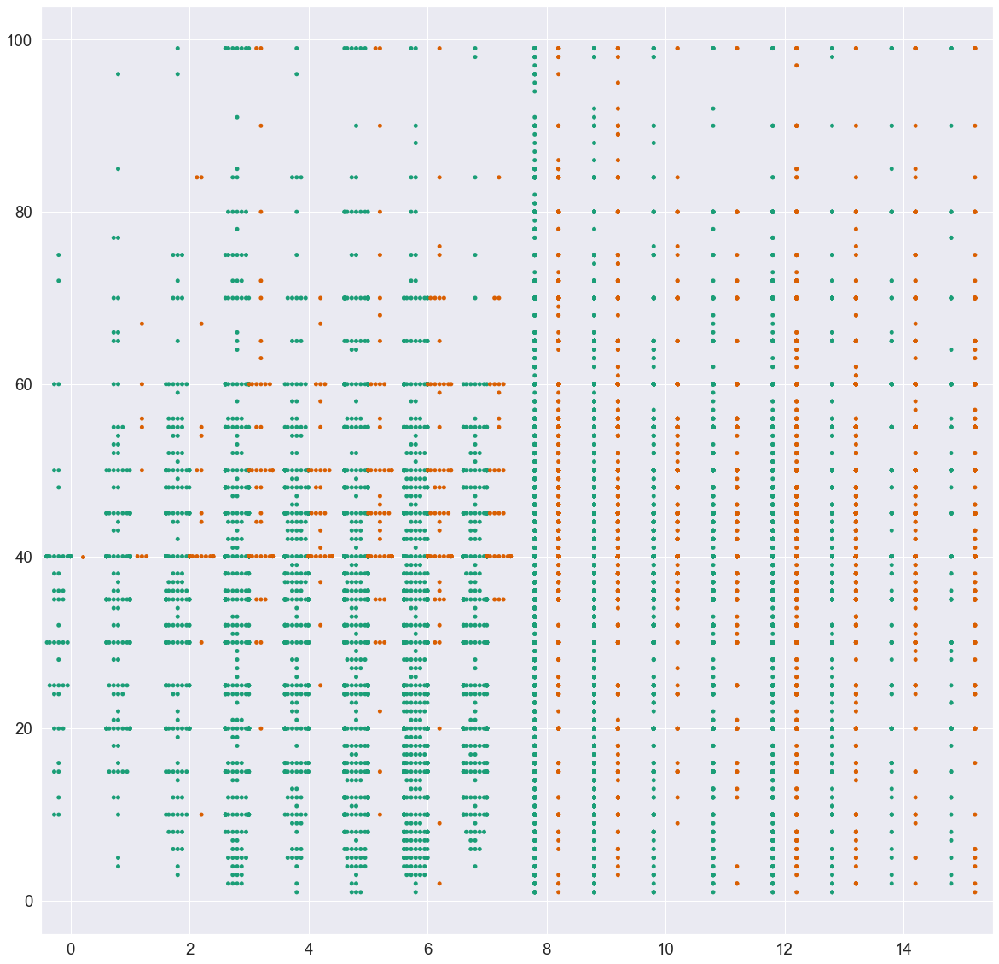

In [87]:
sns.set( rc = {"figure.figsize" : [20 , 20]} , font_scale=1.7)
sns.swarmplot( x = "educational-num" , y = "hours-per-week" , data = df ,hue = "income" ,  palette="Dark2" , dodge=True)
plt.title("Swarm Plot of educational-num and hours-per-week Based on income ")

In [ ]:
sns.set( rc = {"figure.figsize" : [20 , 20]} , font_scale=1.7)
sns.swarmplot( x = "age" , y = "educational-num" , data = df ,hue = "income" ,  palette="Dark2" , dodge=True)
plt.title("Swarm Plot of age and educational-num Based on income ")

Text(0.5, 1.0, 'Box Plot of educational-num and age Based on income ')

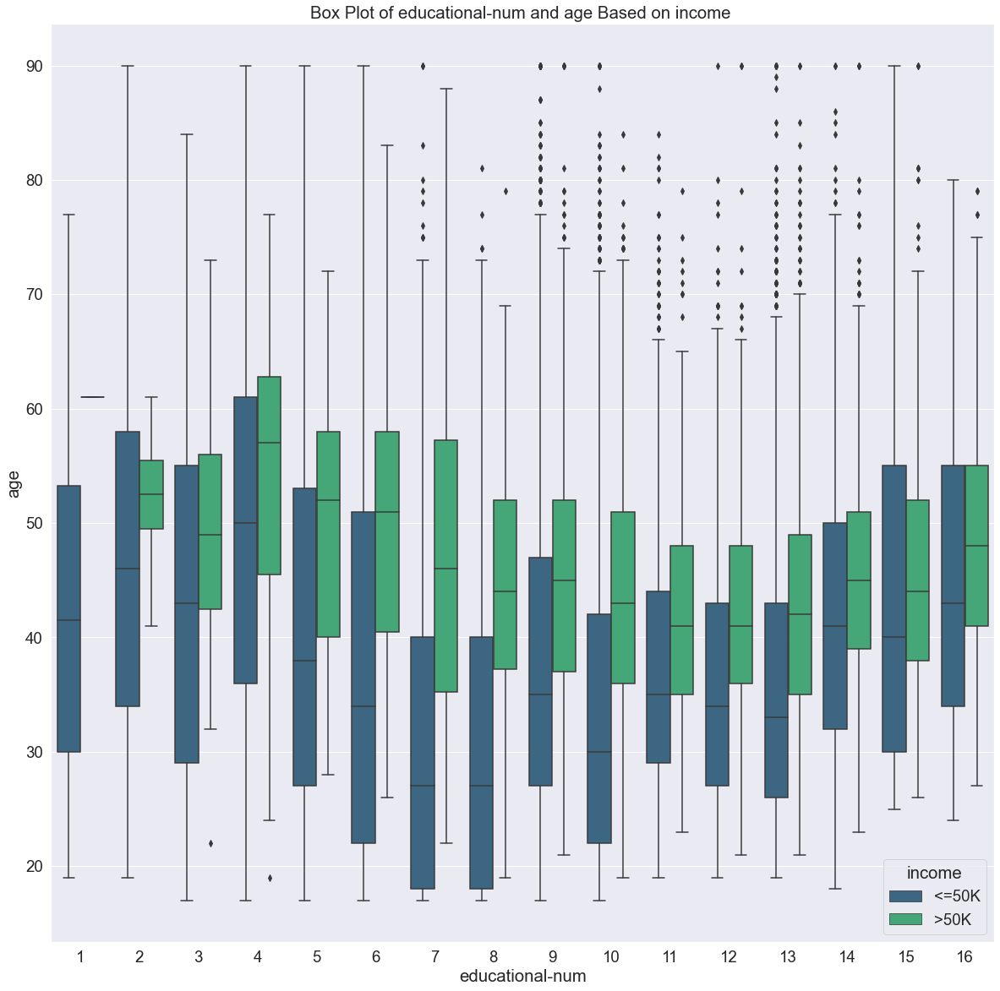

In [88]:
sns.boxplot( x = "educational-num" , y = "age" , data = df ,hue = "income" ,  palette="viridis" , dodge=True)
plt.title("Box Plot of educational-num and age Based on income ")

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
        85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95]),
 [Text(0, 0, '1'),
  Text(1, 0, '2'),
  Text(2, 0, '3'),
  Text(3, 0, '4'),
  Text(4, 0, '5'),
  Text(5, 0, '6'),
  Text(6, 0, '7'),
  Text(7, 0, '8'),
  Text(8, 0, '9'),
  Text(9, 0, '10'),
  Text(10, 0, '11'),
  Text(11, 0, '12'),
  Text(12, 0, '13'),
  Text(13, 0, '14'),
  Text(14, 0, '15'),
  Text(15, 0, '16'),
  Text(16, 0, '17'),
  Text(17, 0, '18'),
  Text(18, 0, '19'),
  Text(19, 0, '20'),
  Text(20, 0, '21'),
  Text(21, 0, '22'),
  Text(22, 0, '23'),
  Text(23, 0, '24'),
  Text(24, 0, '25'),
  Text(25, 0, '26'),
  Text(26, 0, '27'),
  Text(27, 0, '28'

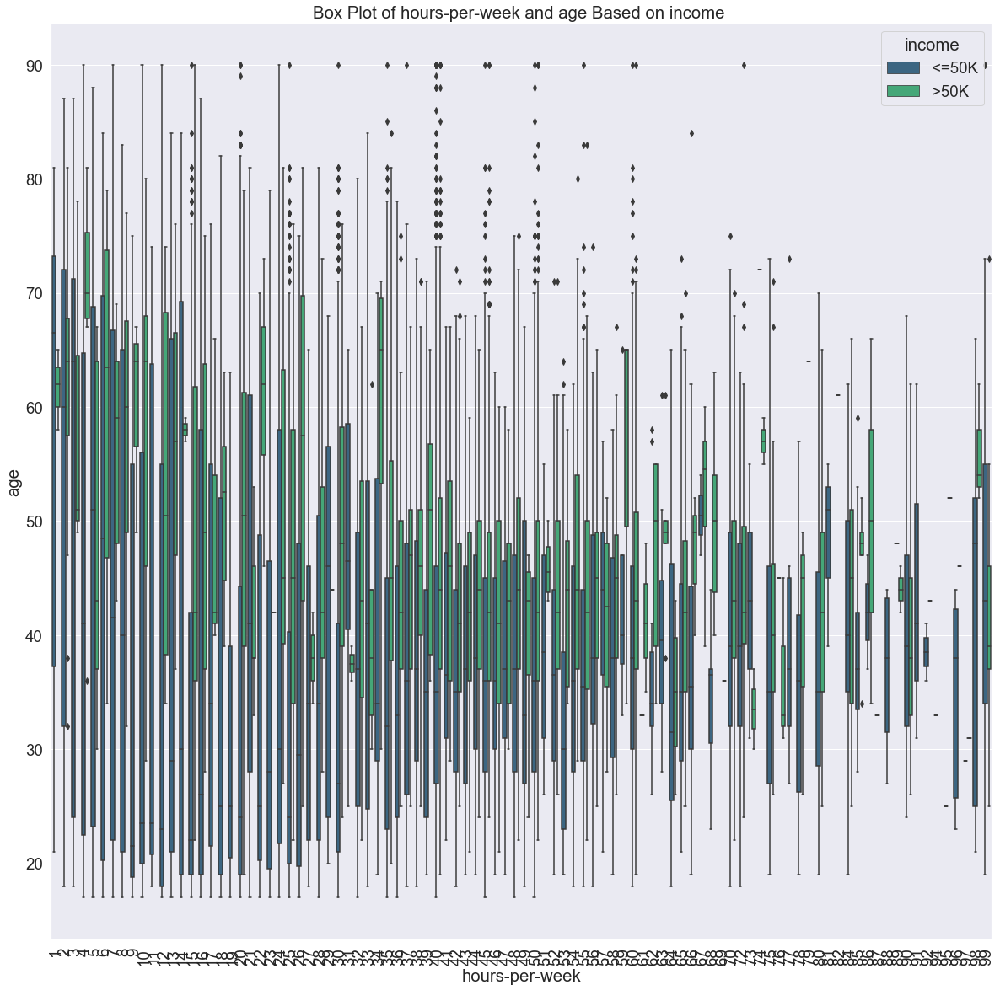

In [89]:
sns.boxplot( x = "hours-per-week" , y = "age" , data = df ,hue = "income" ,  palette="viridis" , dodge=True)
plt.title("Box Plot of hours-per-week and age Based on income ")
plt.xticks(rotation = 90)

Text(0.5, 1.0, 'Box Plot of educational-num and hours-per-week Based on income ')

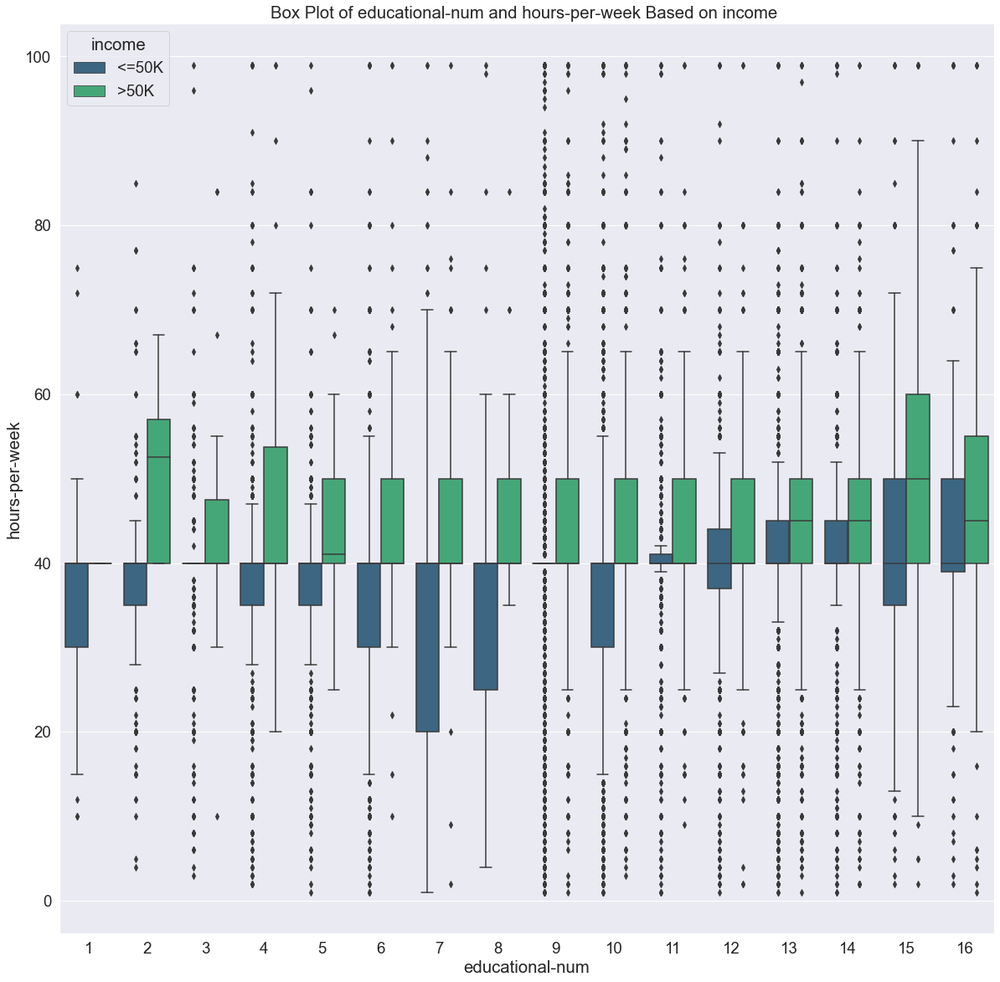

In [90]:
sns.boxplot( x = "educational-num" , y = "hours-per-week" , data = df ,hue = "income" ,  palette="viridis" , dodge=True)
plt.title("Box Plot of educational-num and hours-per-week Based on income ")

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73]),
 [Text(0, 0, '17'),
  Text(1, 0, '18'),
  Text(2, 0, '19'),
  Text(3, 0, '20'),
  Text(4, 0, '21'),
  Text(5, 0, '22'),
  Text(6, 0, '23'),
  Text(7, 0, '24'),
  Text(8, 0, '25'),
  Text(9, 0, '26'),
  Text(10, 0, '27'),
  Text(11, 0, '28'),
  Text(12, 0, '29'),
  Text(13, 0, '30'),
  Text(14, 0, '31'),
  Text(15, 0, '32'),
  Text(16, 0, '33'),
  Text(17, 0, '34'),
  Text(18, 0, '35'),
  Text(19, 0, '36'),
  Text(20, 0, '37'),
  Text(21, 0, '38'),
  Text(22, 0, '39'),
  Text(23, 0, '40'),
  Text(24, 0, '41'),
  Text(25, 0, '42'),
  Text(26, 0, '43'),
  Text(27, 0, '44'),
  Text(28, 0, '45'),
  Text(29, 0, '46'),
  Text(30, 0, '47'),
  Text(31, 0, '48'),


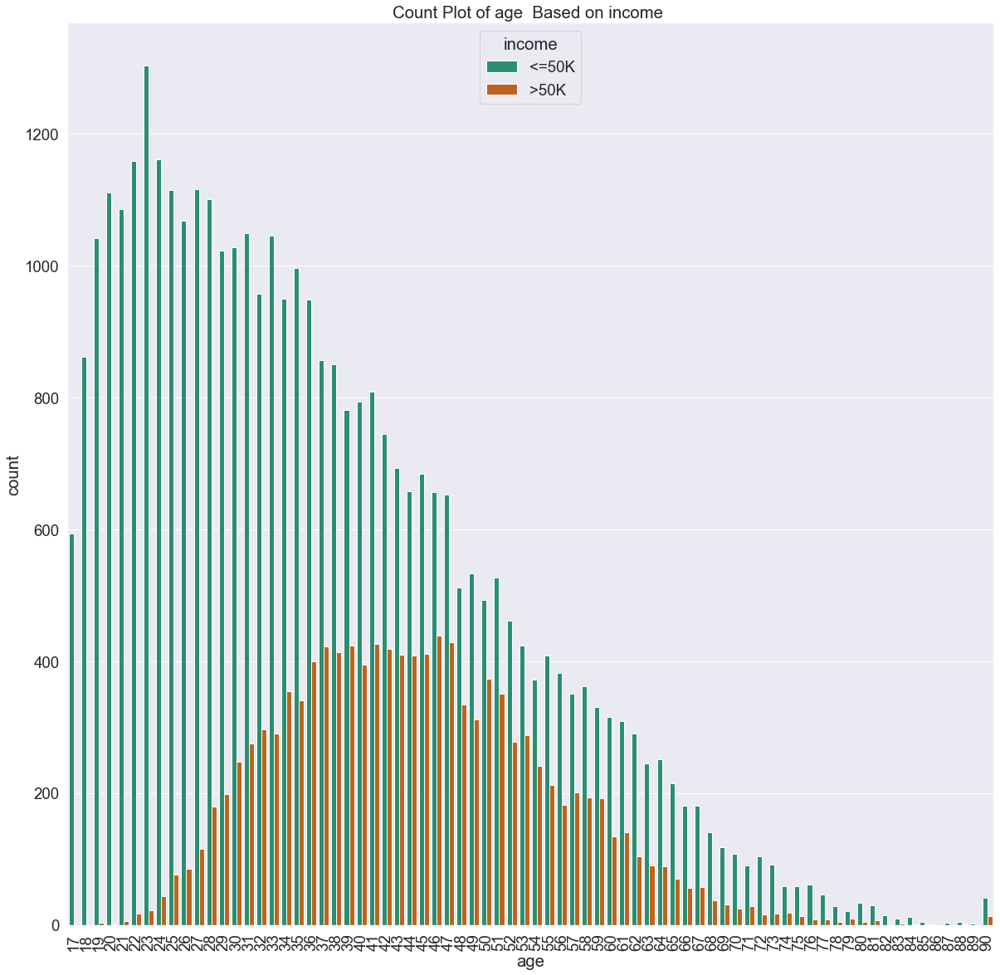

In [91]:
sns.countplot( x = "age"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of age  Based on income ")
plt.xticks(rotation = 90)

(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'Private'),
  Text(1, 0, 'Local-gov'),
  Text(2, 0, 'Self-emp-not-inc'),
  Text(3, 0, 'Federal-gov'),
  Text(4, 0, 'State-gov'),
  Text(5, 0, 'Self-emp-inc'),
  Text(6, 0, 'Without-pay'),
  Text(7, 0, 'Never-worked')])

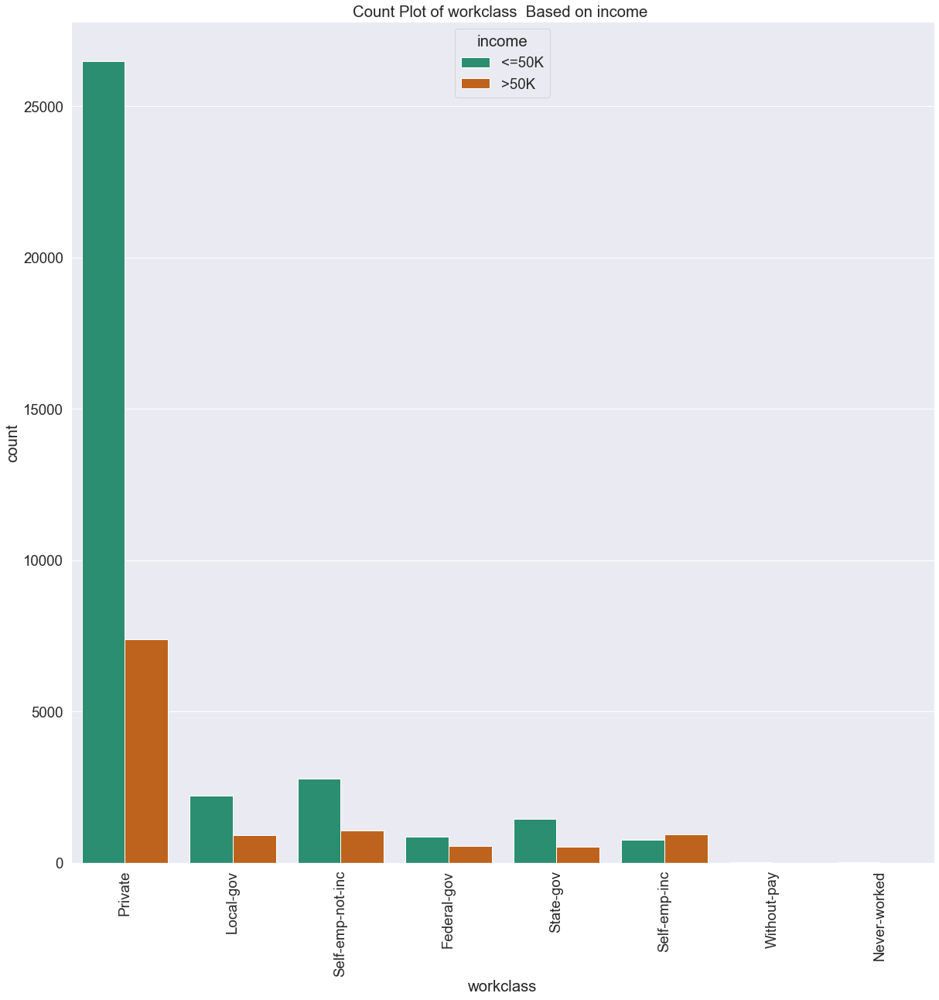

In [92]:
sns.countplot( x = "workclass"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of workclass  Based on income ")
plt.xticks(rotation = 90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, '11th'),
  Text(1, 0, 'HS-grad'),
  Text(2, 0, 'Assoc-acdm'),
  Text(3, 0, 'Some-college'),
  Text(4, 0, '10th'),
  Text(5, 0, 'Prof-school'),
  Text(6, 0, '7th-8th'),
  Text(7, 0, 'Bachelors'),
  Text(8, 0, 'Masters'),
  Text(9, 0, 'Doctorate'),
  Text(10, 0, '5th-6th'),
  Text(11, 0, 'Assoc-voc'),
  Text(12, 0, '9th'),
  Text(13, 0, '12th'),
  Text(14, 0, '1st-4th'),
  Text(15, 0, 'Preschool')])

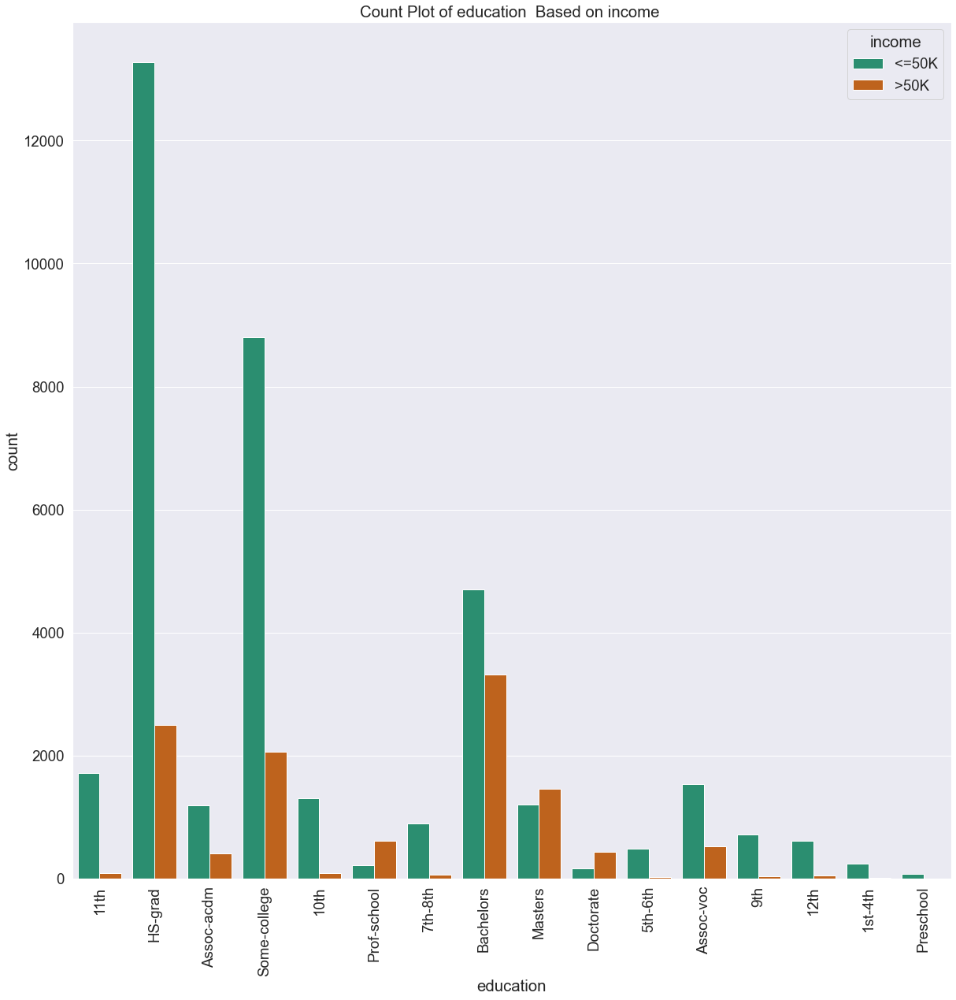

In [93]:
sns.countplot( x = "education"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of education  Based on income ")
plt.xticks(rotation = 90)

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'Never-married'),
  Text(1, 0, 'Married-civ-spouse'),
  Text(2, 0, 'Widowed'),
  Text(3, 0, 'Divorced'),
  Text(4, 0, 'Separated'),
  Text(5, 0, 'Married-spouse-absent'),
  Text(6, 0, 'Married-AF-spouse')])

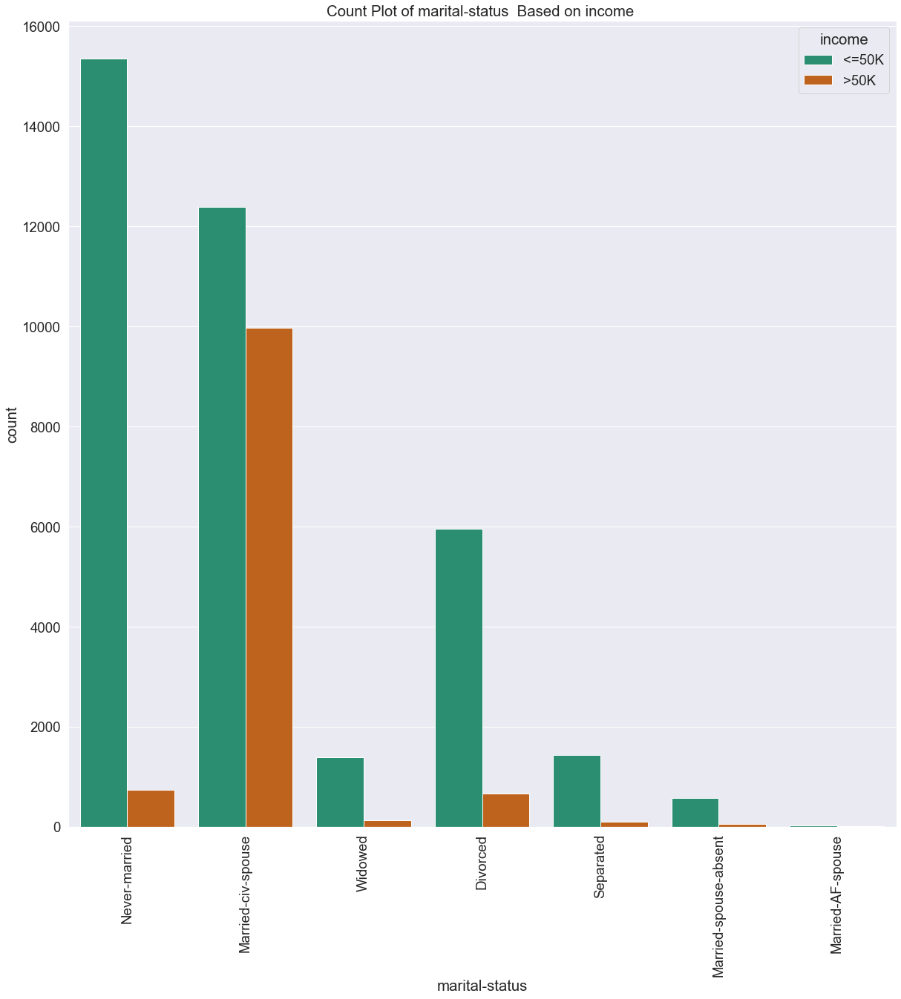

In [94]:
sns.countplot( x = "marital-status"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of marital-status  Based on income ")
plt.xticks(rotation = 90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13]),
 [Text(0, 0, 'Machine-op-inspct'),
  Text(1, 0, 'Farming-fishing'),
  Text(2, 0, 'Protective-serv'),
  Text(3, 0, 'Other-service'),
  Text(4, 0, 'Prof-specialty'),
  Text(5, 0, 'Craft-repair'),
  Text(6, 0, 'Adm-clerical'),
  Text(7, 0, 'Exec-managerial'),
  Text(8, 0, 'Tech-support'),
  Text(9, 0, 'Sales'),
  Text(10, 0, 'Priv-house-serv'),
  Text(11, 0, 'Transport-moving'),
  Text(12, 0, 'Handlers-cleaners'),
  Text(13, 0, 'Armed-Forces')])

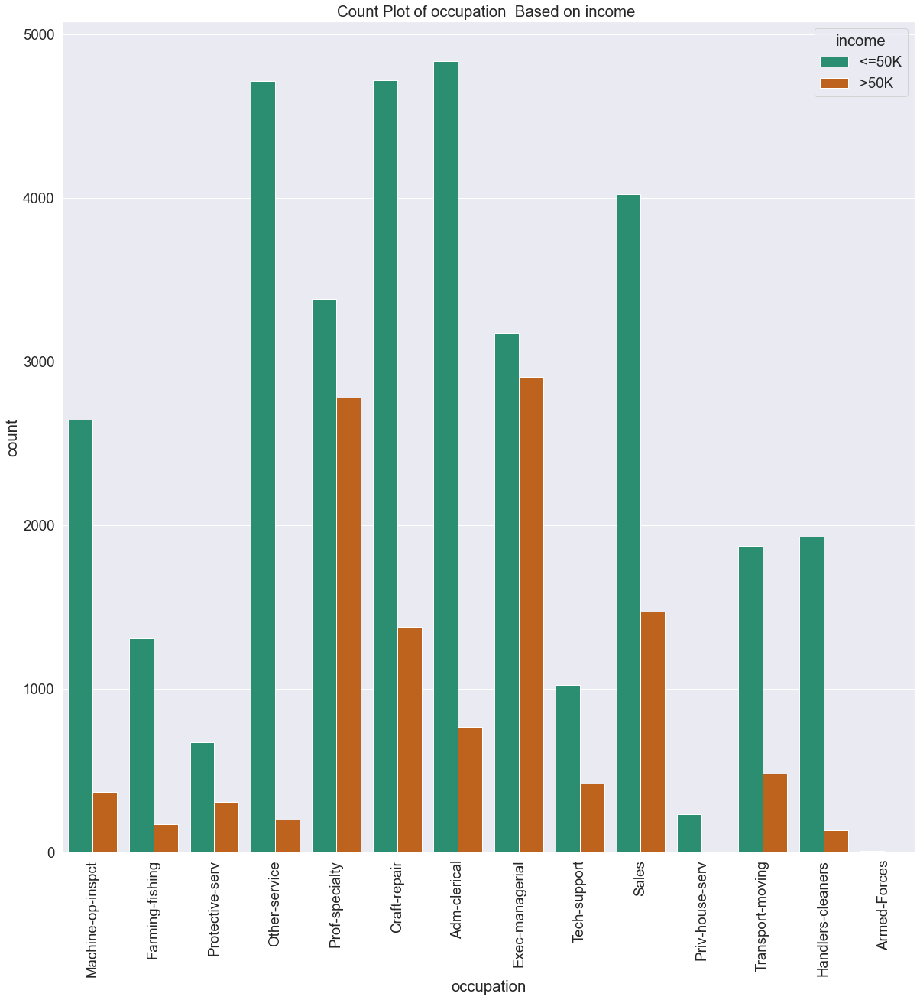

In [95]:
sns.countplot( x = "occupation"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of occupation  Based on income ")
plt.xticks(rotation = 90)

Text(0.5, 1.0, 'Count Plot of relationship  Based on income ')

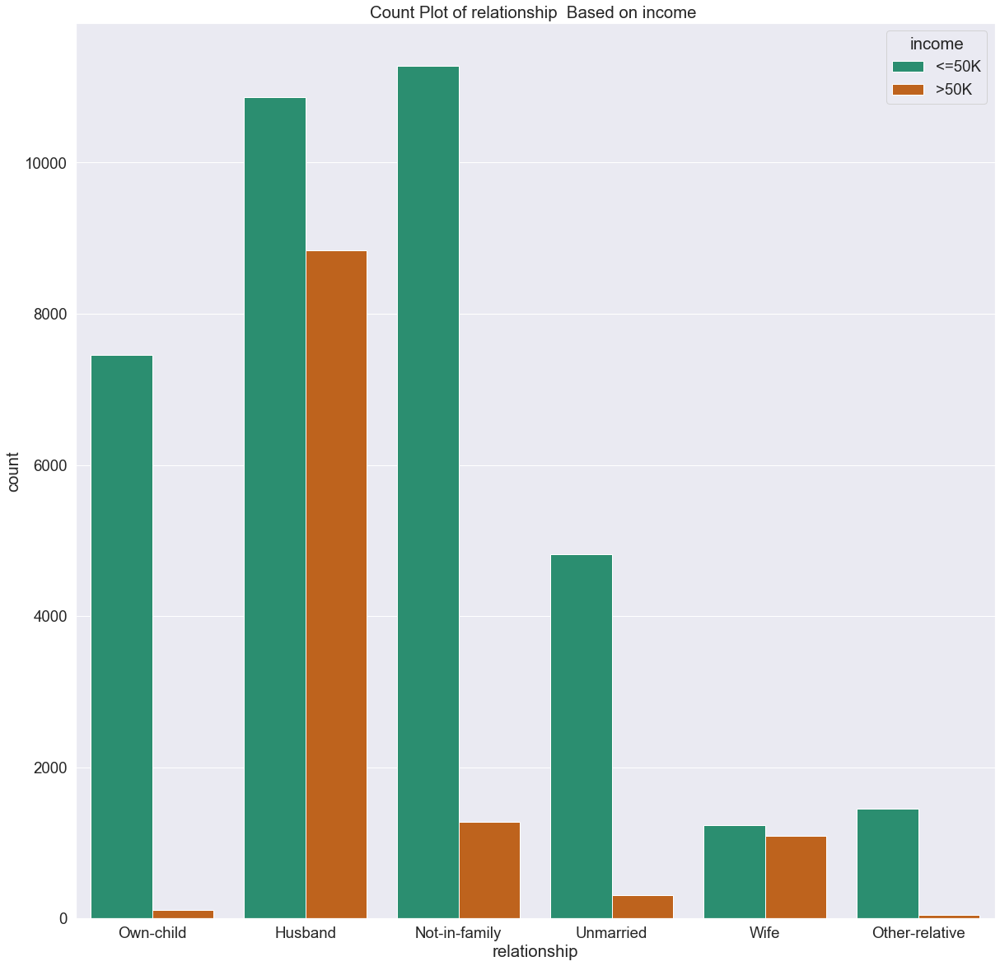

In [96]:
sns.countplot( x = "relationship"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of relationship  Based on income ")

Text(0.5, 1.0, 'Count Plot of race  Based on income ')

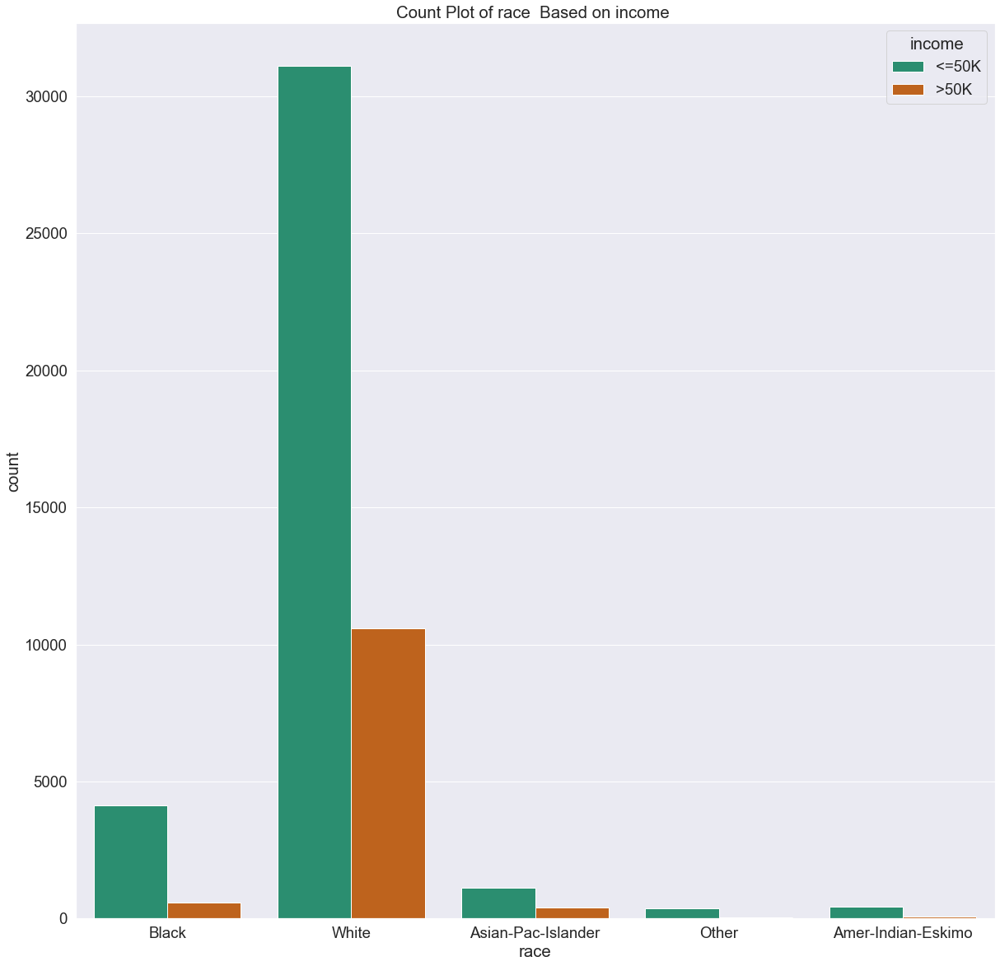

In [97]:
sns.countplot( x = "race"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of race  Based on income ")

Text(0.5, 1.0, 'Count Plot of gender  Based on income ')

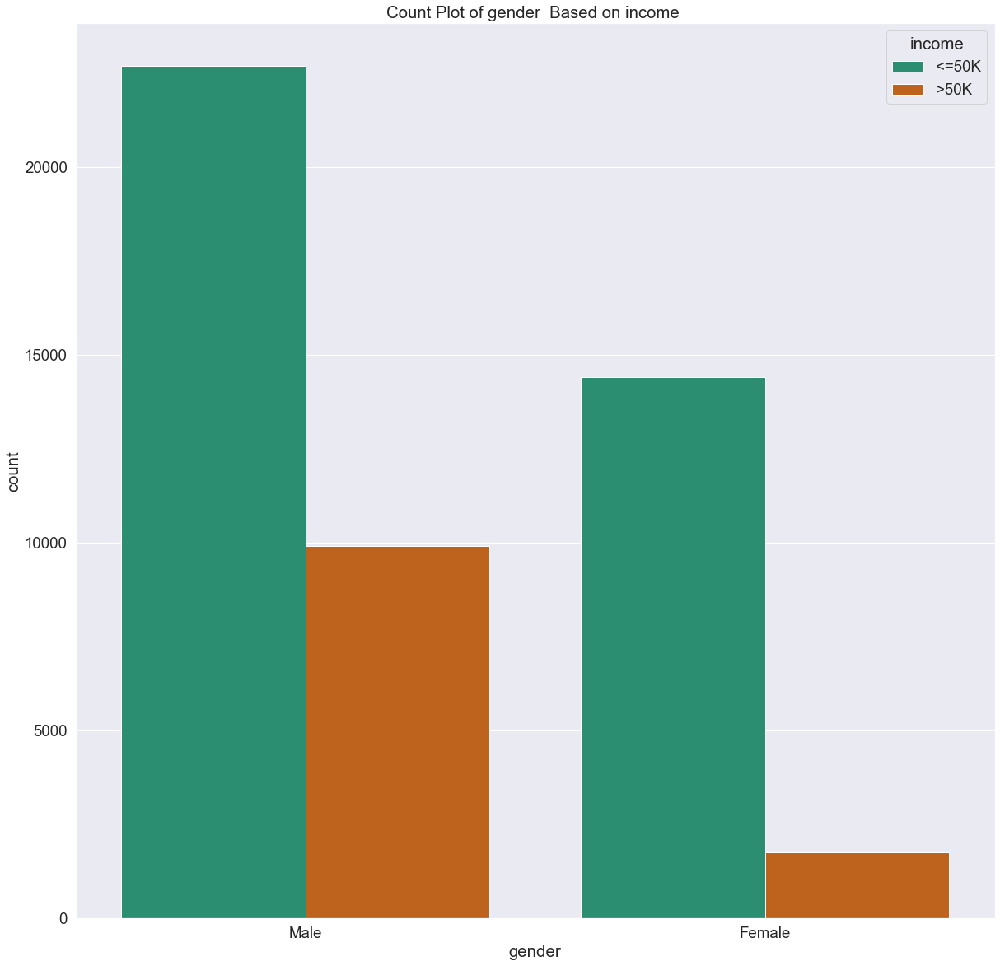

In [98]:
sns.countplot( x = "gender"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of gender  Based on income ")

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40]),
 [Text(0, 0, 'United-States'),
  Text(1, 0, 'Peru'),
  Text(2, 0, 'Guatemala'),
  Text(3, 0, 'Mexico'),
  Text(4, 0, 'Dominican-Republic'),
  Text(5, 0, 'Ireland'),
  Text(6, 0, 'Germany'),
  Text(7, 0, 'Philippines'),
  Text(8, 0, 'Thailand'),
  Text(9, 0, 'Haiti'),
  Text(10, 0, 'El-Salvador'),
  Text(11, 0, 'Puerto-Rico'),
  Text(12, 0, 'Vietnam'),
  Text(13, 0, 'South'),
  Text(14, 0, 'Columbia'),
  Text(15, 0, 'Japan'),
  Text(16, 0, 'India'),
  Text(17, 0, 'Cambodia'),
  Text(18, 0, 'Poland'),
  Text(19, 0, 'Laos'),
  Text(20, 0, 'England'),
  Text(21, 0, 'Cuba'),
  Text(22, 0, 'Taiwan'),
  Text(23, 0, 'Italy'),
  Text(24, 0, 'Canada'),
  Text(25, 0, 'Portugal'),
  Text(26, 0, 'China'),
  Text(27, 0, 'Nicaragua'),
  Text(28, 0, 'Honduras'),
  Text(29, 0, 'Iran'),
  Text(30, 0, 'Scotland'),
  T

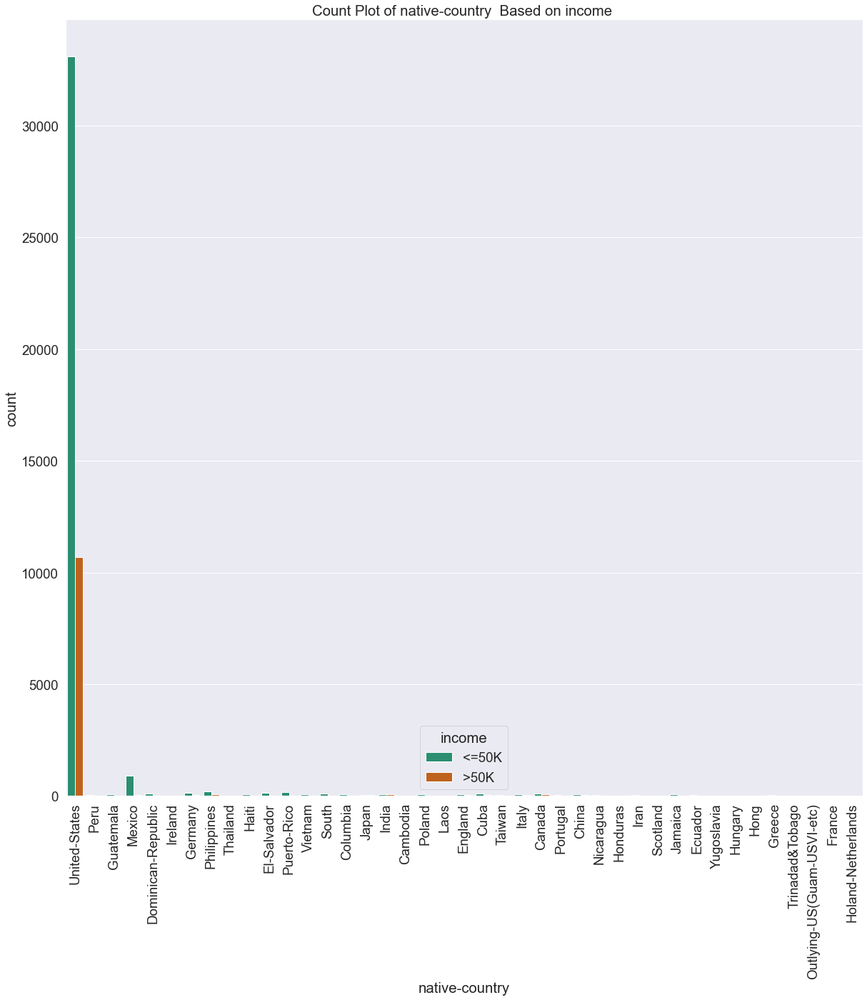

In [99]:
sns.countplot( x = "native-country"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of native-country  Based on income ")
plt.xticks(rotation = 90)

Text(0.5, 1.0, 'Count Plot of income  Based on income ')

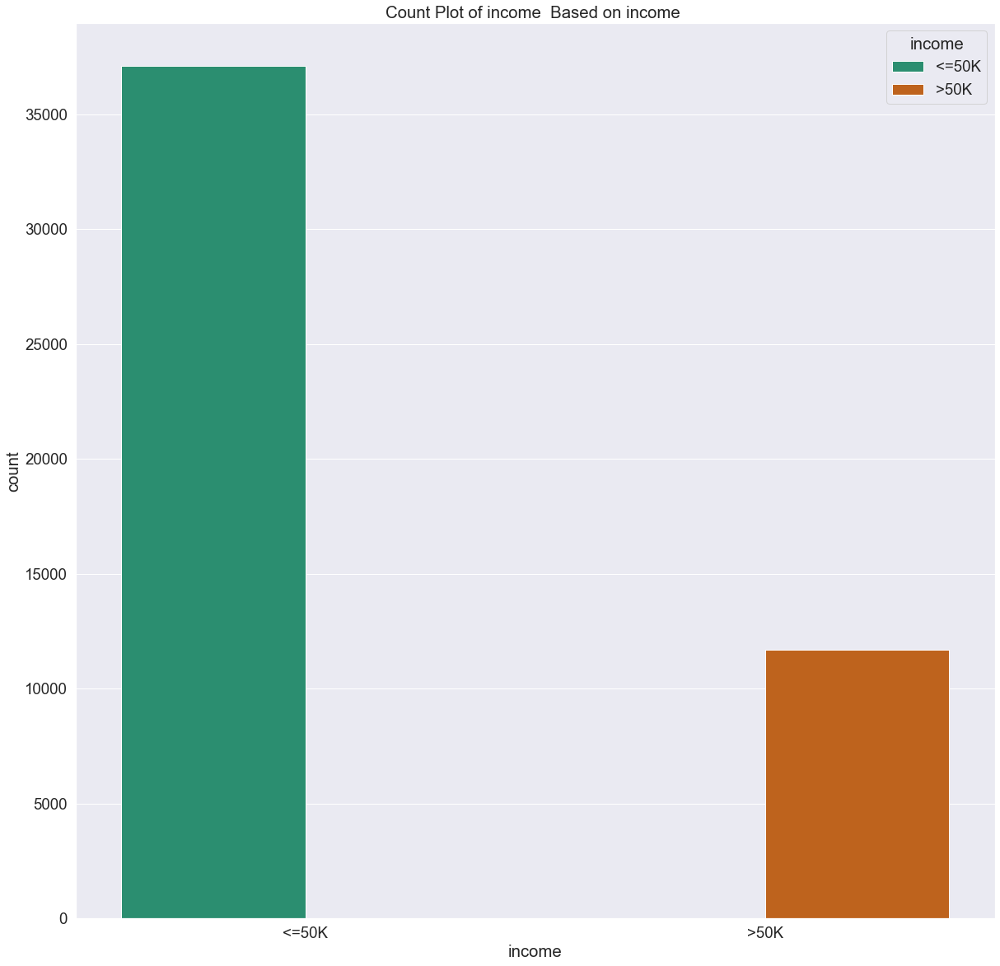

In [100]:
sns.countplot( x = "income"  , data = df ,hue="income" , palette="Dark2")
plt.title("Count Plot of income  Based on income ")

In [101]:
# get describtion file of data ::

profile = pp.ProfileReport(df , title = "Person_Income_Report" , explorative=True)
profile.to_widgets()

Summarize dataset:   0%|          | 0/29 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [102]:
# To save report as html file
profile.to_file("Person_Income_Data_Report.html")


Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

<p id = "ETl">ETL-Process</p>

# 1 - Feature_Engineering Technice ::
*********************************************************************
* Its one of the most important phase in data scientist life cycle which use to generate new usefull features from the old  features which not enough for train model.

In [103]:
df

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,160323,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,18,NaN,103497,Some-college,10,Never-married,NaN,Own-child,White,Female,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
48838,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
48839,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
48840,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


# 2 - Transform_data ::
*************************************************
* 2 :: *Cleancing data* ::
     * Data in the real state dont comes cleaned is come dirty may include ::
         * non_logic_data_values.
         * Noisy and Errors.
         * Duplicaties data.
         * Missing_data_Values.

# non_logic_Values ::
***********************************
* Its one of the common issuse which consider us on data which data may include errors , noisy data such as :
    * Negaive values and that not logic.
    * Fraction Values and that not logic also.

In [104]:
# Check data include Non_logic data_Values ::

for col in df.columns :
    print(f"The Col ({col})\n")
    print(f"The Unique Values of ({col}) :: {df[col].unique()}\n\n")
    print(f"The Value_Counts of ({col}) :: \n{df[col].value_counts()}")
    print("-" * 80)

The Col (age)

The Unique Values of (age) :: [25 38 28 44 18 34 29 63 24 55 65 36 26 58 48 43 20 37 40 72 45 22 23 54
 32 46 56 17 39 52 21 42 33 30 47 41 19 69 50 31 59 49 51 27 57 61 64 79
 73 53 77 80 62 35 68 66 75 60 67 71 70 90 81 74 78 82 83 85 76 84 89 88
 87 86]


The Value_Counts of (age) :: 
36    1348
35    1336
33    1335
23    1325
31    1324
      ... 
88       6
85       5
87       3
89       2
86       1
Name: age, Length: 74, dtype: int64
--------------------------------------------------------------------------------
The Col (workclass)

The Unique Values of (workclass) :: ['Private' 'Local-gov' nan 'Self-emp-not-inc' 'Federal-gov' 'State-gov'
 'Self-emp-inc' 'Without-pay' 'Never-worked']


The Value_Counts of (workclass) :: 
Private             33860
Self-emp-not-inc     3861
Local-gov            3136
State-gov            1981
Self-emp-inc         1694
Federal-gov          1432
Without-pay            21
Never-worked           10
Name: workclass, dtype: int64
-------

# Dublicates data ::
***************************
* Its also one of the most common issue which may found reapat or redendant data that generate from :
    * Miss understanding from data entry person.
    * There are two cols have diff names but present the same entity.

In [105]:
# detect duplicated data ::

df.duplicated().sum()

0

In [106]:
# To confirm that ::
df.drop_duplicates(inplace=True)

In [ ]:
# investigate data not include duplicaties records ::

df.duplicated().sum()

# Missing Dtat Values ::
**********************************
* Its The Most common issue which consider us on data that generate from ::
    * Miss understanding from data entry person.
    * Falier the impute system.
* We must identify that missing data and impute it, we will solve that issue by ::
    * Fill Missing values use :
        * Mean value if data not include outliers.
        * Median value if data include outliers.
        * Mode value if that categorical data.
    * Or Impute data use :;
        * Simpleimputer ML Technice.
        * KNN ML Model.

In [107]:
# detect missing data values ::

df.isnull().sum()

age                   0
workclass          2795
fnlwgt                0
education             0
educational-num       0
marital-status        0
occupation         2805
relationship          0
race                  0
gender                0
capital-gain          0
capital-loss          0
hours-per-week        0
native-country      856
income                0
dtype: int64

In [108]:
Num_Missing     = df.isnull().sum().sort_values(ascending = False)
Precent_Missing = ( df.isnull().sum() / df.isnull().count() ).sort_values(ascending = False)
Missing_Data    = pd.concat( [ Num_Missing , Precent_Missing ] ,axis=1 , keys = ["Num_Missing" , "Prec_Missing"])
Missing_Data

,Num_Missing,Prec_Missing
occupation,2805,0.057491
workclass,2795,0.057286
native-country,856,0.017545
age,0,0.000000
fnlwgt,0,0.000000
education,0,0.000000
educational-num,0,0.000000
marital-status,0,0.000000
relationship,0,0.000000
race,0,0.000000


In [111]:
Missing_feats = ["native-country" , "occupation" , "workclass"]

for col in Missing_feats :
    df[col].fillna(df[col].mode()[0] , inplace = True)

In [112]:
# investigate data not include Missing data

Num_Missing     = df.isnull().sum().sort_values(ascending = False)
Precent_Missing = ( df.isnull().sum() / df.isnull().count() ).sort_values(ascending = False)
Missing_Data    = pd.concat( [ Num_Missing , Precent_Missing ] ,axis=1 , keys = ["Num_Missing" , "Prec_Missing"])
Missing_Data

,Num_Missing,Prec_Missing
age,0,0.0
workclass,0,0.0
fnlwgt,0,0.0
education,0,0.0
educational-num,0,0.0
marital-status,0,0.0
occupation,0,0.0
relationship,0,0.0
race,0,0.0
gender,0,0.0


* 3 :: *Data_Preprocessing* ::
    * Data may include ::
        * Outliers values.
        * Impalanced classes.
        * Text data.

# Outliers Values ::
**********************************
* Its one of the most common issuse which conseder us on data But we must investigate that value already outliers or anominal data values Based on ::
    * Understanding the domain of the Business well.
    * If num of ouliers values few that mean may that values outlier.
    * If num of outliers values hue that mean may that values not outliers.
* If that data outlier we will replace it by mean value or drop it.

In [113]:
df.columns

Index(['age', 'workclass', 'fnlwgt', 'education', 'educational-num',
       'marital-status', 'occupation', 'relationship', 'race', 'gender',
       'capital-gain', 'capital-loss', 'hours-per-week', 'native-country',
       'income'],
      dtype='object')

<AxesSubplot:ylabel='age'>

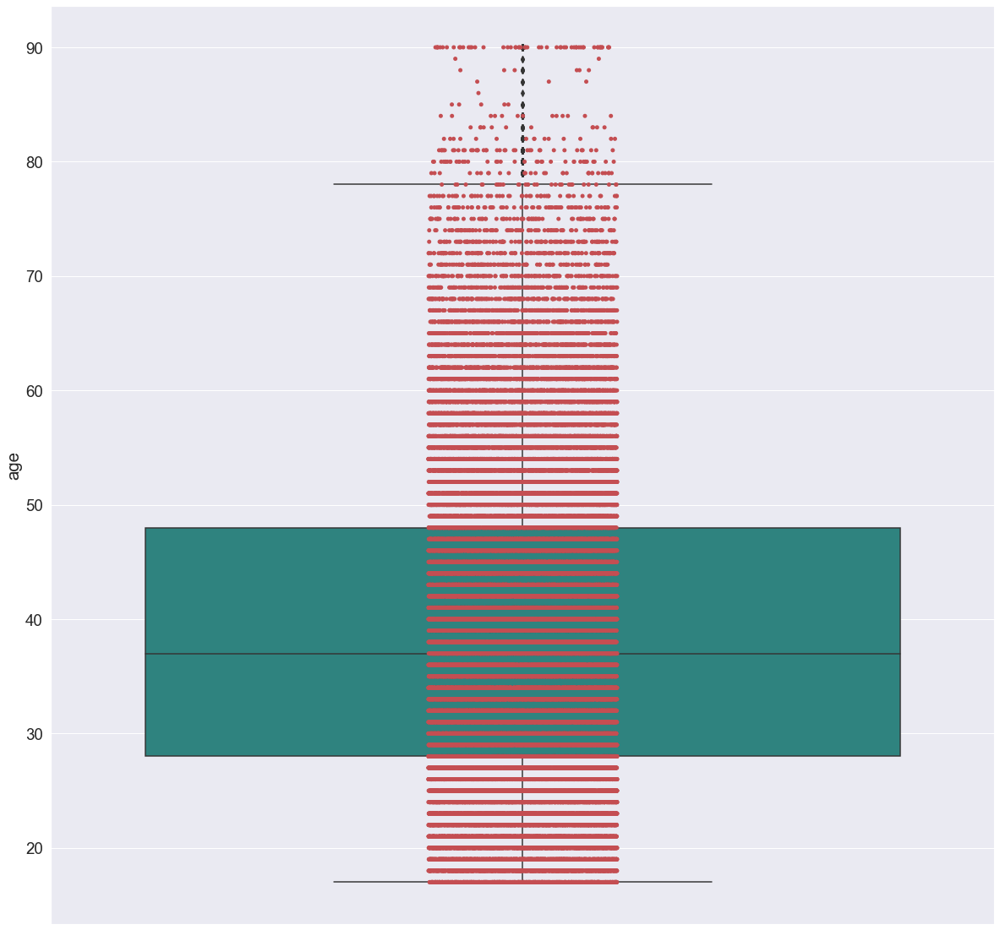

In [114]:
# detect outliers values in culmen_length_mm feature ::

sns.boxplot  (y = "age" , data = df , palette="viridis")
sns.stripplot(y = "age" , data = df , color = "r")

<AxesSubplot:ylabel='educational-num'>

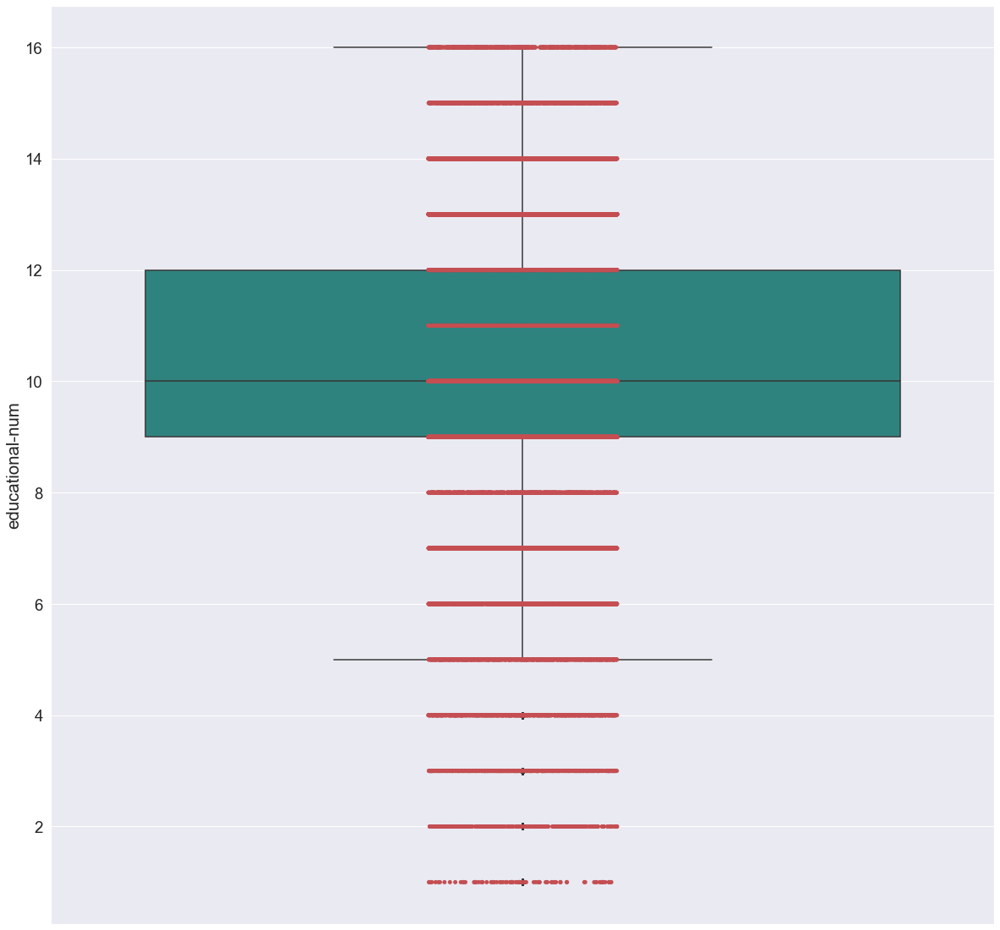

In [115]:
# detect outliers values in culmen_length_mm feature ::

sns.boxplot  (y = "educational-num" , data = df , palette="viridis")
sns.stripplot(y = "educational-num" , data = df , color = "r")

<AxesSubplot:ylabel='capital-gain'>

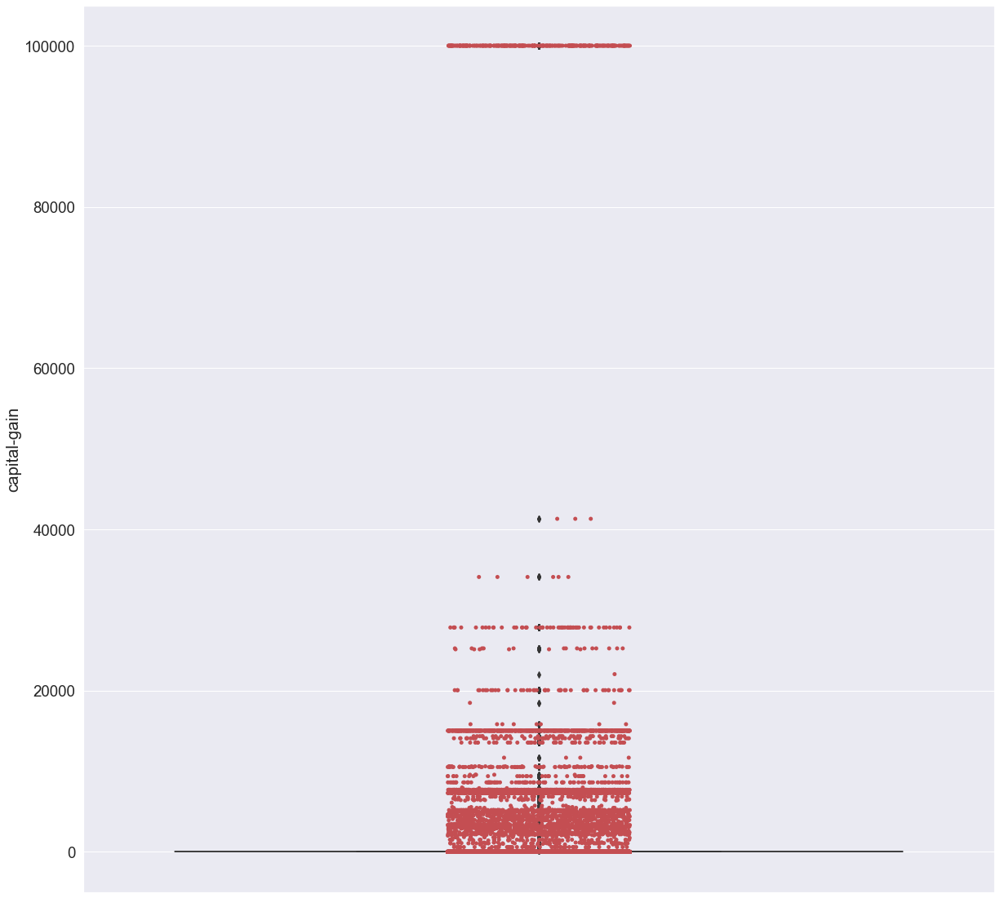

In [116]:
# detect outliers values in culmen_length_mm feature ::

sns.boxplot  (y = "capital-gain" , data = df , palette="viridis")
sns.stripplot(y = "capital-gain" , data = df , color = "r")

<AxesSubplot:ylabel='capital-loss'>

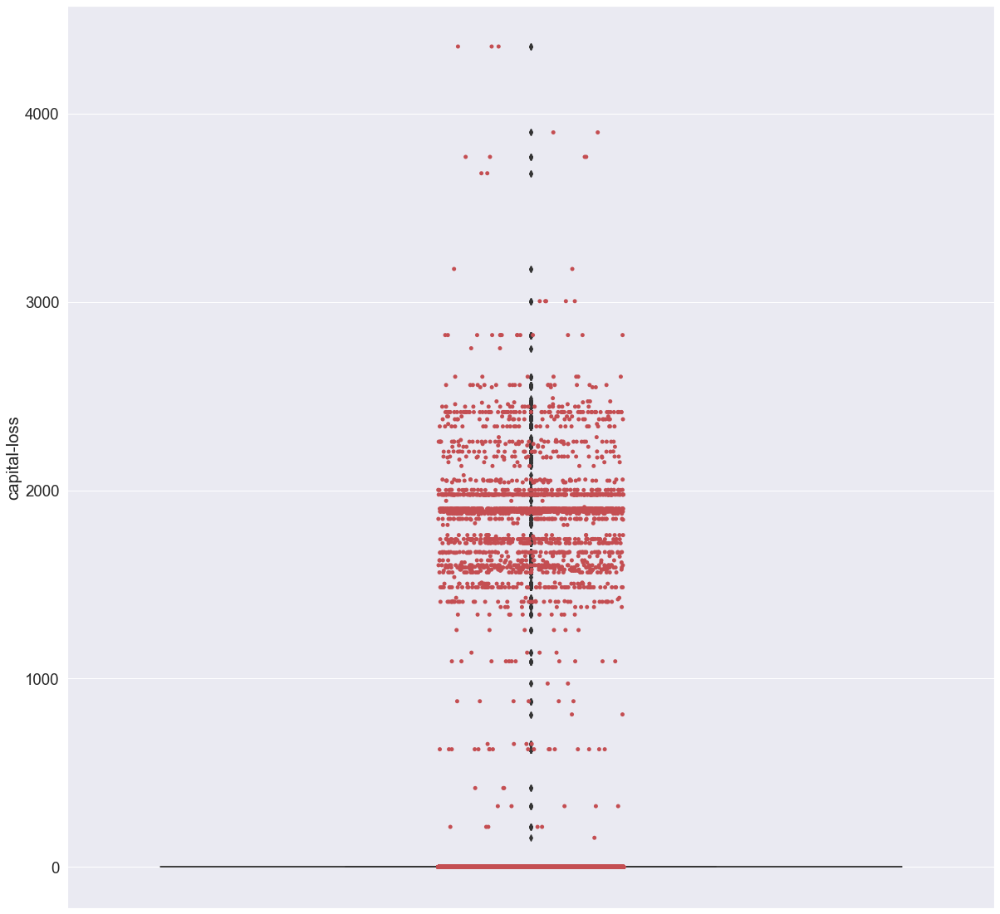

In [117]:
# detect outliers values in culmen_length_mm feature ::

sns.boxplot  (y = "capital-loss" , data = df , palette="viridis")
sns.stripplot(y = "capital-loss" , data = df , color = "r")

<AxesSubplot:ylabel='hours-per-week'>

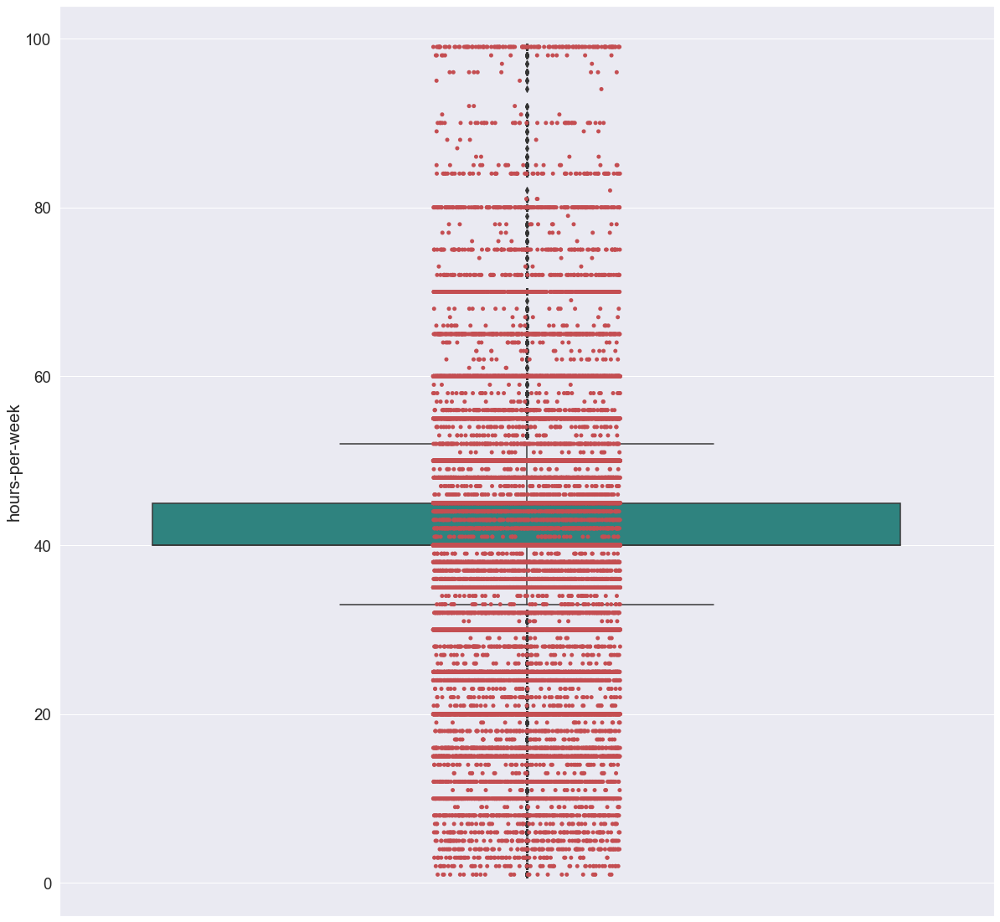

In [118]:
# detect outliers values in culmen_length_mm feature ::

sns.boxplot  (y = "hours-per-week" , data = df , palette="viridis")
sns.stripplot(y = "hours-per-week" , data = df , color = "r")

# Processing Text data ::
**********************************************
* We must handling test data into numerical numbers becouse ML Models not understanding that text data so that we use one_hot_encoding or one_variable_encoding technices.


In [119]:
df

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,160323,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,18,Private,103497,Some-college,10,Never-married,Prof-specialty,Own-child,White,Female,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
48838,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
48839,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
48840,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


In [120]:
#Convertin the predictor variable in a binary numeric variable
df['income'].replace(to_replace='>50K', value=1, inplace=True)
df['income'].replace(to_replace='<=50K',  value=0, inplace=True)

In [121]:
df

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,0
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,0
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,1
3,44,Private,160323,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,1
4,18,Private,103497,Some-college,10,Never-married,Prof-specialty,Own-child,White,Female,0,0,30,United-States,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,0
48838,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,1
48839,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,0
48840,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,0


In [122]:
# creating dummy variables for categorical features
df = pd.get_dummies(df,drop_first=True)

In [123]:
df

,age,fnlwgt,educational-num,capital-gain,capital-loss,hours-per-week,income,workclass_Local-gov,workclass_Never-worked,workclass_Private,...,native-country_Portugal,native-country_Puerto-Rico,native-country_Scotland,native-country_South,native-country_Taiwan,native-country_Thailand,native-country_Trinadad&Tobago,native-country_United-States,native-country_Vietnam,native-country_Yugoslavia
0,25,226802,7,0,0,40,0,0,0,1,...,0,0,0,0,0,0,0,1,0,0
1,38,89814,9,0,0,50,0,0,0,1,...,0,0,0,0,0,0,0,1,0,0
2,28,336951,12,0,0,40,1,1,0,0,...,0,0,0,0,0,0,0,1,0,0
3,44,160323,10,7688,0,40,1,0,0,1,...,0,0,0,0,0,0,0,1,0,0
4,18,103497,10,0,0,30,0,0,0,1,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,27,257302,12,0,0,38,0,0,0,1,...,0,0,0,0,0,0,0,1,0,0
48838,40,154374,9,0,0,40,1,0,0,1,...,0,0,0,0,0,0,0,1,0,0
48839,58,151910,9,0,0,40,0,0,0,1,...,0,0,0,0,0,0,0,1,0,0
48840,22,201490,9,0,0,20,0,0,0,1,...,0,0,0,0,0,0,0,1,0,0


In [126]:
# get correlation between all features ::
sns.set( rc = {"figure.figsize" : [150 , 100]} , font_scale=3.5)
corr = df.apply(lambda x: pd.factorize(x)[0]).corr()
ax = sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, 
                 linewidths=.2, cmap="YlGnBu", annot=True , linecolor="b")

<AxesSubplot:>

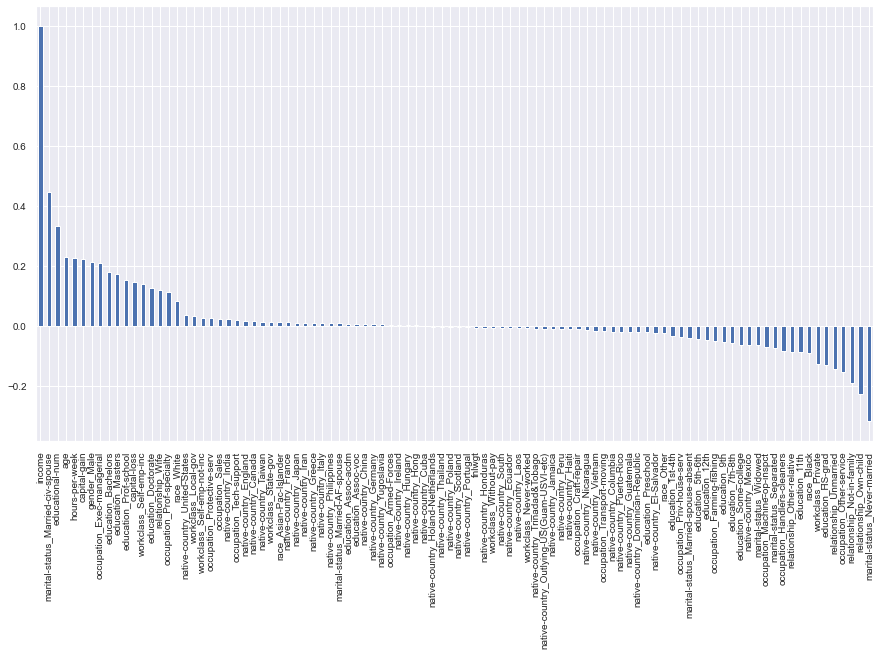

In [130]:
# Get Correlation of "Churn" with other features ::
sns.set( rc = {"figure.figsize" : [30 , 30]} , font_scale=0.9)

plt.figure(figsize=(15,8))
df.corr()['income'].sort_values(ascending = False).plot(kind='bar'  )

# 3 :: Feture selection ::
***************************************************
* There are multi technices to get the most Correlation Columns with our target.

In [131]:
df.drop(["fnlwgt"] , axis=1 , inplace=True)

<p id = "Prepration">Data-Prepration</p>

In [132]:
df.columns

Index(['age', 'educational-num', 'capital-gain', 'capital-loss',
       'hours-per-week', 'income', 'workclass_Local-gov',
       'workclass_Never-worked', 'workclass_Private', 'workclass_Self-emp-inc',
       'workclass_Self-emp-not-inc', 'workclass_State-gov',
       'workclass_Without-pay', 'education_11th', 'education_12th',
       'education_1st-4th', 'education_5th-6th', 'education_7th-8th',
       'education_9th', 'education_Assoc-acdm', 'education_Assoc-voc',
       'education_Bachelors', 'education_Doctorate', 'education_HS-grad',
       'education_Masters', 'education_Preschool', 'education_Prof-school',
       'education_Some-college', 'marital-status_Married-AF-spouse',
       'marital-status_Married-civ-spouse',
       'marital-status_Married-spouse-absent', 'marital-status_Never-married',
       'marital-status_Separated', 'marital-status_Widowed',
       'occupation_Armed-Forces', 'occupation_Craft-repair',
       'occupation_Exec-managerial', 'occupation_Farming-fishing

In [133]:
# Split data into input and output data
x = df.drop("income" , axis=1 )
y = df["income"]

In [134]:
# Spliting data into Training and Testing data ::
from sklearn.model_selection import train_test_split
x_train , x_test , y_train , y_test = train_test_split( x , y , random_state = 20 , test_size=0.2)

In [135]:
#Scalling data ::
from sklearn.preprocessing import StandardScaler
scaller = StandardScaler()
x_train = scaller.fit_transform(x_train)
x_test  = scaller.transform(x_test)

In [136]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 48790 entries, 0 to 48841
Data columns (total 97 columns):
 #   Column                                     Non-Null Count  Dtype
---  ------                                     --------------  -----
 0   age                                        48790 non-null  int64
 1   educational-num                            48790 non-null  int64
 2   capital-gain                               48790 non-null  int64
 3   capital-loss                               48790 non-null  int64
 4   hours-per-week                             48790 non-null  int64
 5   income                                     48790 non-null  int64
 6   workclass_Local-gov                        48790 non-null  uint8
 7   workclass_Never-worked                     48790 non-null  uint8
 8   workclass_Private                          48790 non-null  uint8
 9   workclass_Self-emp-inc                     48790 non-null  uint8
 10  workclass_Self-emp-not-inc                 487

<p id = "Model">Bulid_ML_Model</p>

# Build Models ::
*************************************
* On that Process we will ::
    * Bulid multi models fror classification problem.
    * Evaluate all models.
    * Select the most efficient model for churn problem.

In [137]:
# Import All Classification Algos ::
from sklearn.linear_model import LogisticRegression 
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB , MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score , confusion_matrix 
from sklearn.metrics import classification_report , f1_score , precision_recall_curve

In [138]:
Models = {"Log_Classifer" : LogisticRegression() ,
          "DT_Classifer"  : DecisionTreeClassifier() ,
          "RF_Classifer"  : RandomForestClassifier() ,
          "XGB_Classifer" : XGBClassifier() ,
          "SVC_Classifer" : SVC(),
          "GassianNB_Classifiier" : GaussianNB() ,
          "KNN_Classifier" : KNeighborsClassifier()
         }

In [139]:
for Name , Model in Models.items() :
    print(f"The Model :: {Name}\n----------")
    Model.fit(x_train , y_train)
    Train_score = Model.score(x_train , y_train)
    Test_score  = Model.score(x_test , y_test)
    y_pred = Model.predict(x_test)
    Acurace_Score = accuracy_score(y_test , y_pred)
    Con_Matrix = confusion_matrix(y_test , y_pred)
    print(f"The Traing_Score :: {Train_score}\nThe Testing_Score :: {Test_score}\nThe Accuracy_Scor :: {Acurace_Score}\nThe Con_Matrix ::\n {Con_Matrix}\n=================\n=================")

The Model :: Log_Classifer
----------
The Traing_Score :: 0.851890756302521
The Testing_Score :: 0.8516089362574298
The Accuracy_Scor :: 0.8516089362574298
The Con_Matrix ::
 [[6886  525]
 [ 923 1424]]
The Model :: DT_Classifer
----------
The Traing_Score :: 0.9732527157204345
The Testing_Score :: 0.8205574912891986
The Accuracy_Scor :: 0.8205574912891986
The Con_Matrix ::
 [[6556  855]
 [ 896 1451]]
The Model :: RF_Classifer
----------
The Traing_Score :: 0.9731502357040377
The Testing_Score :: 0.8507890961262554
The Accuracy_Scor :: 0.8507890961262554
The Con_Matrix ::
 [[6803  608]
 [ 848 1499]]
The Model :: XGB_Classifer
----------
[20:28:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
The Traing_Score :: 0.8890141422422627
The Tes

* Select most efficient model with high Performance and accuracy

In [140]:
RF_Model = RandomForestClassifier(criterion="entropy" , random_state =20 ,oob_score = True, n_estimators=1000 , max_depth=100, n_jobs=-1 )
RF_Model.fit(x_train , y_train)
print(RF_Model.score(x_train , y_train))
print(RF_Model.score(x_test , y_test))
print("-" * 80)

0.9732527157204345
0.850994056159049
--------------------------------------------------------------------------------


<p id = "Evaluation">Evaluate_Model</p>

# Evaluate Model ::
*********************************
* Its one off the most important phase in data scientist life cycle which estimate the performance and accuracy of the model in that problem.

In [141]:
RF_Model.score(x_train , y_train)

0.9732527157204345

In [142]:
RF_Model.score(x_test , y_test)

0.850994056159049

In [143]:
Ac_Sore_RF = accuracy_score(y_test , y_pred)
Ac_Sore_RF

0.8278335724533716

In [144]:
con_Matrix = confusion_matrix(y_test , y_pred)
con_Matrix

array([[6685,  726],
       [ 954, 1393]], dtype=int64)

<AxesSubplot:>

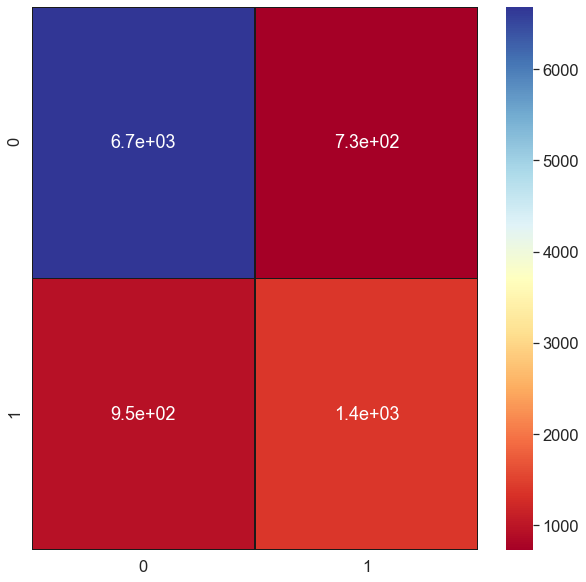

In [145]:
sns.set( rc = {"figure.figsize" : [10 , 10]} , font_scale=1.5)

sns.heatmap(con_Matrix , annot = True , cmap="RdYlBu" , linecolor = 'k' , linewidths= 1)

<p id = "Save">Save_Model</p>

# Save techinces ::
***************************************
* Save Scaler
* Save PCA
* Save Model

In [146]:
import joblib

In [147]:
scaler = joblib.dump(scaller , "scaler.h5")

In [148]:
Model = joblib.dump(RF_Model , "Model.h5")

<p id = "conclusions">conclusions</p>

# Conclusion ::
*****************************
* On that Step We will ::
  * Input data features.
  * Scaling input data.
  * Predict income label.

In [149]:
df.head(2)

,age,educational-num,capital-gain,capital-loss,hours-per-week,income,workclass_Local-gov,workclass_Never-worked,workclass_Private,workclass_Self-emp-inc,...,native-country_Portugal,native-country_Puerto-Rico,native-country_Scotland,native-country_South,native-country_Taiwan,native-country_Thailand,native-country_Trinadad&Tobago,native-country_United-States,native-country_Vietnam,native-country_Yugoslavia
0,25,7,0,0,40,0,0,0,1,0,...,0,0,0,0,0,0,0,1,0,0
1,38,9,0,0,50,0,0,0,1,0,...,0,0,0,0,0,0,0,1,0,0


In [150]:
x.columns

Index(['age', 'educational-num', 'capital-gain', 'capital-loss',
       'hours-per-week', 'workclass_Local-gov', 'workclass_Never-worked',
       'workclass_Private', 'workclass_Self-emp-inc',
       'workclass_Self-emp-not-inc', 'workclass_State-gov',
       'workclass_Without-pay', 'education_11th', 'education_12th',
       'education_1st-4th', 'education_5th-6th', 'education_7th-8th',
       'education_9th', 'education_Assoc-acdm', 'education_Assoc-voc',
       'education_Bachelors', 'education_Doctorate', 'education_HS-grad',
       'education_Masters', 'education_Preschool', 'education_Prof-school',
       'education_Some-college', 'marital-status_Married-AF-spouse',
       'marital-status_Married-civ-spouse',
       'marital-status_Married-spouse-absent', 'marital-status_Never-married',
       'marital-status_Separated', 'marital-status_Widowed',
       'occupation_Armed-Forces', 'occupation_Craft-repair',
       'occupation_Exec-managerial', 'occupation_Farming-fishing',
       

In [153]:
len(x.columns)

96

In [162]:
custom_data = np.array([ 25,7,0,0,40, 0,1,0,0,0,0,0,   0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,
                        1,0,0,0,0,0,  1,0,0,0,0,0,0,0,0,0,0,0,0, 1,0,0,0,0 , 1,0,0,0 ,
                        1 ,  0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0])

In [163]:
custom_data.shape

(96,)

In [164]:
len(custom_data)

96

In [165]:
custom_data = scaller.transform([custom_data])
custom_data

array([[-9.95862867e-01, -1.19271923e+00, -1.44377865e-01,
        -2.17442314e-01, -3.18781913e-02, -2.61932553e-01,
         7.46659226e+01, -1.74480593e+00, -1.89930462e-01,
        -2.90884665e-01, -2.06139572e-01, -2.20684650e-02,
        -1.97896340e-01, -1.18554771e-01, -7.28403938e-02,
        -1.01110638e-01, -1.42423312e-01, -1.26001273e-01,
        -1.84728528e-01, -2.10889016e-01, -4.43275495e-01,
        -1.10756109e-01, -6.90228679e-01, -2.38695908e-01,
        -4.14667560e-02, -1.31552607e-01, -5.33580407e-01,
         3.49106001e+01, -9.20784222e-01, -1.14718288e-01,
        -6.99755156e-01, -1.79472261e-01, -1.78404808e-01,
         5.95597485e+01, -3.80395280e-01, -3.77698823e-01,
        -1.75012825e-01, -2.11220131e-01, -2.54253006e-01,
        -3.35454808e-01, -6.93830266e-02, -4.72957449e-01,
        -1.42048341e-01, -3.56897264e-01, -1.75090557e-01,
        -2.26330343e-01,  1.70250456e+00, -1.78328347e-01,
        -4.29128707e-01, -3.43200930e-01, -2.22425279e-0

In [166]:
prediction = RF_Model.predict(custom_data)
prediction

array([0], dtype=int64)